## DATA PREP


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits import mplot3d


In [ ]:
inFile = open("ENS491_data(new).txt")

event_nums_list=[]
cloud_num_list=[]
x_pos_list=[]
y_pos_list=[]
z_pos_list=[]
energy_list=[]

a = inFile.readline()

for line in inFile:
  elements = line.split("\t")
  event_nums_list.append(float(elements[0]))
  cloud_num_list.append(float(elements[1]))
  x_pos_list.append(float(elements[2]))
  y_pos_list.append(float(elements[3]))
  z_pos_list.append(float(elements[4]))
  energy_list.append(float(elements[5][:-1]))

In [ ]:
len(event_nums_list)

361173

In [ ]:
event_nums_list[-1]

14326.0

In [ ]:
counter = 0

for i in cloud_num_list:
  if i == 0:
    counter+=1

print(counter)

13518


In [ ]:
len(cloud_num_list)

361173

In [ ]:
len(energy_list)

361173

In [ ]:
first_event_list=[]
first_xpos_list=[]
first_ypos_list=[]
first_zpos_list=[]
first_energy_list=[]


for i in range(len(cloud_num_list)):
  if cloud_num_list[i] == 1:

    first_event_list.append(event_nums_list[i])
    first_xpos_list.append(x_pos_list[i])
    first_ypos_list.append(y_pos_list[i])
    first_energy_list.append(energy_list[i])
    first_zpos_list.append(z_pos_list[i])

    

In [58]:
mean_event_list=[]
mean_xpos_list=[]
mean_ypos_list=[]
mean_zpos_list=[]
mean_energy_list=[]

mean_event_list_1=[]
mean_xpos_list_1=[]
mean_ypos_list_1=[]
mean_zpos_list_1=[]
mean_energy_list_1=[]

mean_xpos=[]
mean_ypos=[]
mean_zpos=[]
mean_energy=[]

temp_x=[]
temp_y=[]
temp_z=[]
temp_eng=[]


prev_event_num=1

for i in range(len(event_nums_list)):
  if event_nums_list[i] != prev_event_num:

    mult_x = [mean_xpos[j]*mean_energy[j] for j in range(len(mean_energy))]
    mult_y = [mean_ypos[j]*mean_energy[j] for j in range(len(mean_energy))]
    mult_z = [mean_zpos[j]*mean_energy[j] for j in range(len(mean_energy))]

    temp_x.append(mean_xpos)
    temp_x.append(sum(mult_x)/sum(mean_energy))

    temp_y.append(mean_ypos)
    temp_y.append(sum(mult_y)/sum(mean_energy))

    temp_z.append(mean_zpos)
    temp_z.append(sum(mult_z)/sum(mean_energy))

    temp_eng.append(mean_energy)
    temp_eng.append(sum(mean_energy)/len(mean_energy))


    mean_xpos_list.append(temp_x)
    mean_ypos_list.append(temp_y)
    mean_zpos_list.append(temp_z)
    mean_energy_list.append(temp_eng)

        
    mean_xpos_list_1.append(mean_xpos)
    mean_ypos_list_1.append(mean_ypos)
    mean_zpos_list_1.append(mean_zpos)
    mean_energy_list_1.append(mean_energy)


    temp_x=[]
    temp_y=[]
    temp_z=[]
    temp_eng=[]

    
    mean_xpos=[]
    mean_ypos=[]
    mean_zpos=[]
    mean_energy=[]

    mean_xpos.append(x_pos_list[i])
    mean_ypos.append(y_pos_list[i])
    mean_zpos.append(z_pos_list[i])
    mean_energy.append(energy_list[i])


    prev_event_num +=1
    
  else:
    mean_xpos.append(x_pos_list[i])
    mean_ypos.append(y_pos_list[i])
    mean_zpos.append(z_pos_list[i])
    mean_energy.append(energy_list[i])





In [ ]:
mean_energy_list


In [ ]:
len(mean_xpos_list)

14325

In [ ]:
mean_xpos_list[50]

In [ ]:
len(mean_ypos_list)


14325

In [ ]:
a = [2,3,5]
b = [2,8,22]
ab = [a[i]*b[i] for i in range(len(a))]
print(ab)


[4, 24, 110]


In [ ]:
len(mean_event_list)

14325

## ONE EVENT GRAPHS

In [ ]:
event_n=0
temp_x=[]
temp_y=[]
temp_z=[]
temp_energy=[]

for i in range(len(event_nums_list)):

  if event_n > 100:
    break

  if cloud_num_list[i]==0:

    if event_n !=0:
      print( "event number=",event_n)
      print("With energy colored:")
      plt.rcParams["figure.figsize"] = [7.00, 3.50]
      plt.rcParams["figure.autolayout"] = True
      fig = plt.figure()
      ax = fig.add_subplot(111, projection='3d')
      img = ax.scatter(temp_x, temp_y, temp_z, c=temp_energy, cmap='gist_heat', alpha=1)
      plt.show()

      print("Without energy colored:")
      fig = plt.figure(figsize = (10, 7))
      ax = plt.axes(projection ="3d")

      ax.scatter3D(temp_x, temp_y, temp_z, color = "green")
      plt.title("X,Y and Z positions")
        

      plt.show()

    temp_x=[]
    temp_y=[]
    temp_z=[]
    temp_energy=[]

    temp_x.append(x_pos_list[i])
    temp_y.append(y_pos_list[i])
    temp_z.append(z_pos_list[i])
    temp_energy.append(energy_list[i])

    event_n+=1

  else:
    temp_x.append(x_pos_list[i])
    temp_y.append(y_pos_list[i])
    temp_z.append(z_pos_list[i])
    temp_energy.append(energy_list[i])

Output hidden; open in https://colab.research.google.com to view.

In [54]:
event_n=10000


for i in range(len(event_nums_list)):

  if event_n > 10100:
    break


  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(mean_xpos_list[i][0], mean_ypos_list[i][0], mean_zpos_list[i][0], color = "green")
  ax.scatter3D(mean_xpos_list[i][1], mean_ypos_list[i][1], mean_zpos_list[i][1], color = "red")
  title_name = "X,Y and Z positions for energy: " + str(sum(mean_energy_list[i][0])) + "and z pos: " + str(mean_zpos_list[i][1])
  plt.title(title_name)

  ax.set_xlim3d(0,25)
  ax.set_ylim3d(0,25)
  ax.set_zlim3d(0,5)
        

  plt.show()

  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(mean_xpos_list[i][0], mean_ypos_list[i][0], mean_zpos_list[i][0], color = "green")
  ax.scatter3D(mean_xpos_list[i][1], mean_ypos_list[i][1], mean_zpos_list[i][1], color = "red")
  #ax.scatter3D(mean_xpos_list[i], mean_ypos_list[i], mean_zpos_list[i], color = "red")
  title_name = "X,Y and Z positions for energy: " + str(sum(mean_energy_list[i][0])) + "and z pos: " + str(mean_zpos_list[i][1])
  plt.title(title_name)

        

  plt.show()

  event_n+=1



Output hidden; open in https://colab.research.google.com to view.

No handles with labels found to put in legend.


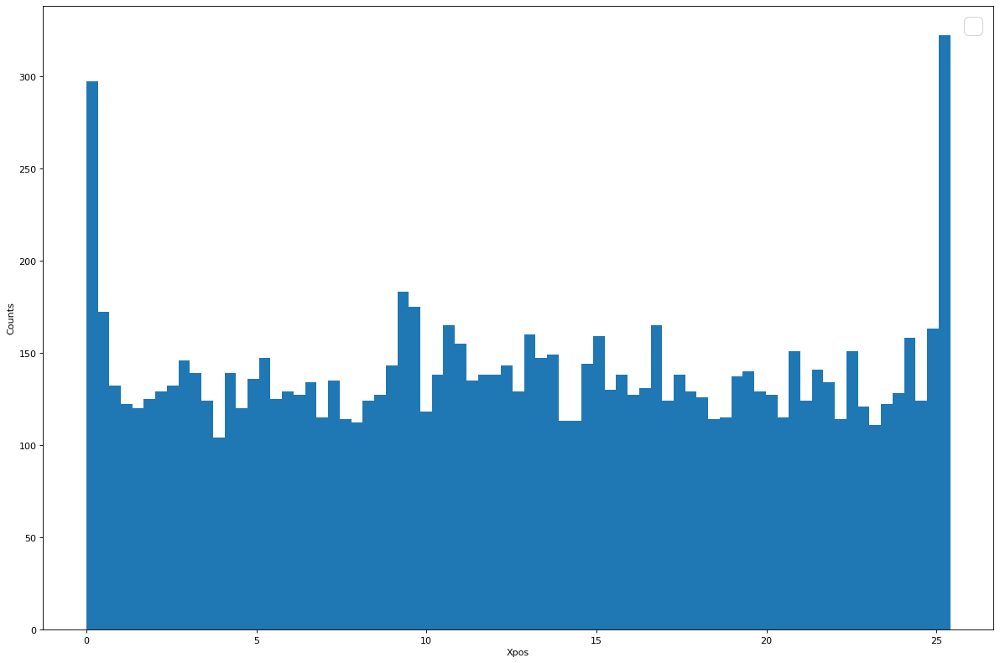

In [55]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(first_xpos_list,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


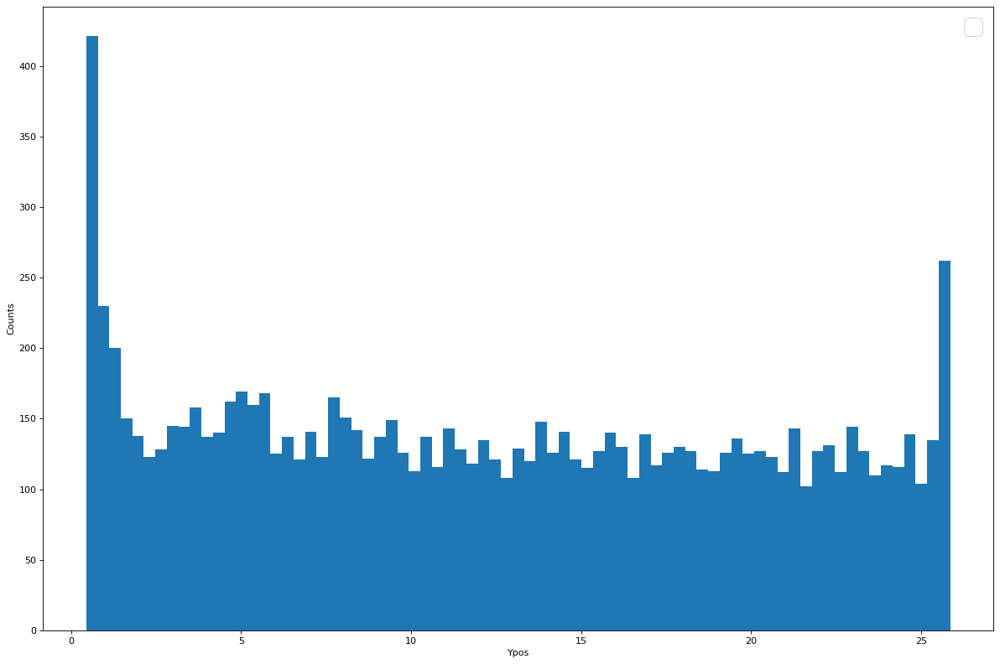

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(first_ypos_list,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


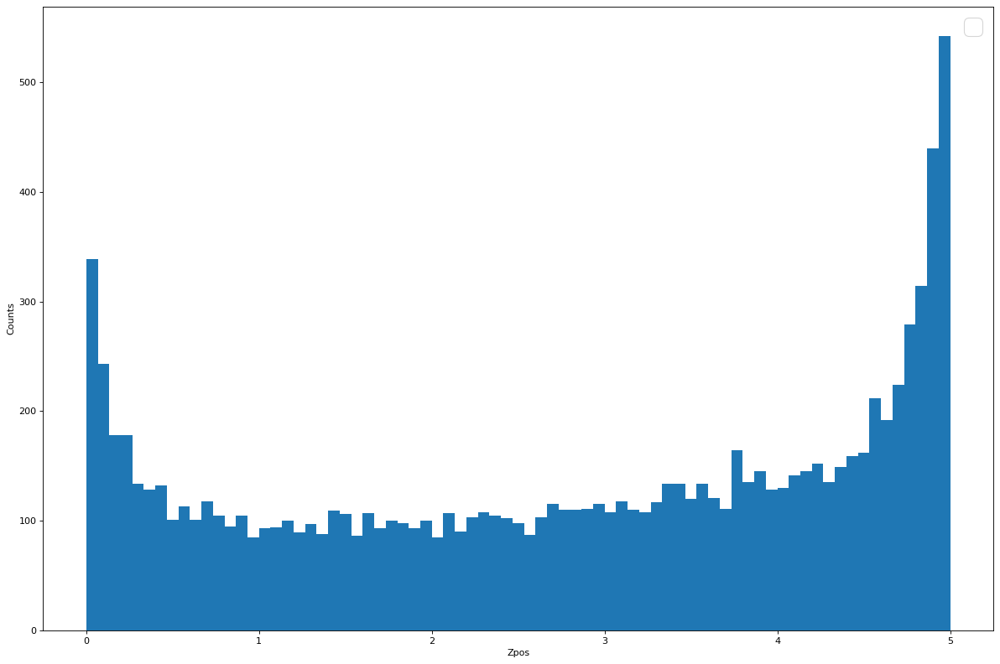

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(first_zpos_list,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


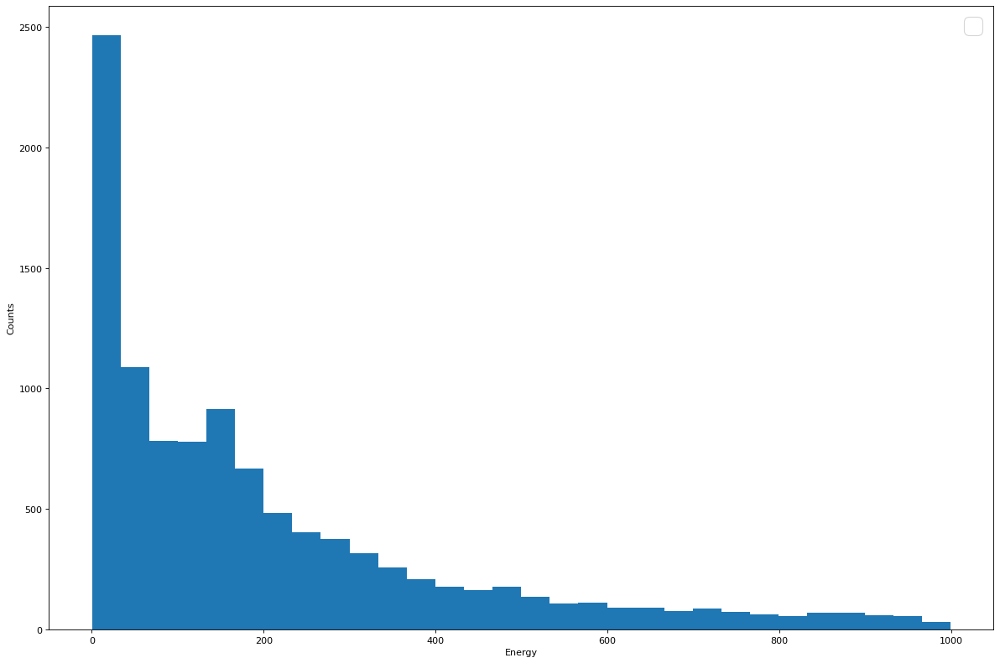

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(first_energy_list,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


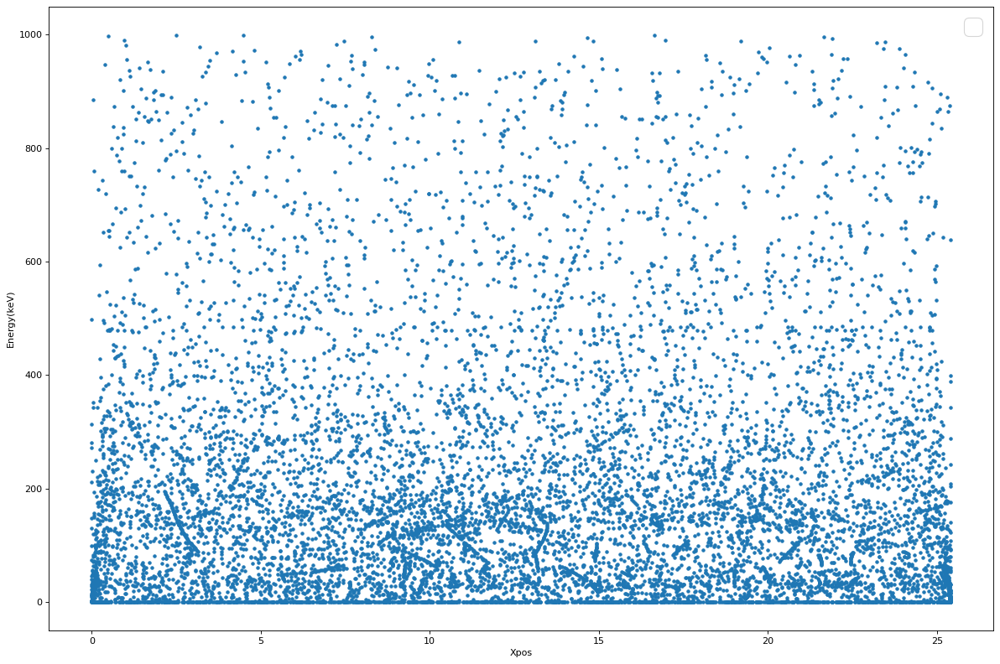

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(first_xpos_list, first_energy_list,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


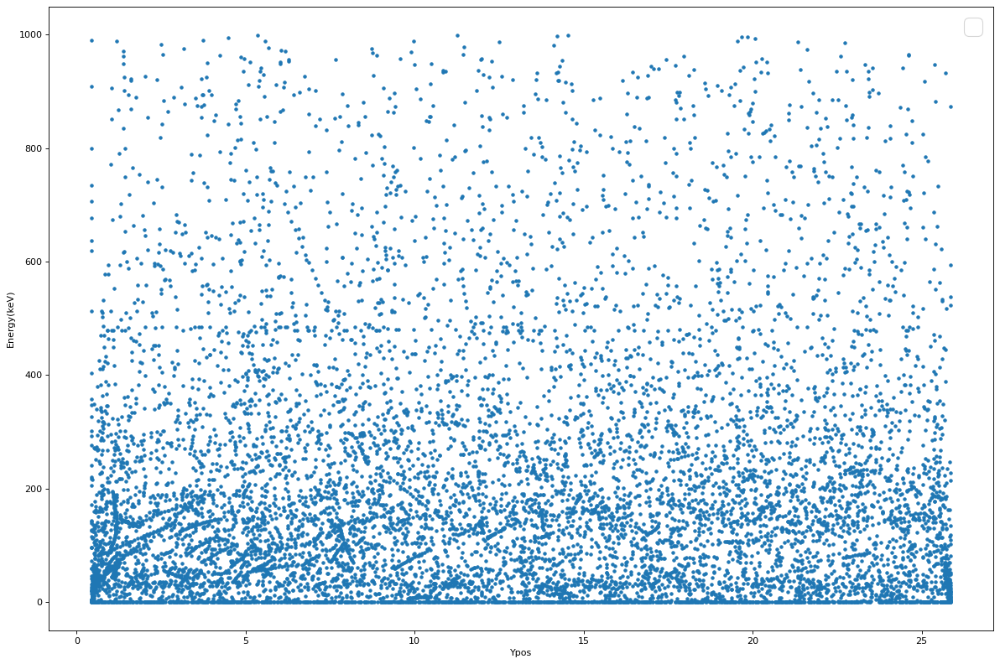

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(first_ypos_list, first_energy_list,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


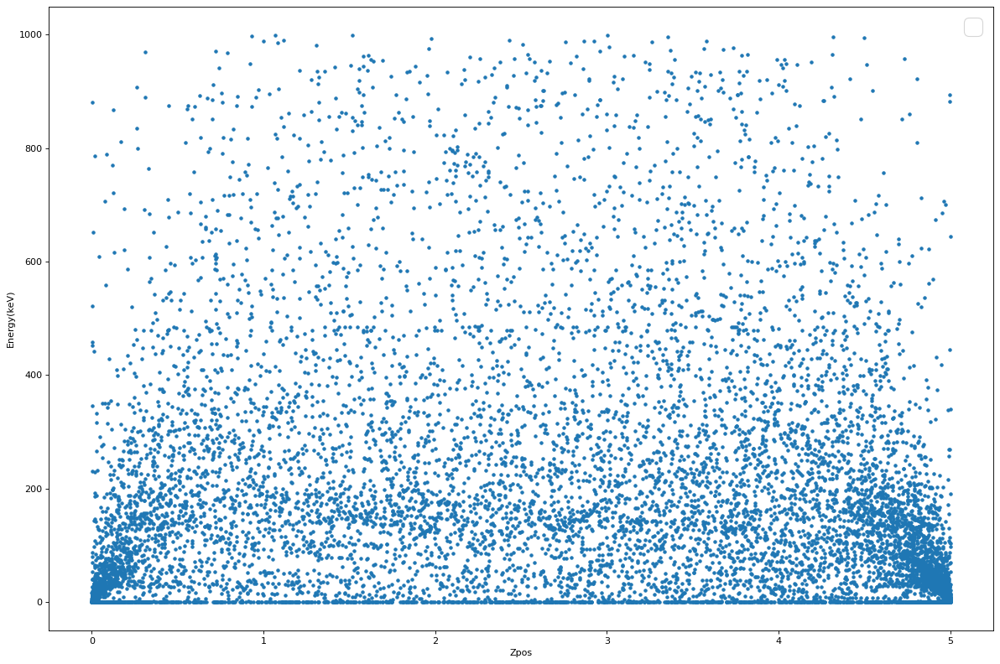

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(first_zpos_list, first_energy_list,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

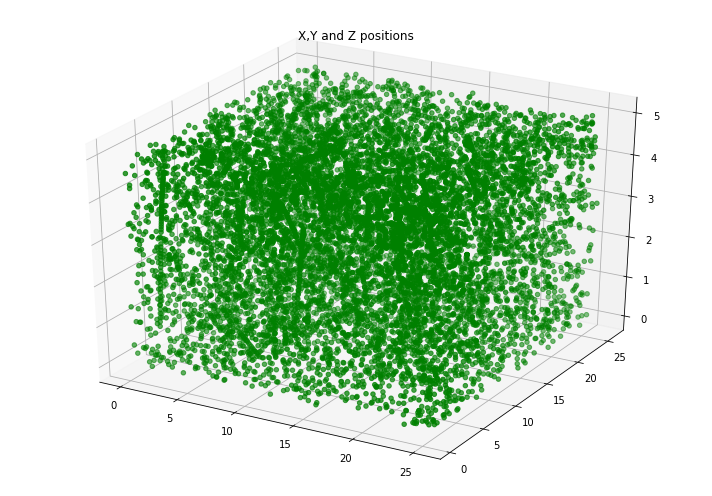

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(first_xpos_list, first_ypos_list, first_zpos_list, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

In [ ]:
a=0
b=1000

for i in range(10):
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(first_xpos_list[a:b], first_ypos_list[a:b], first_zpos_list[a:b], color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

  a+=1000
  b+=1000

Output hidden; open in https://colab.research.google.com to view.

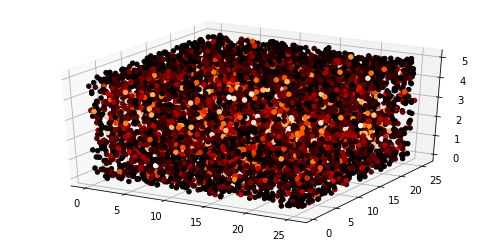

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(first_xpos_list, first_ypos_list, first_zpos_list, c=first_energy_list, cmap='gist_heat', alpha=1)
plt.show()

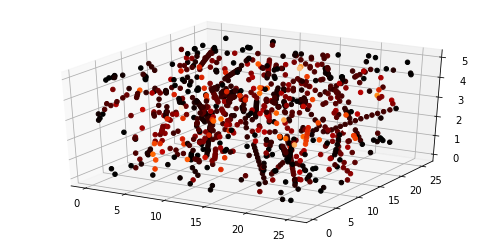

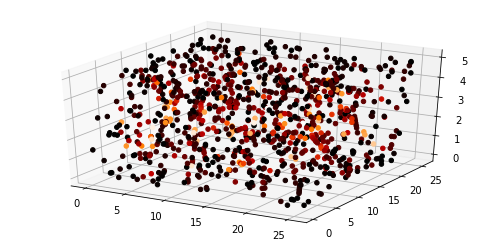

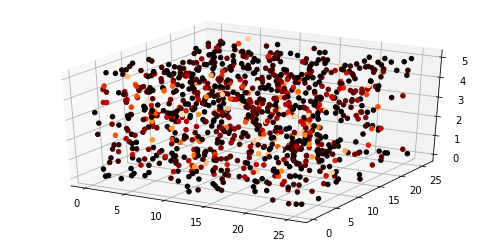

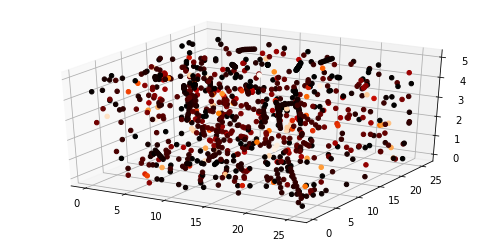

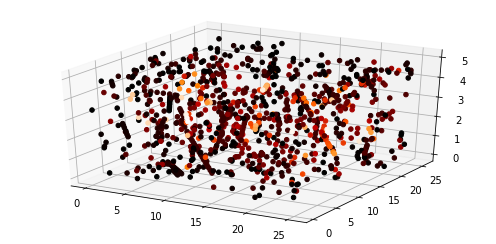

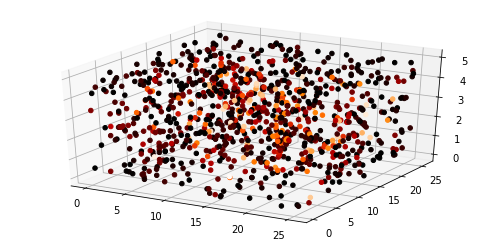

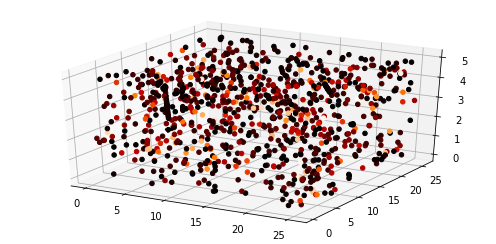

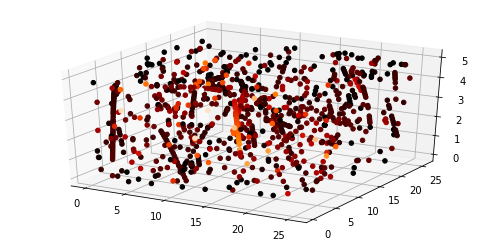

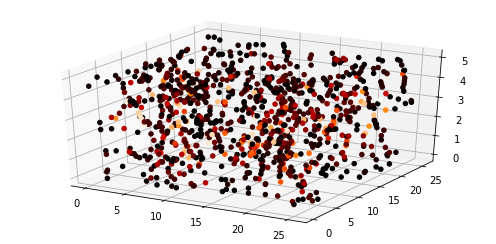

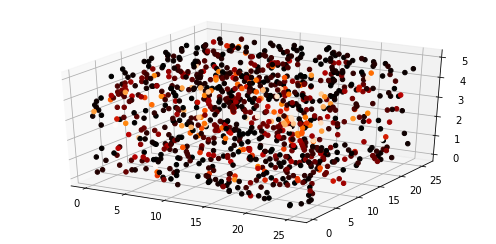

In [ ]:
a=0
b=1000

for i in range(10):
  plt.rcParams["figure.figsize"] = [7.00, 3.50]
  plt.rcParams["figure.autolayout"] = True

  fig = plt.figure()
  ax = fig.add_subplot(111, projection='3d')


  img = ax.scatter(first_xpos_list[a:b], first_ypos_list[a:b], first_zpos_list[a:b], c=first_energy_list[a:b], cmap='gist_heat', alpha=1)
  plt.show()

  a+=1000
  b+=1000

## EVENT MEAN GRAPHS

event number= 500


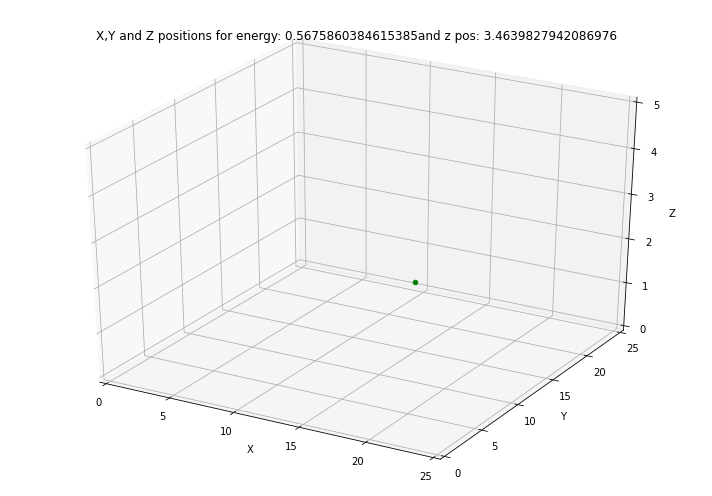

event number= 501


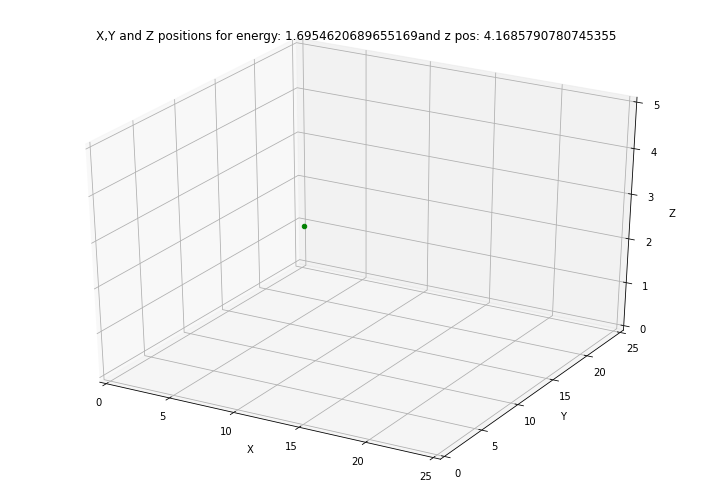

event number= 502


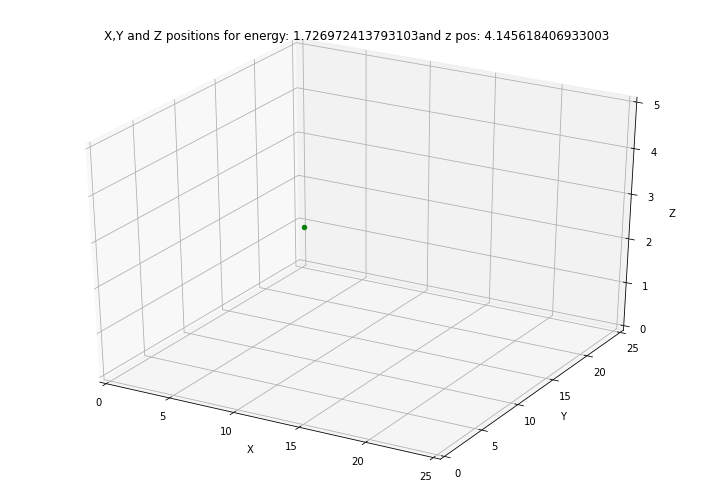

event number= 503


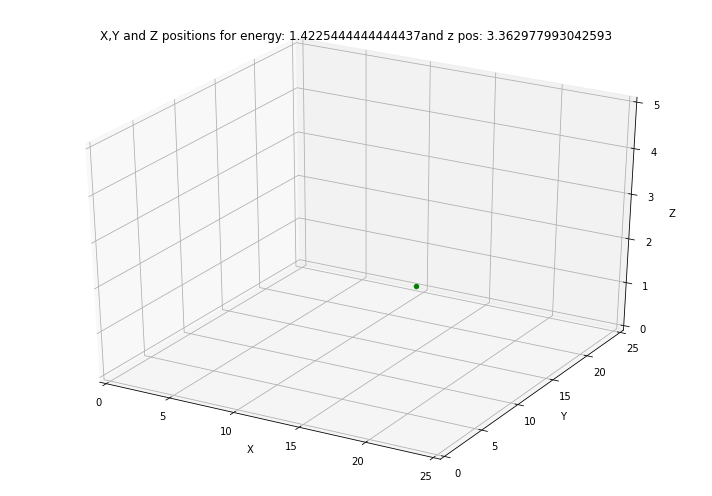

event number= 504


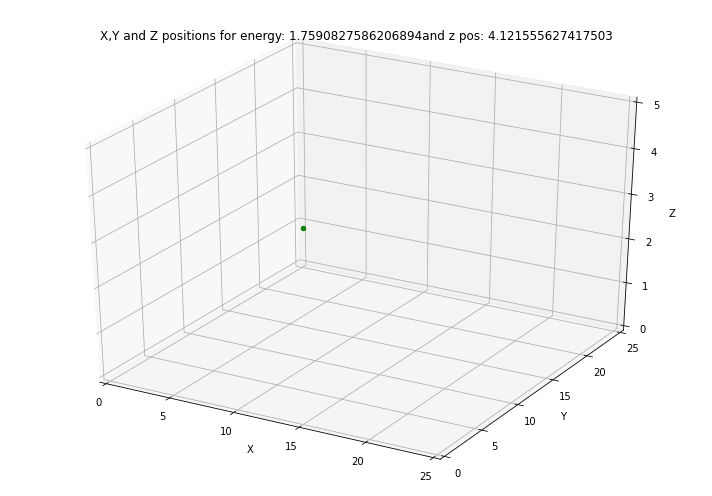

event number= 505


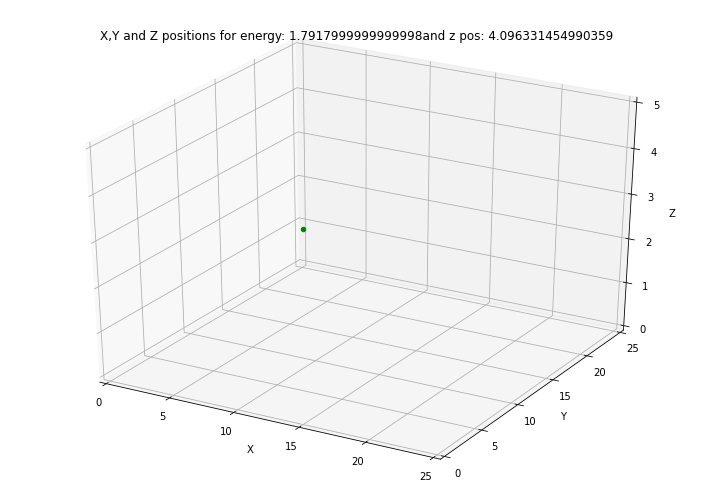

event number= 506


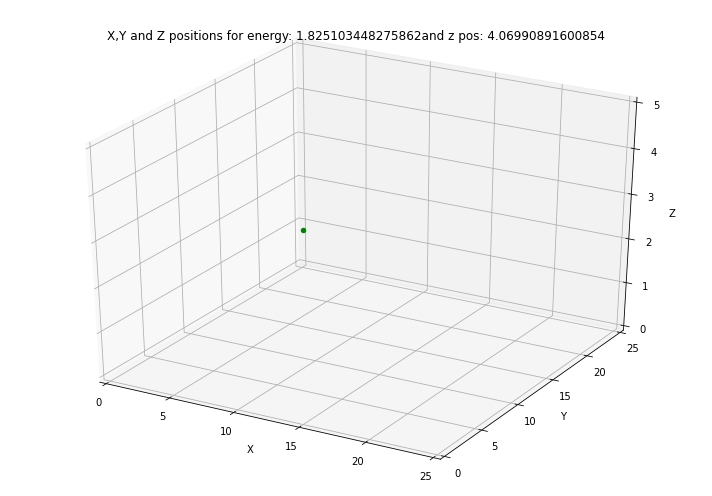

event number= 507


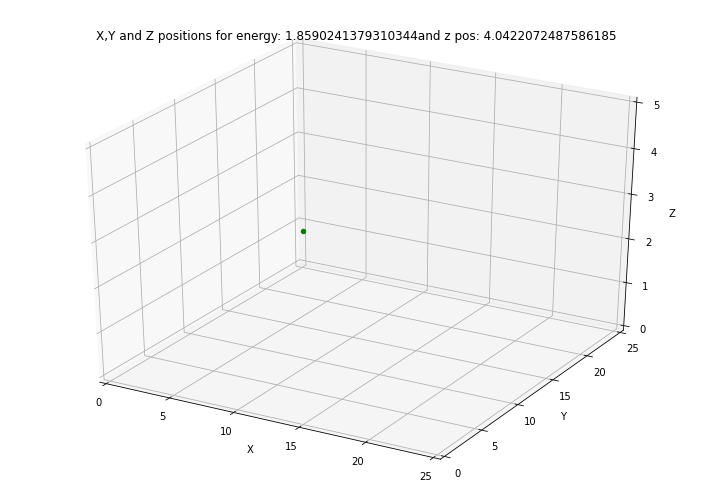

event number= 508


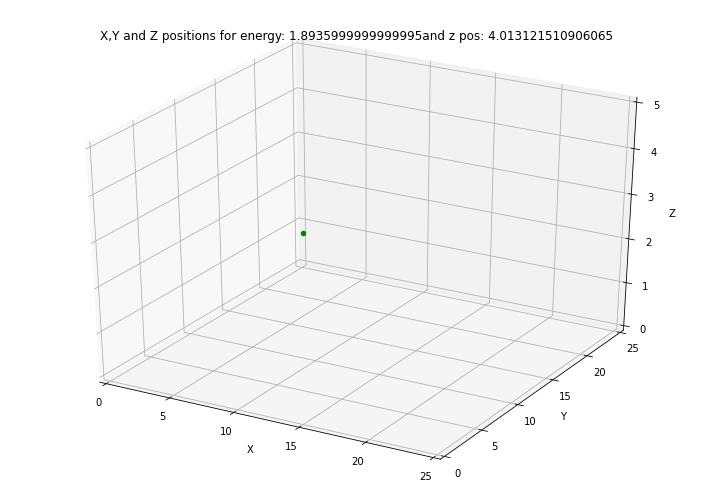

event number= 509


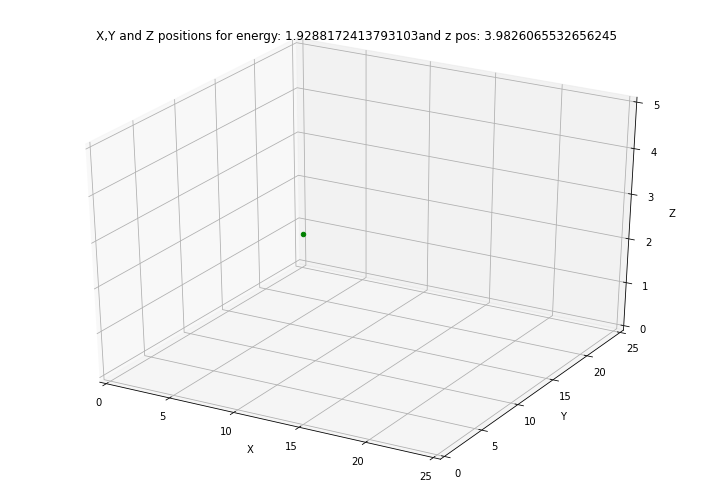

event number= 510


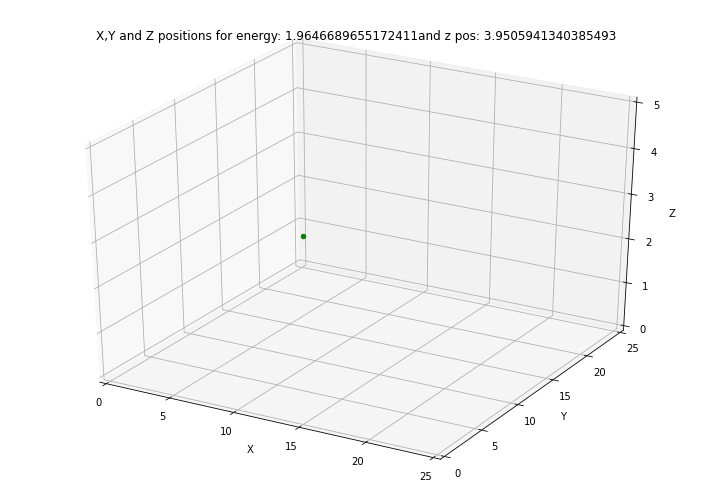

event number= 511


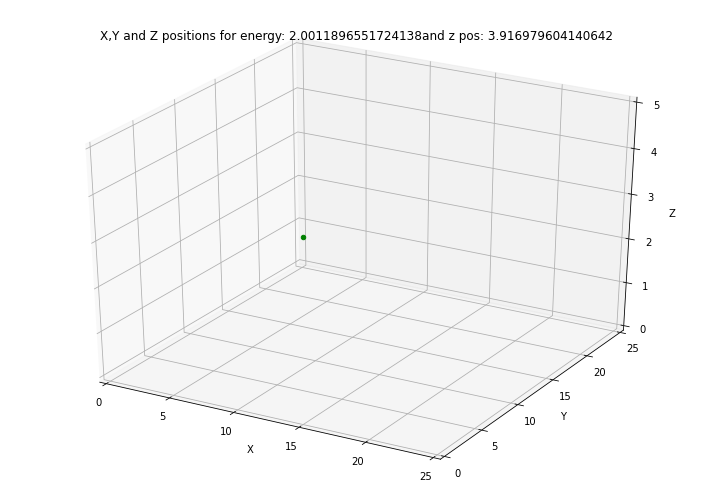

event number= 512


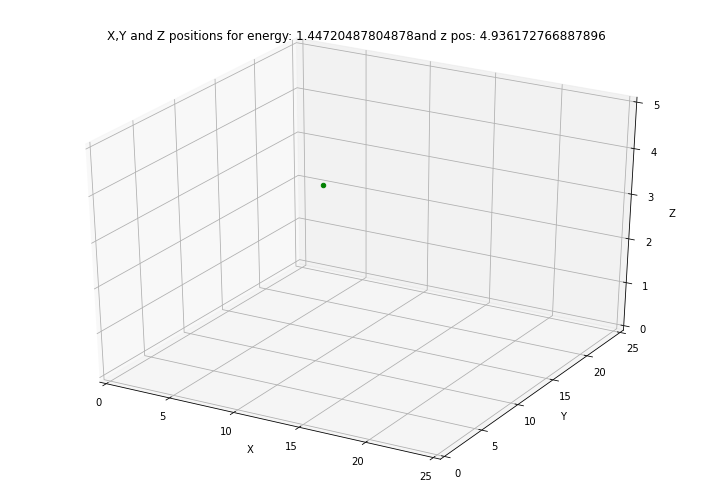

event number= 513


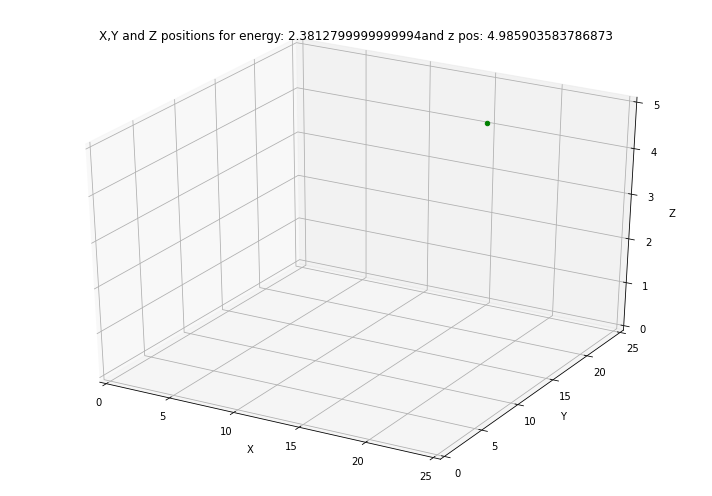

event number= 514


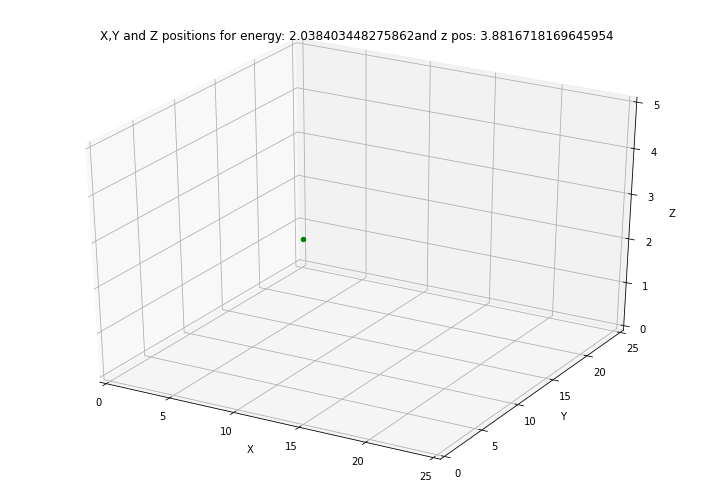

event number= 515


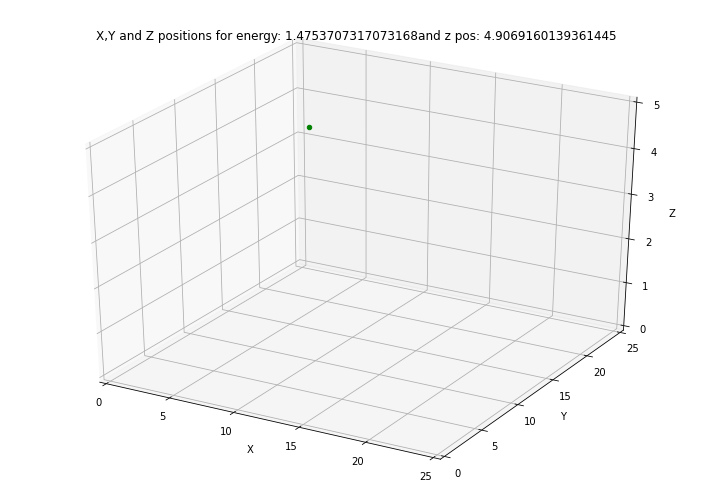

event number= 516


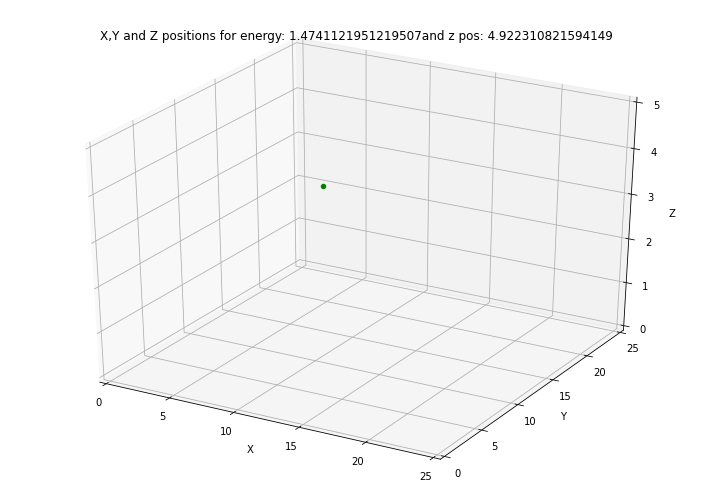

event number= 517


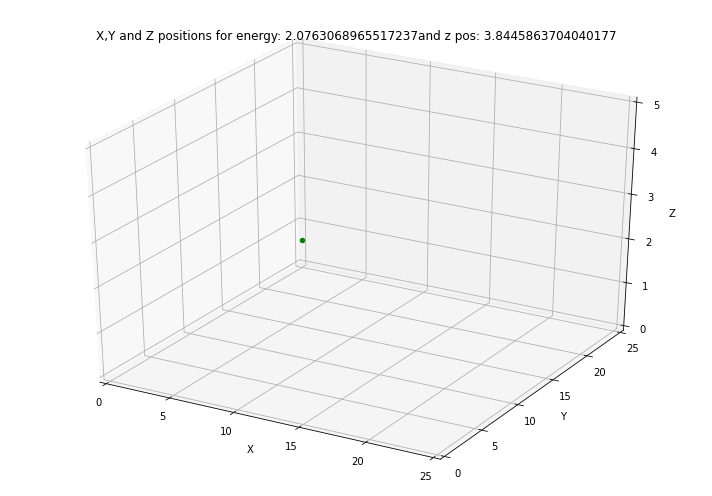

event number= 518


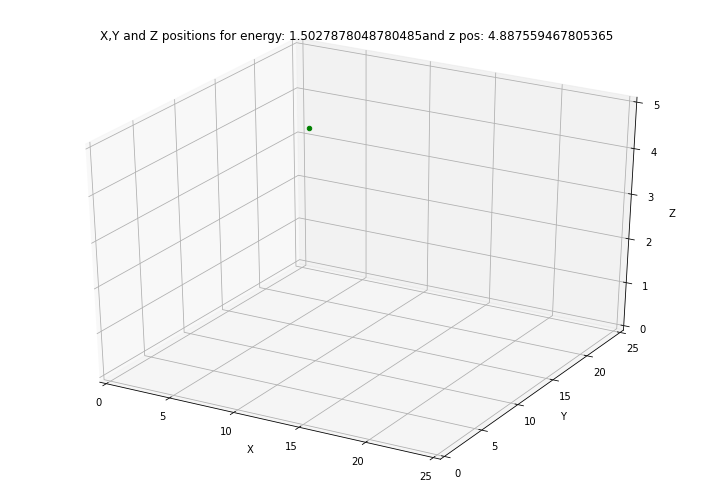

event number= 519


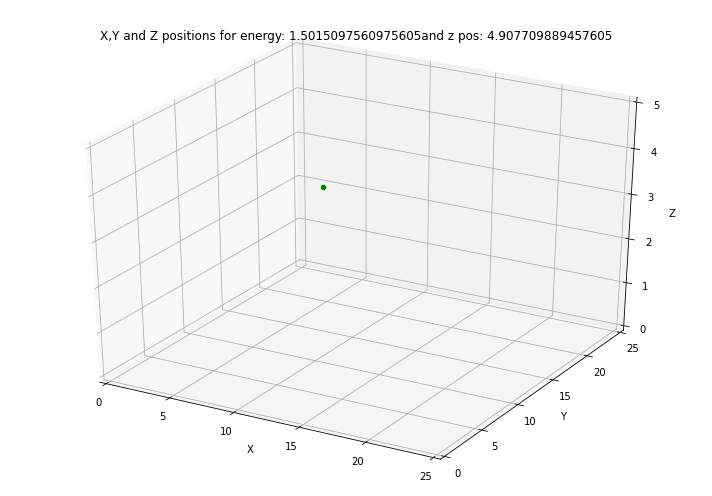

event number= 520


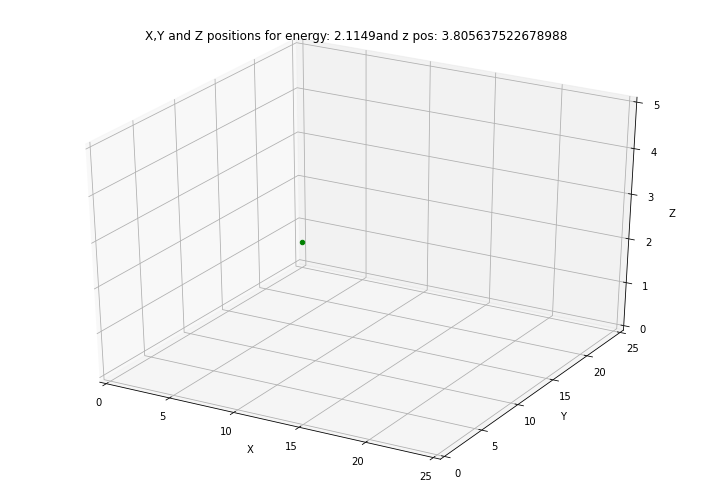

event number= 521


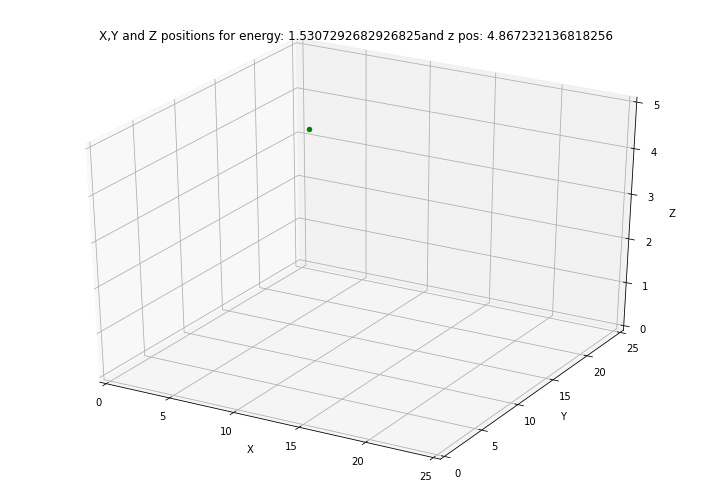

event number= 522


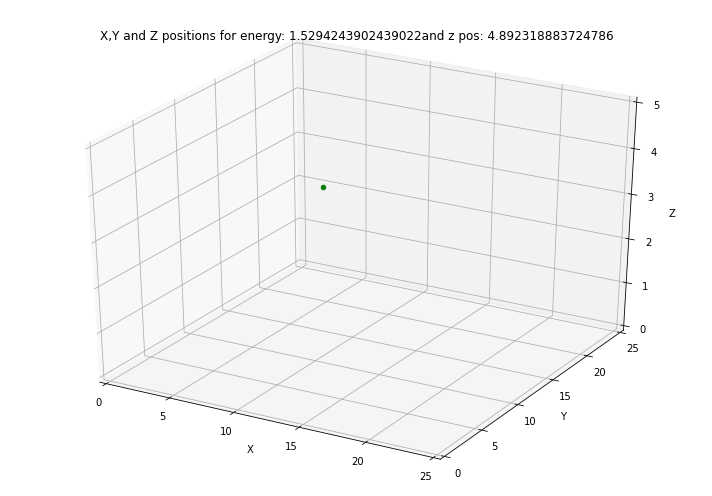

event number= 523


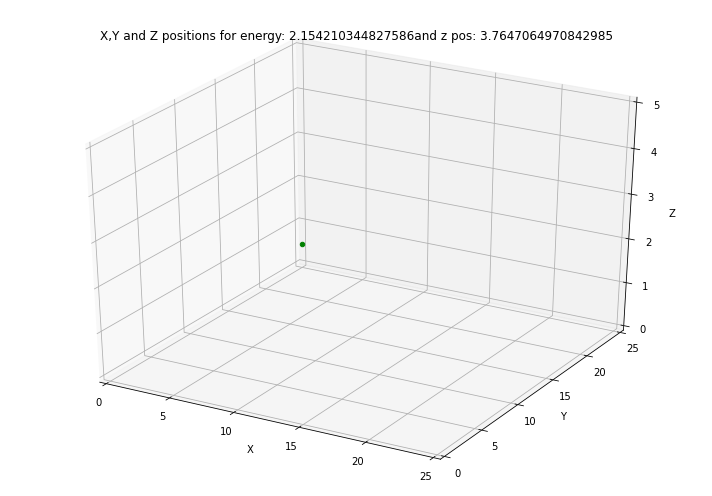

event number= 524


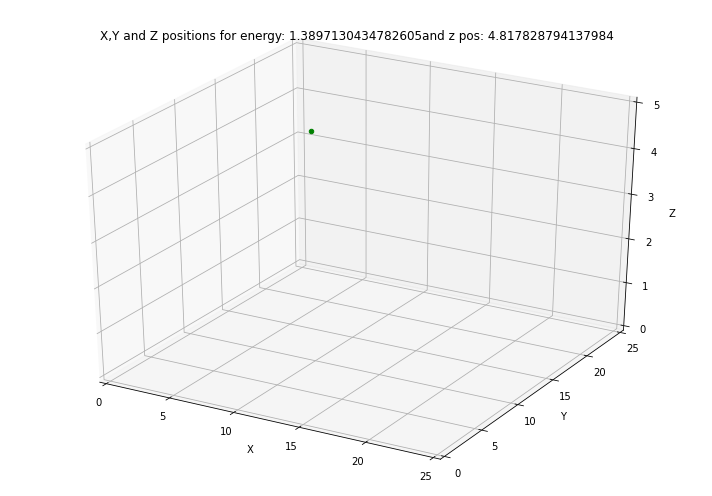

event number= 525


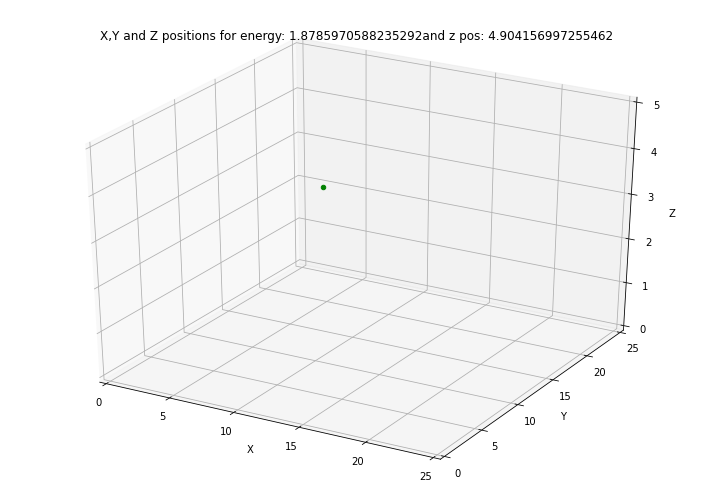

event number= 526


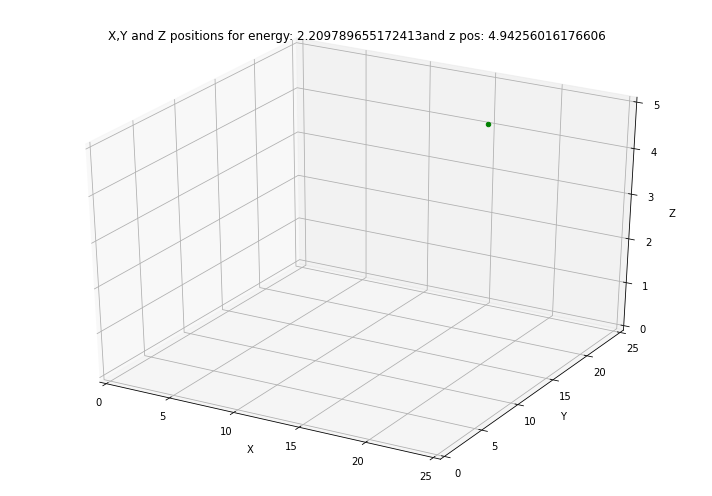

event number= 527


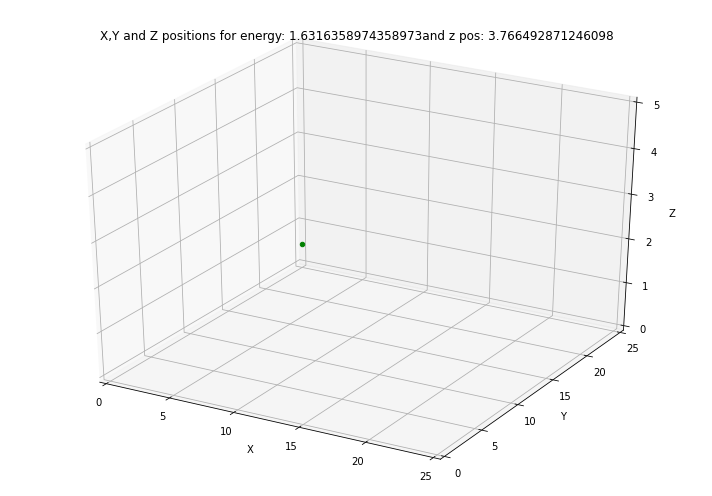

event number= 528


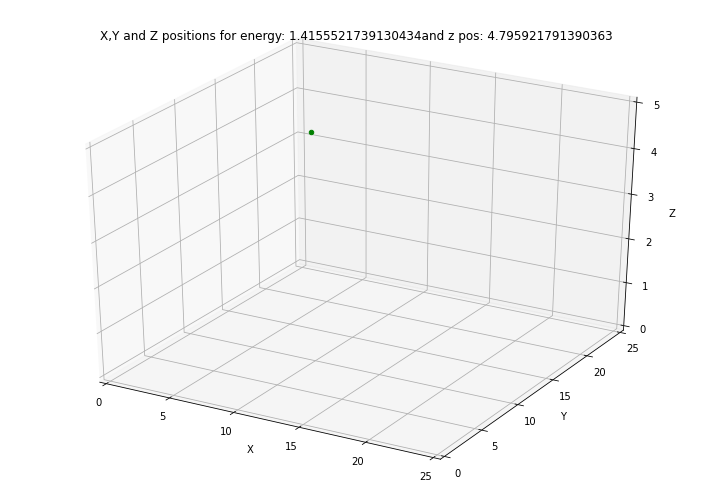

event number= 529


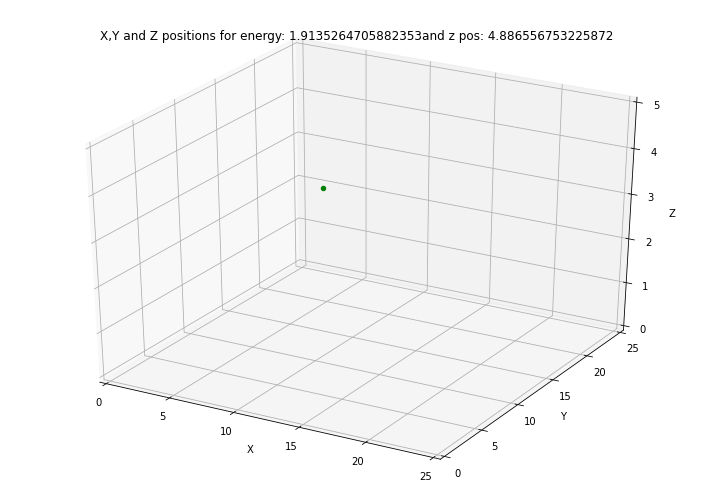

event number= 530


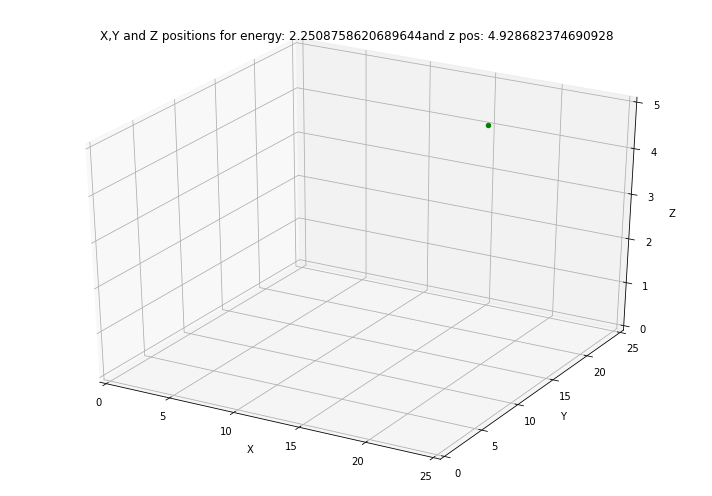

event number= 531


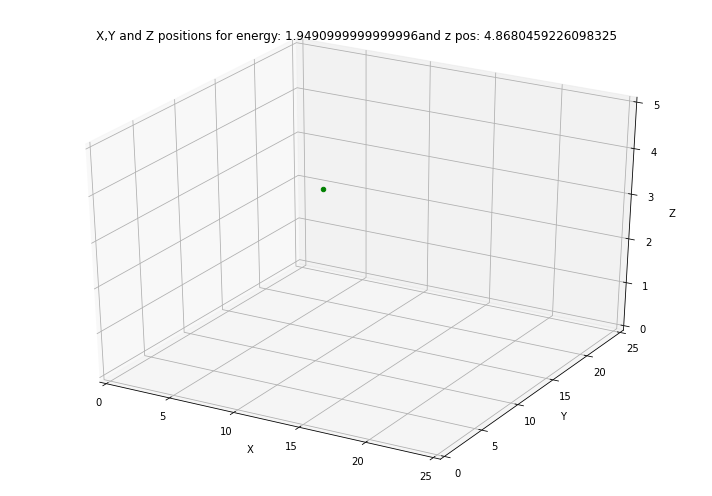

event number= 532


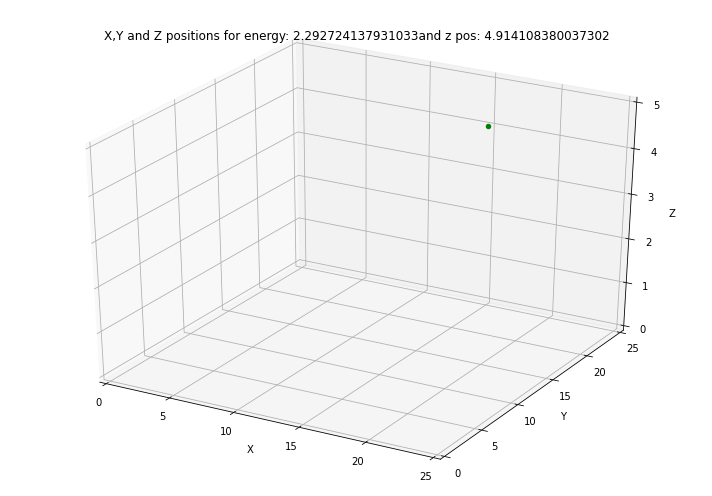

event number= 533


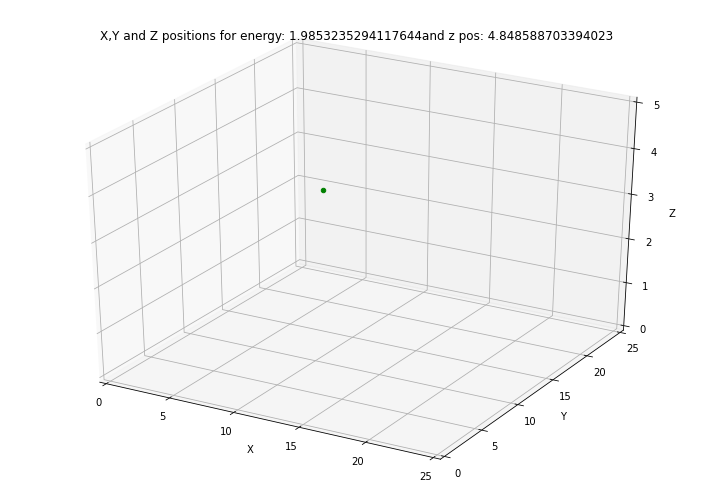

event number= 534


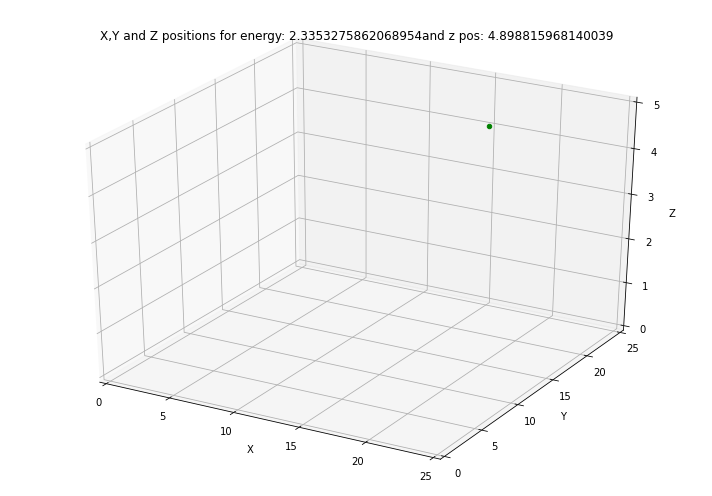

event number= 535


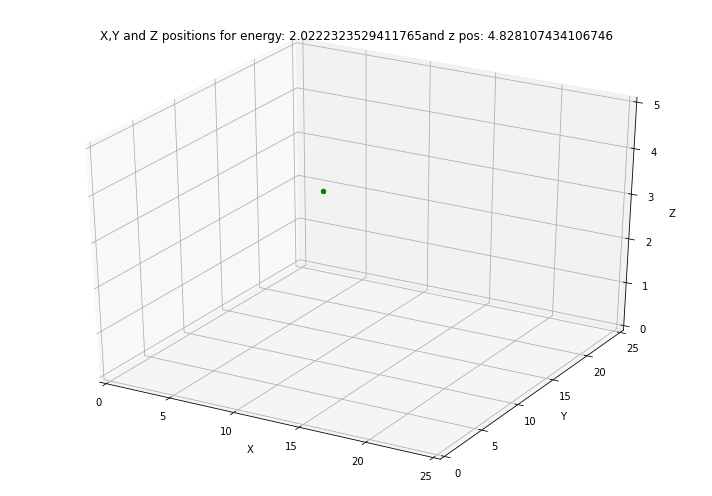

event number= 536


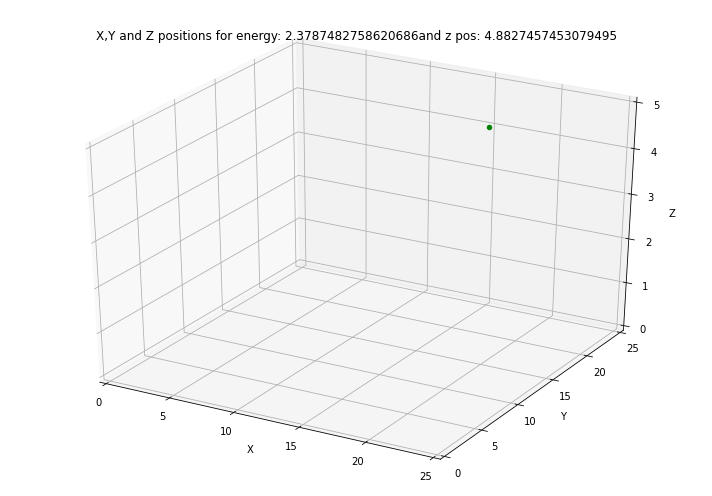

event number= 537


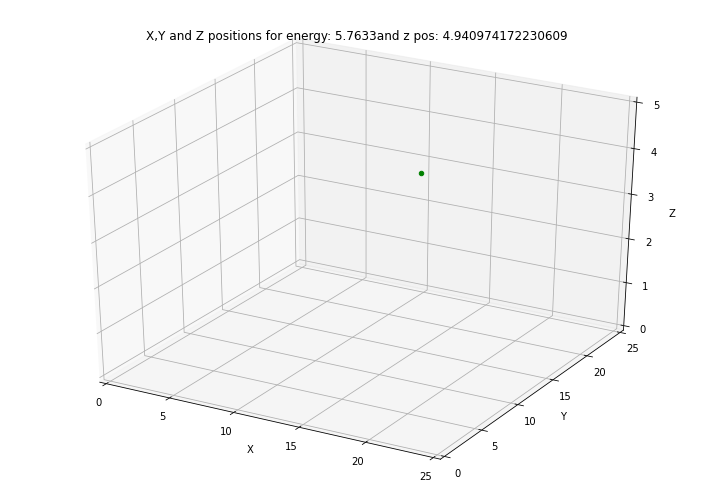

event number= 538


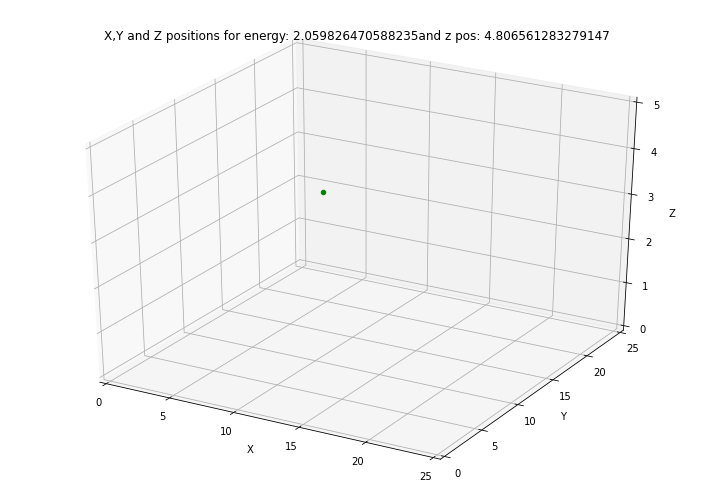

event number= 539


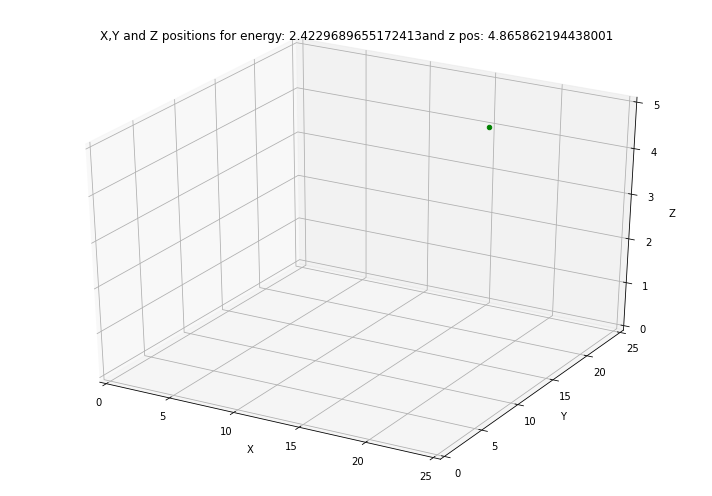

event number= 540


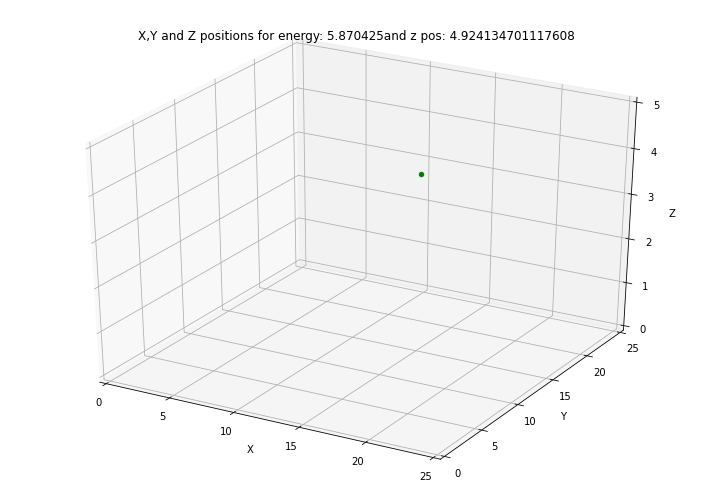

event number= 541


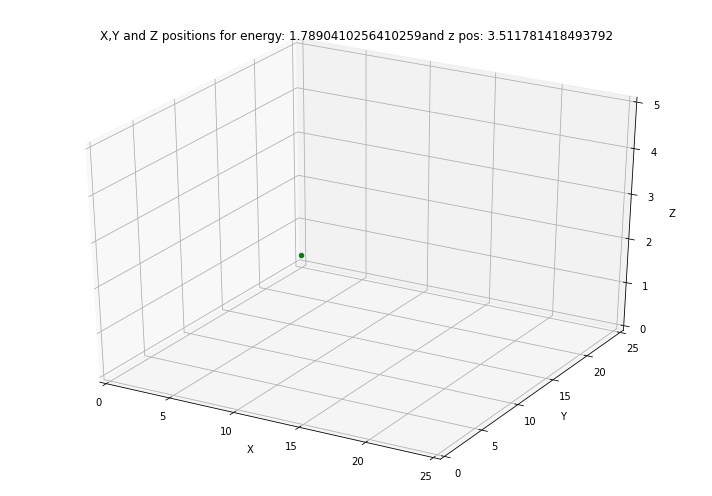

event number= 542


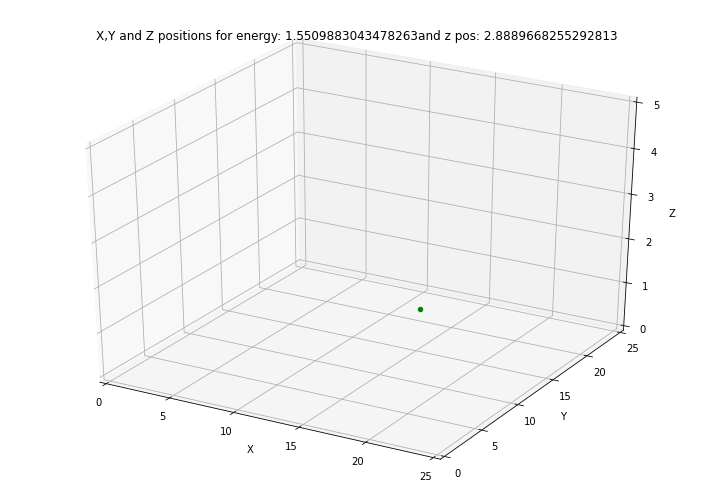

event number= 543


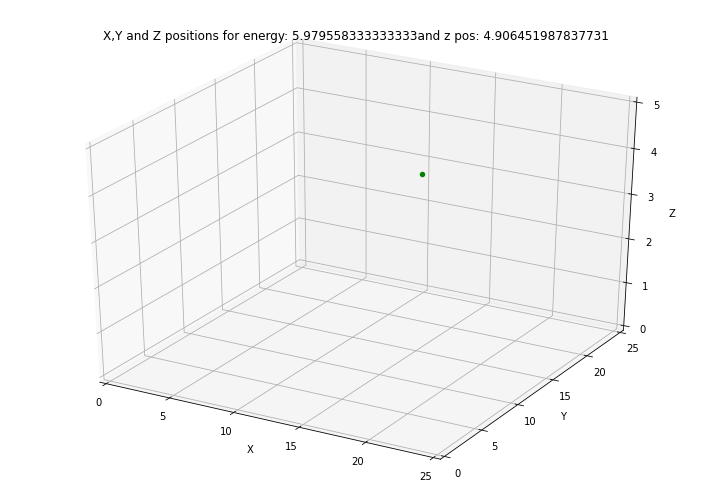

event number= 544


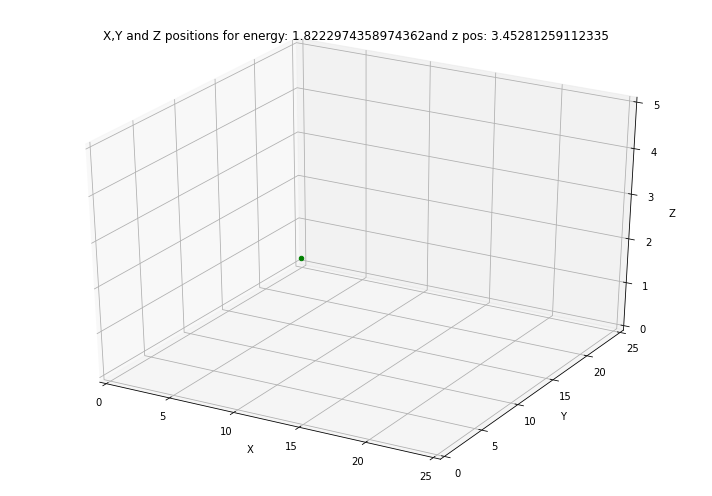

event number= 545


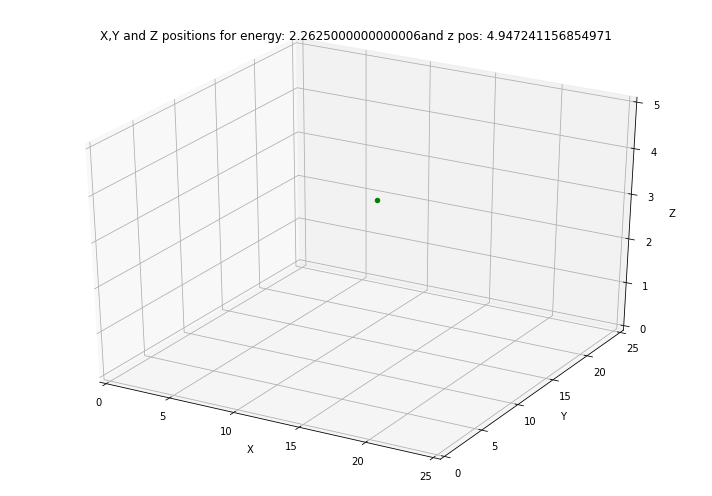

event number= 546


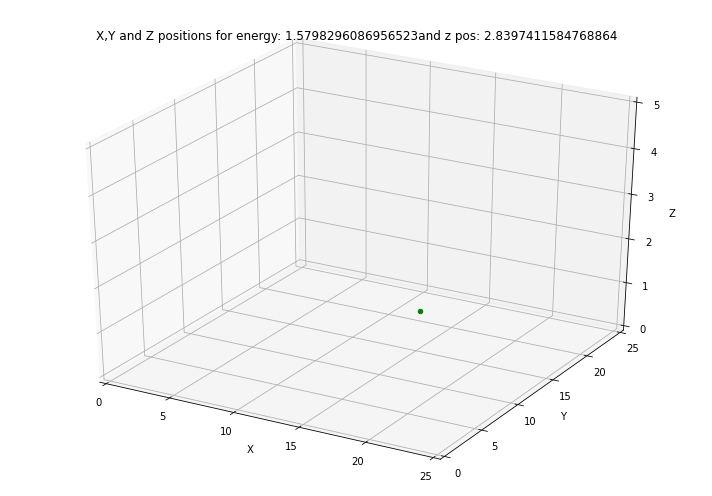

event number= 547


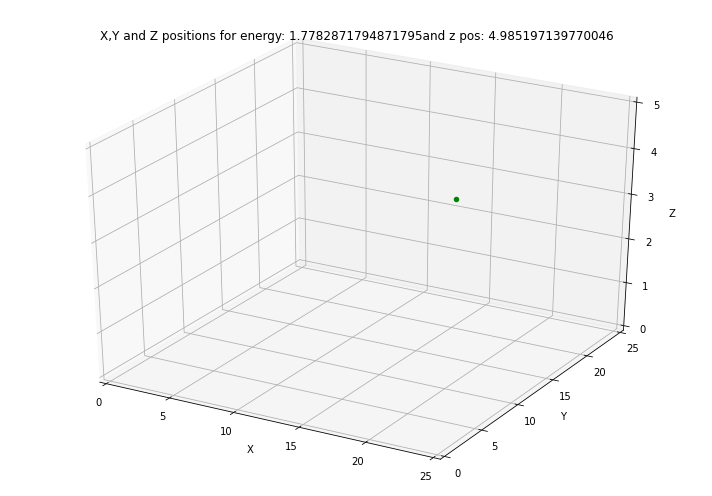

event number= 548


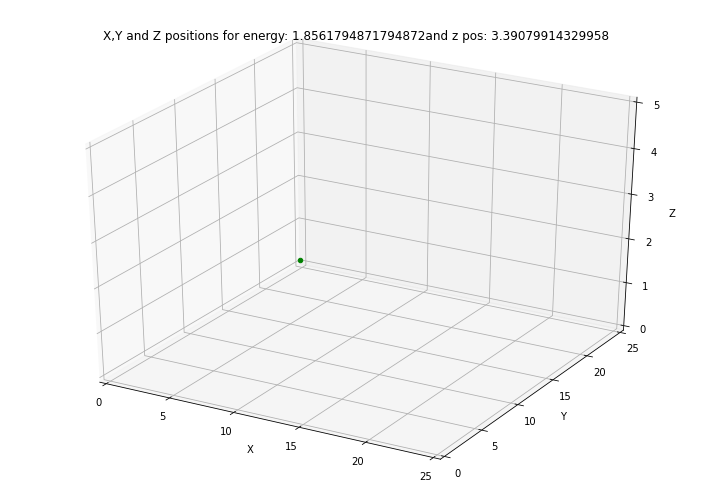

event number= 549


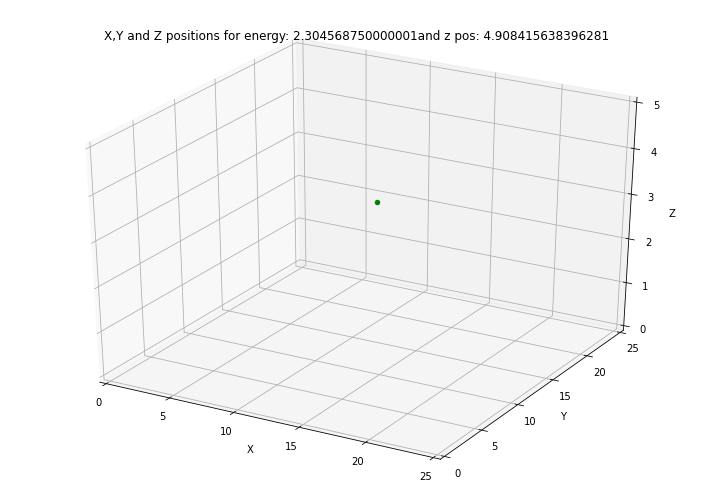

event number= 550


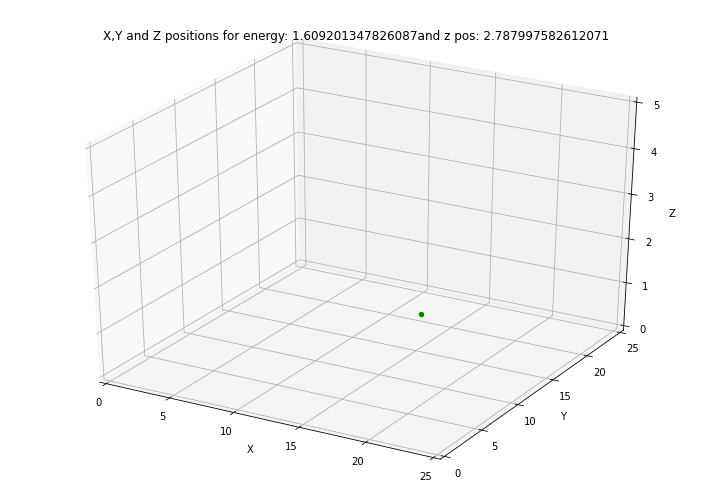

event number= 551


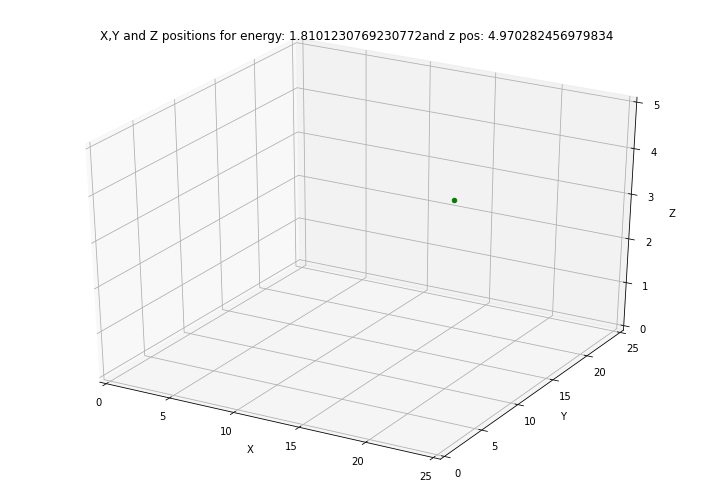

event number= 552


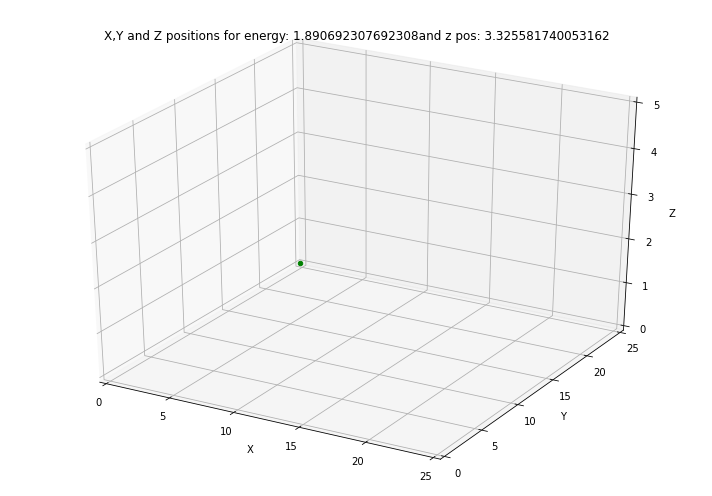

event number= 553


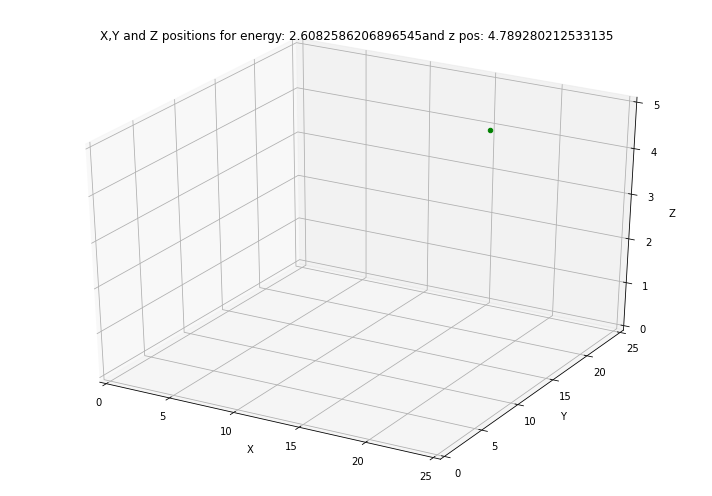

event number= 554


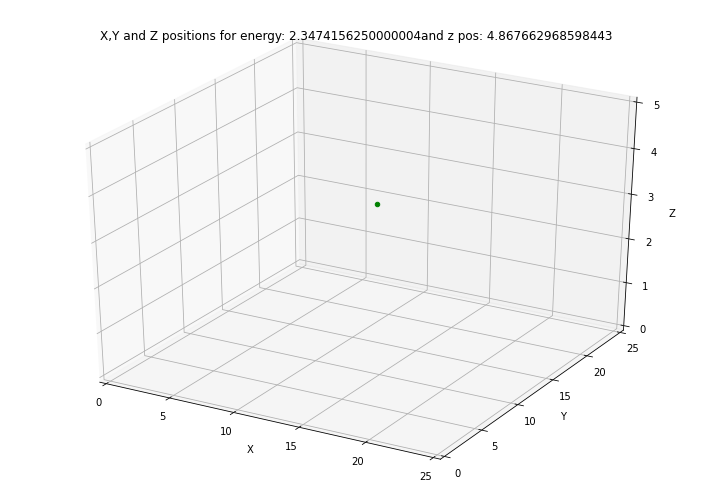

event number= 555


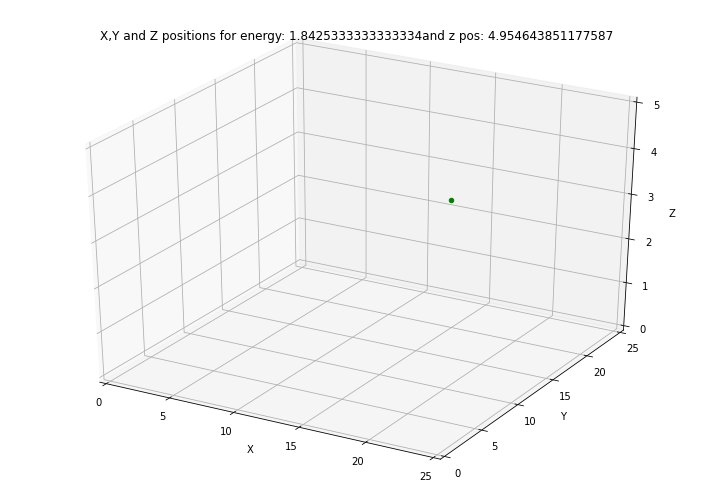

event number= 556


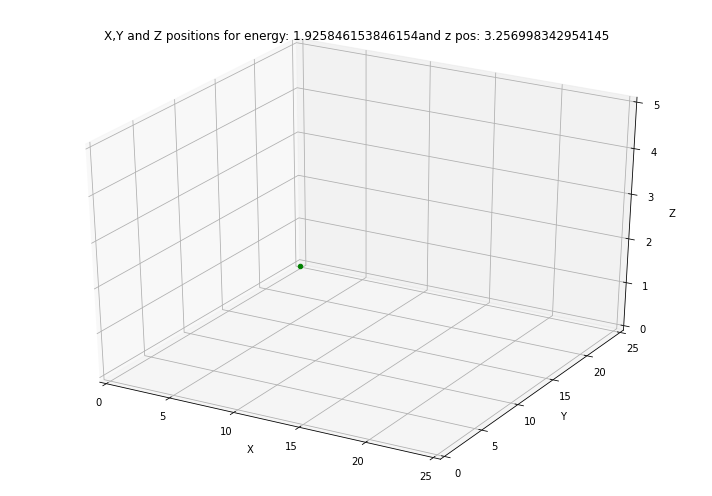

event number= 557


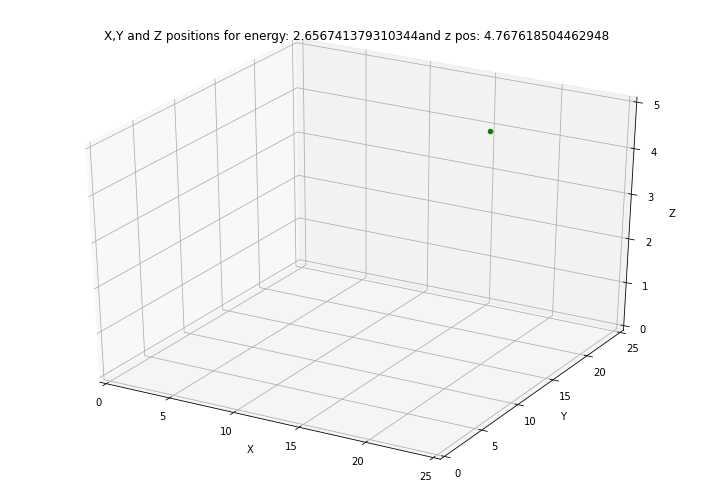

event number= 558


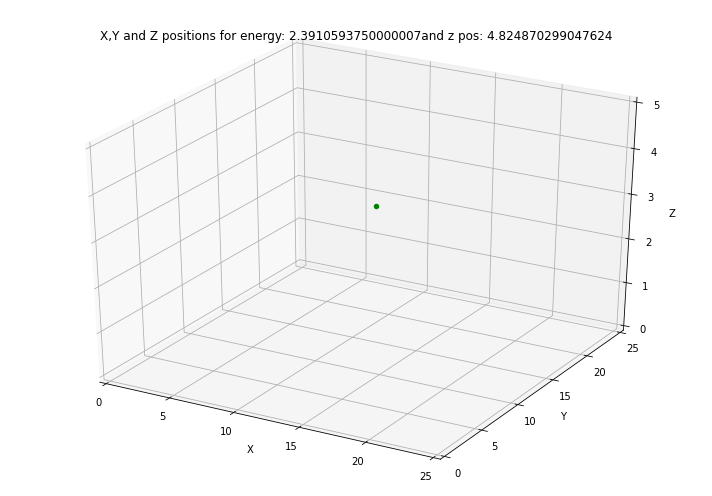

event number= 559


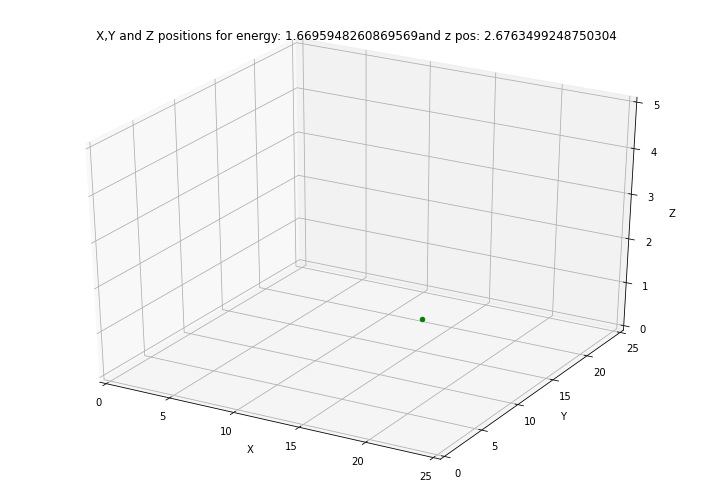

event number= 560


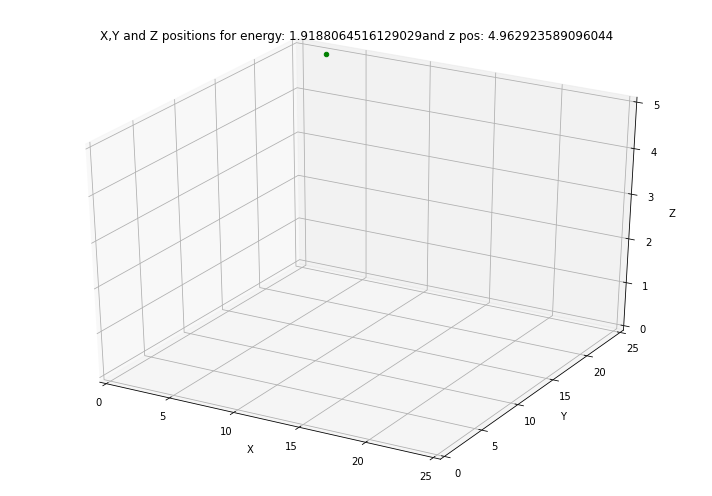

event number= 561


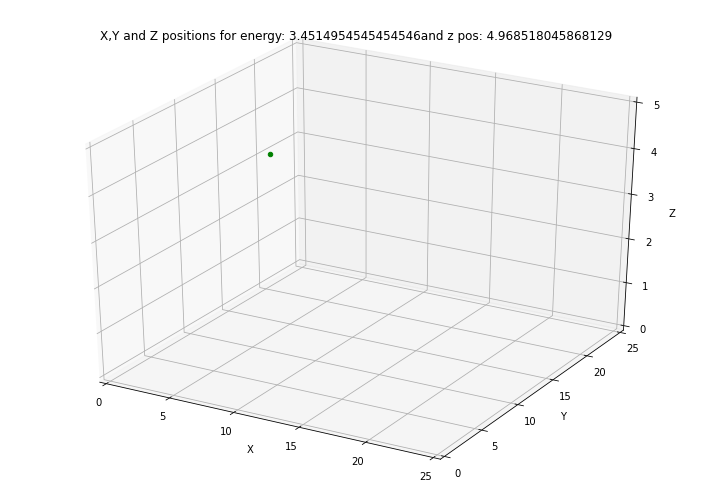

event number= 562


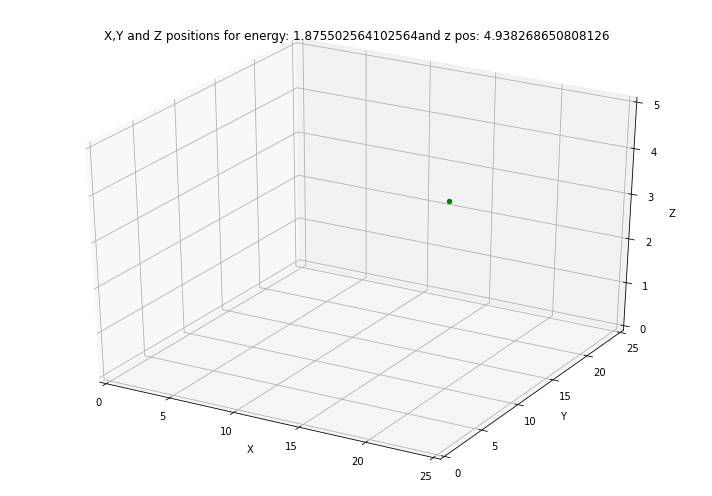

event number= 563


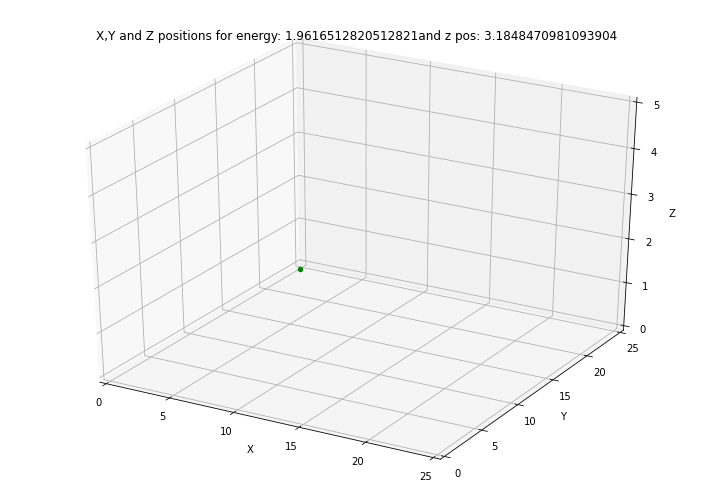

event number= 564


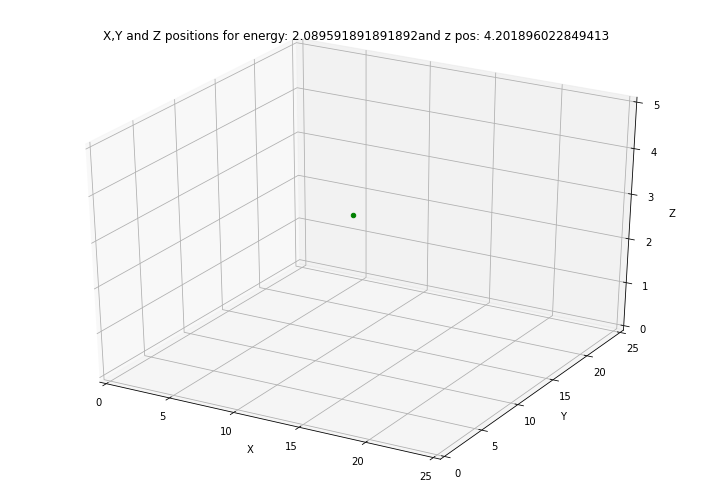

event number= 565


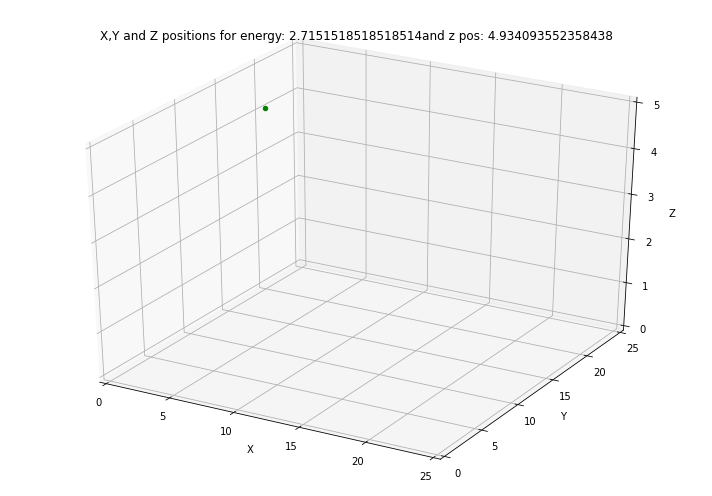

event number= 566


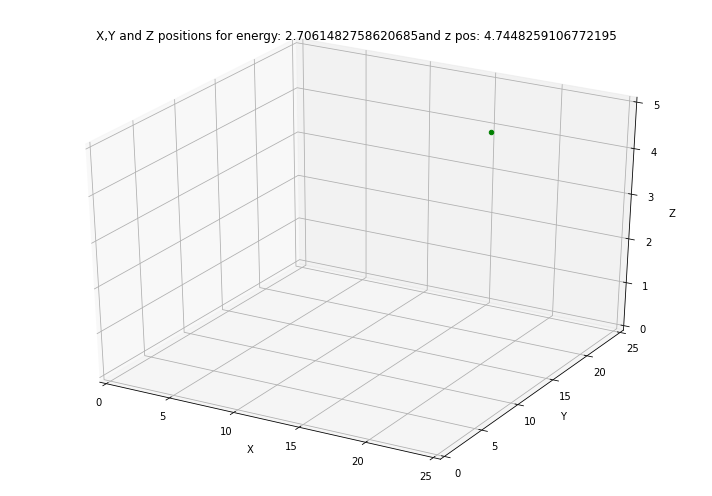

event number= 567


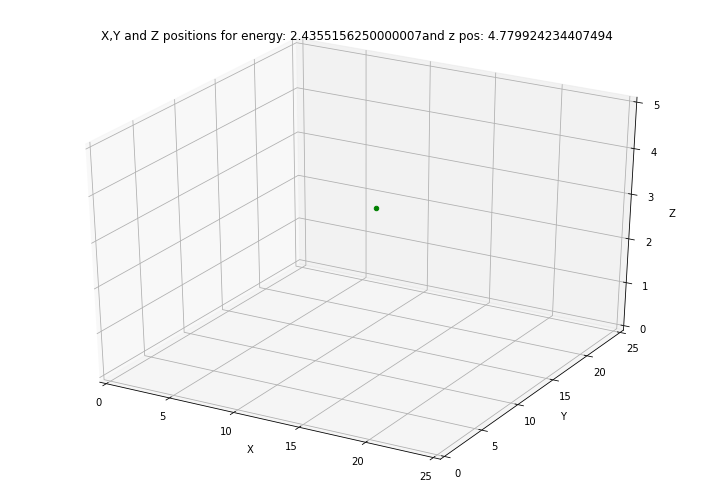

event number= 568


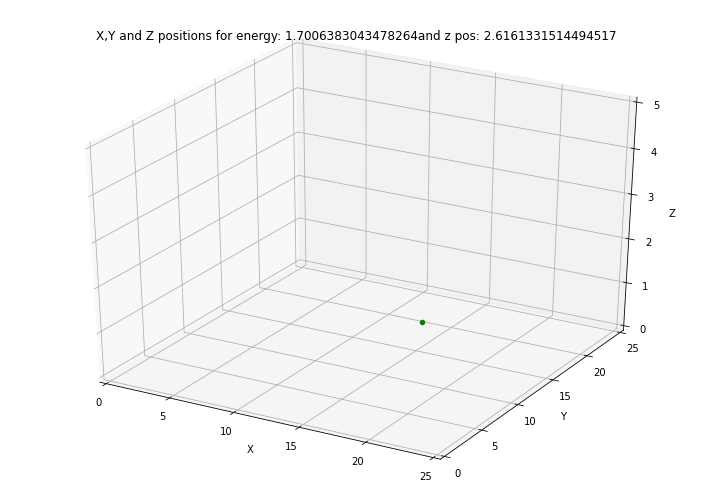

event number= 569


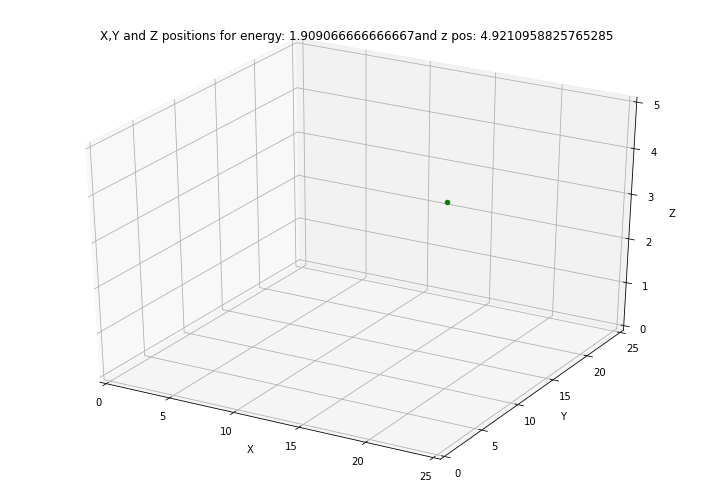

event number= 570


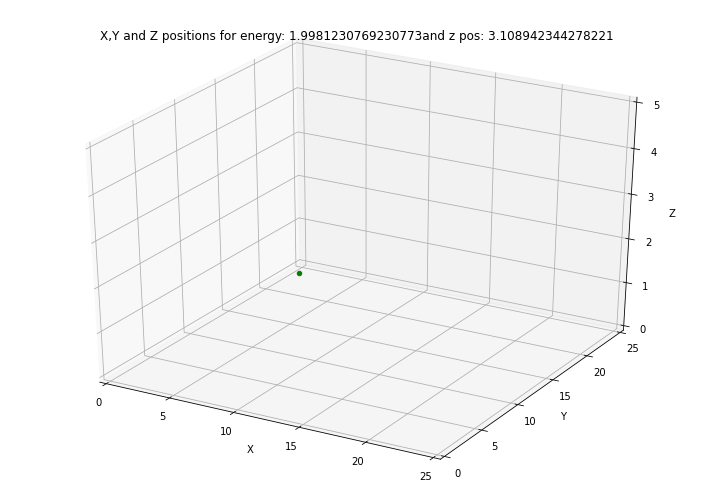

event number= 571


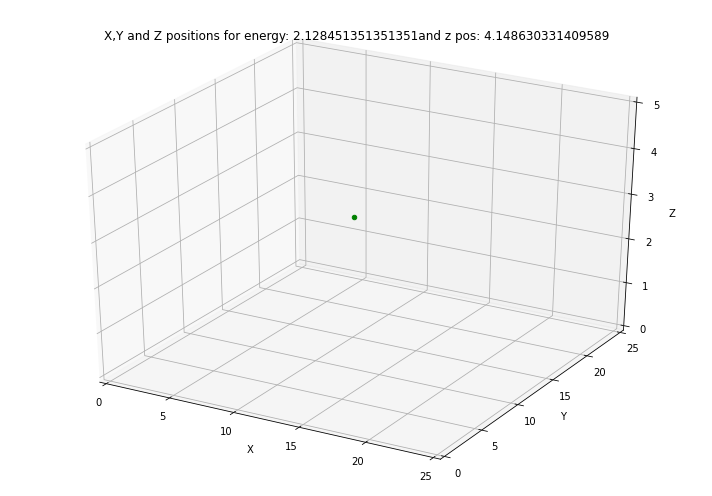

event number= 572


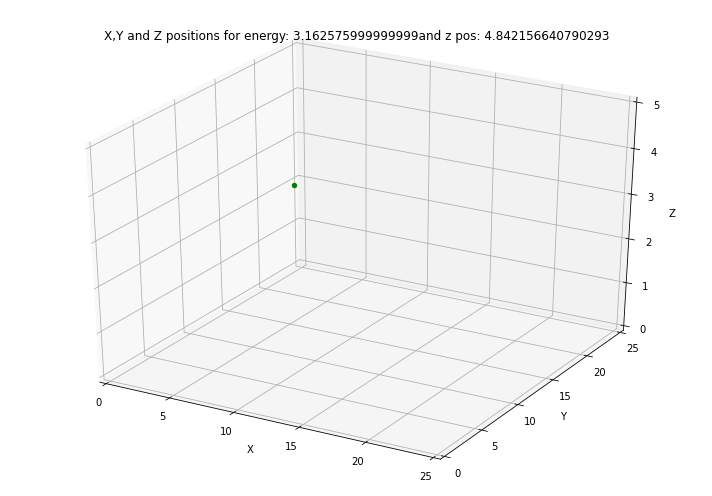

event number= 573


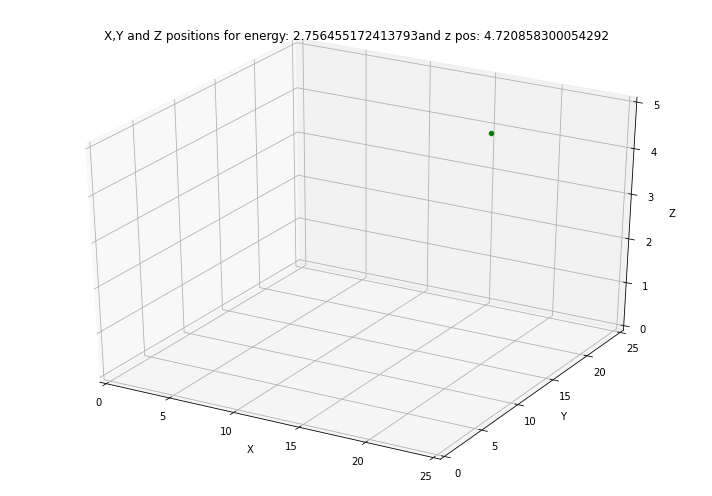

event number= 574


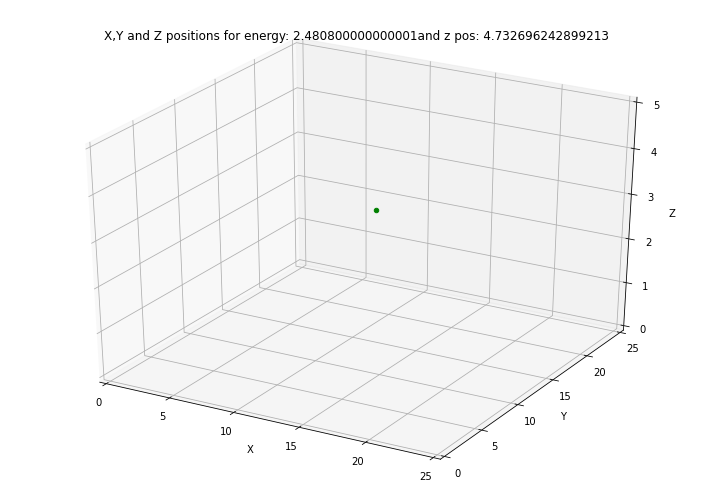

event number= 575


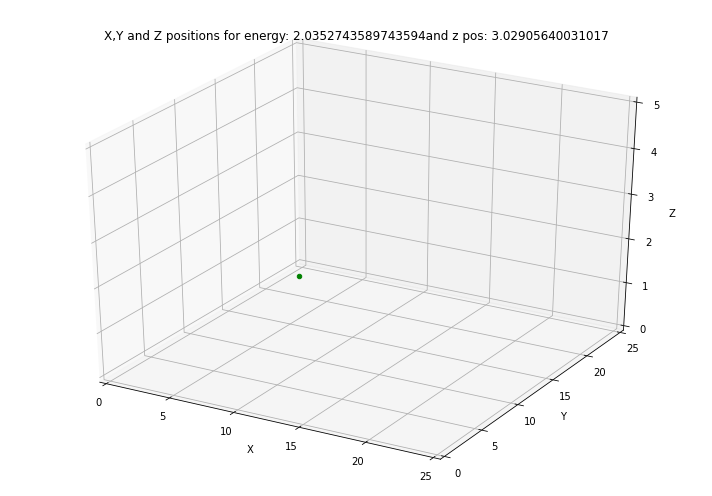

event number= 576


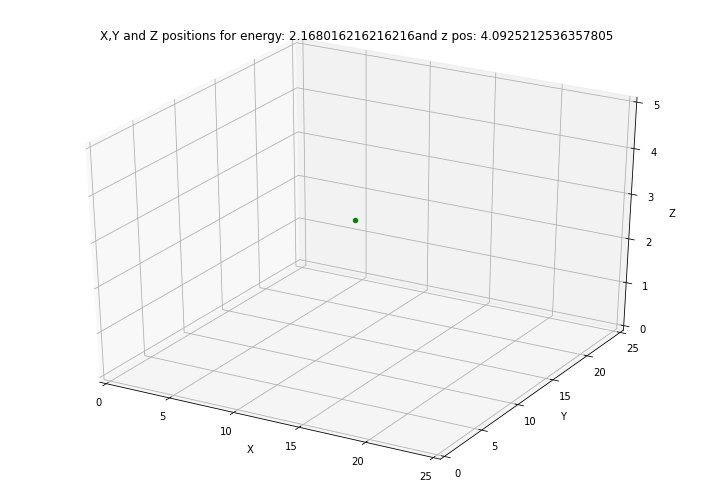

event number= 577


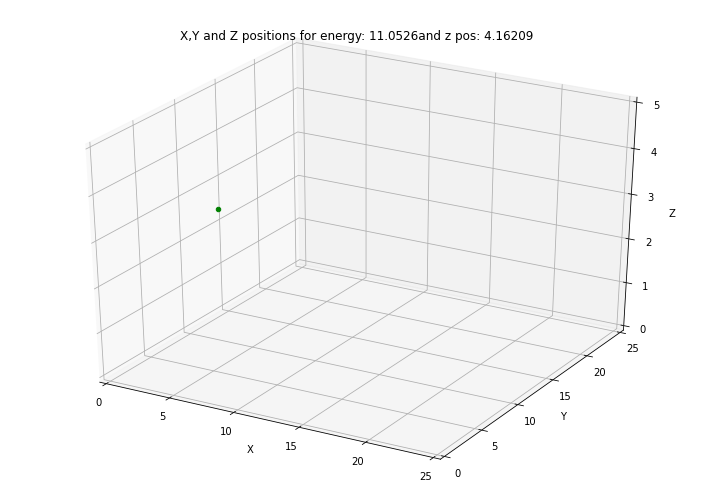

event number= 578


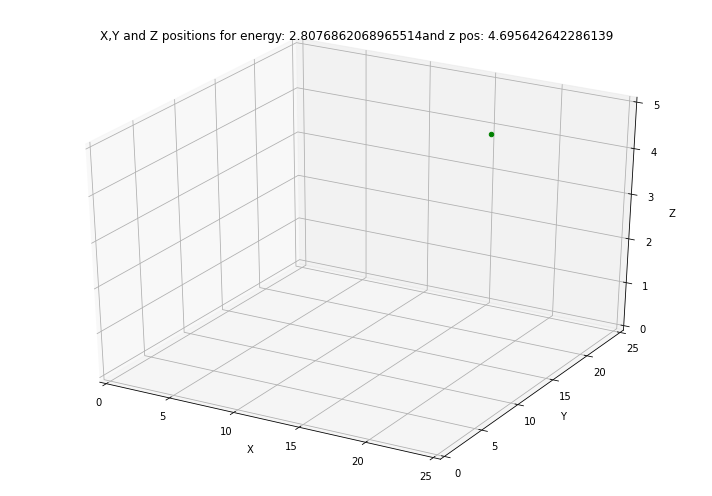

event number= 579


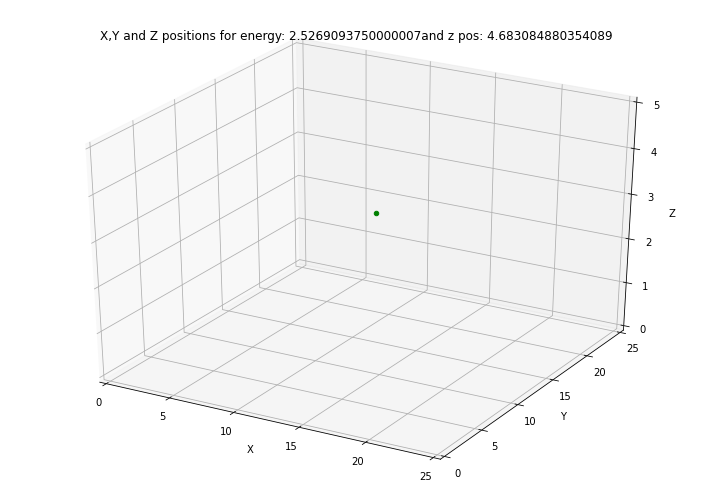

event number= 580


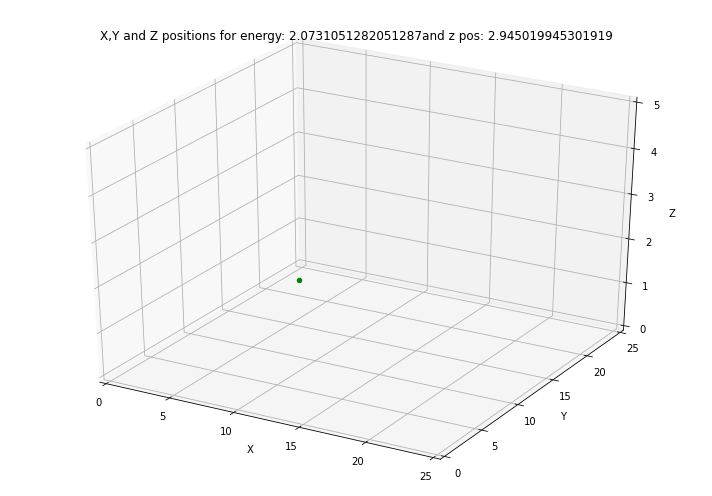

event number= 581


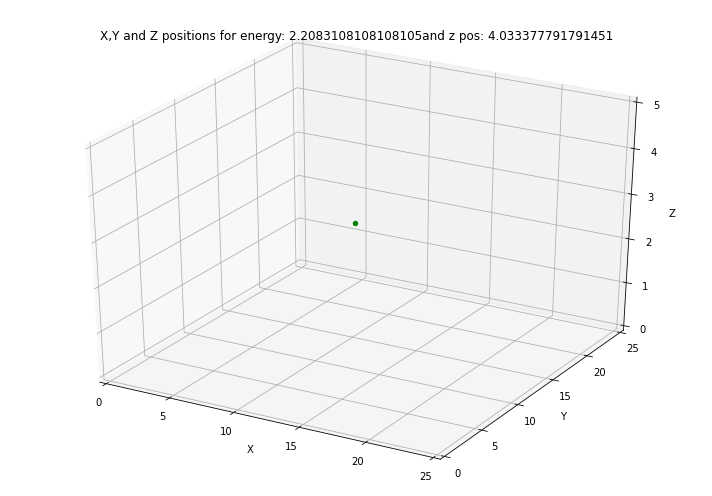

event number= 582


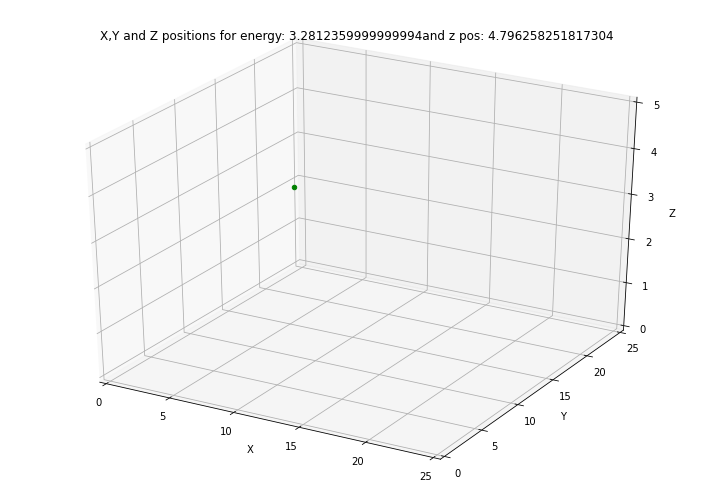

event number= 583


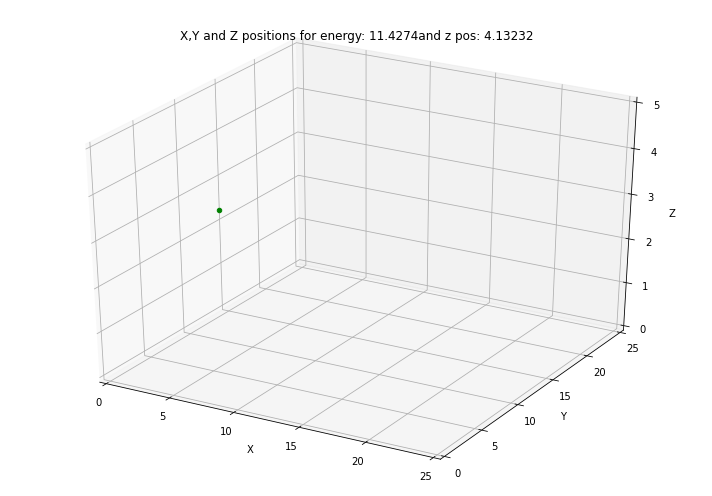

event number= 584


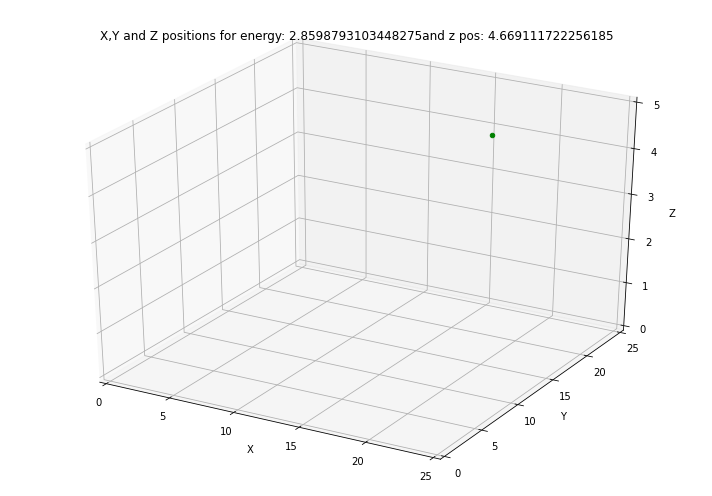

event number= 585


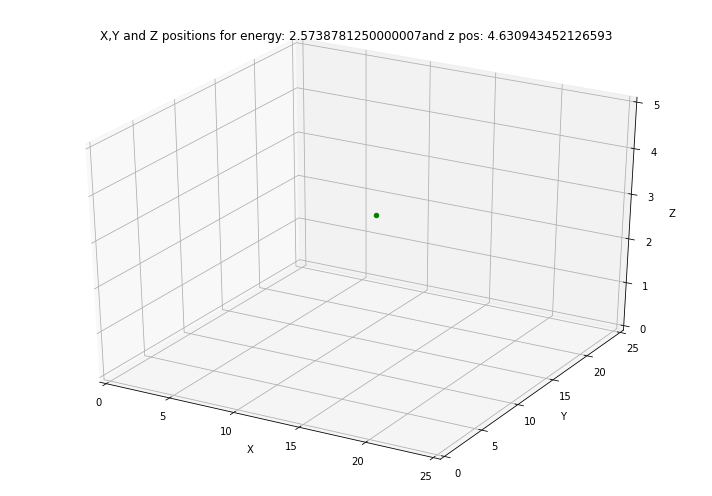

event number= 586


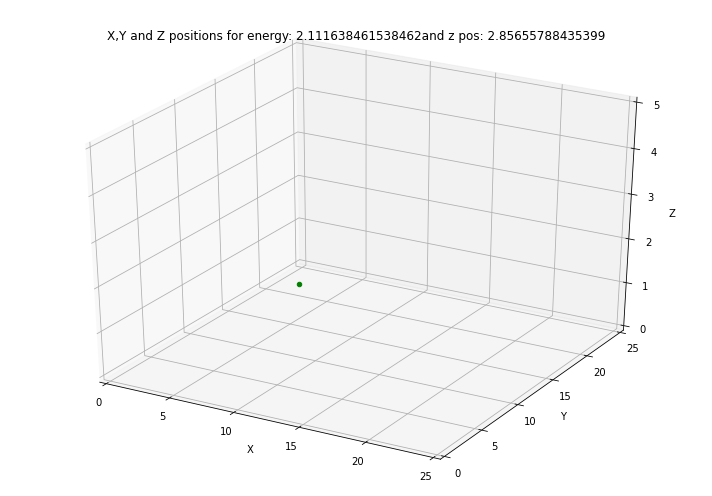

event number= 587


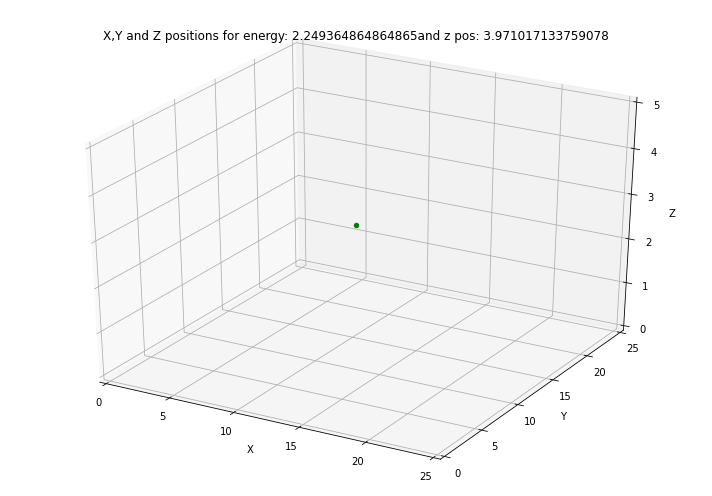

event number= 588


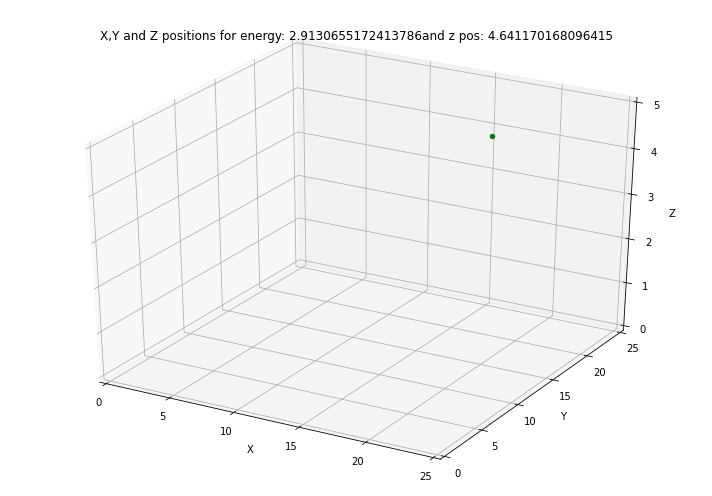

event number= 589


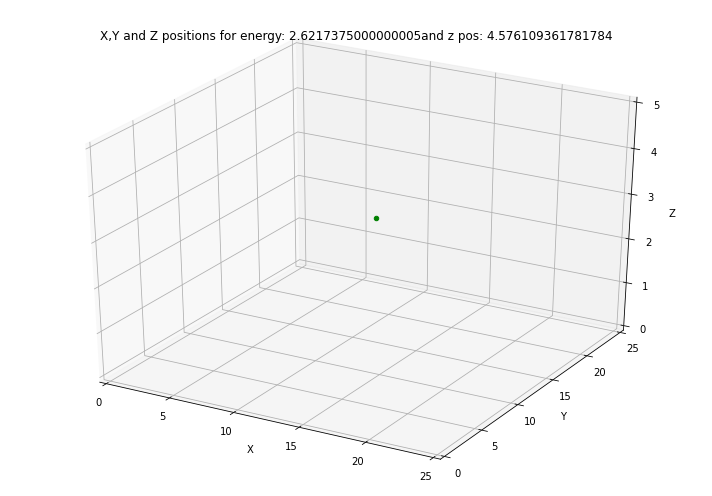

event number= 590


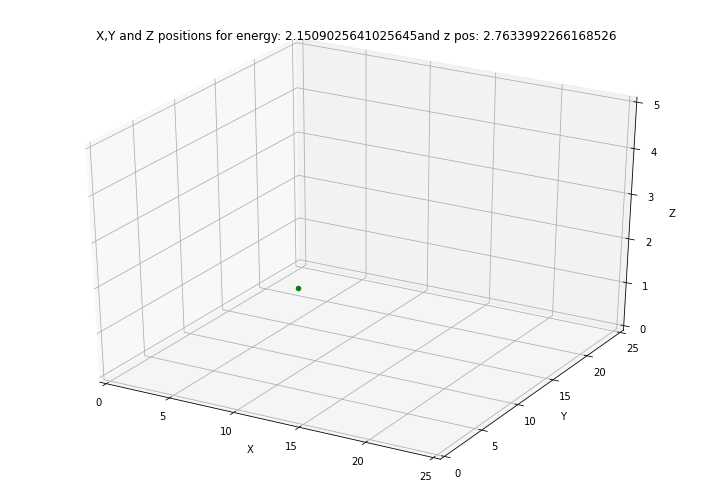

event number= 591


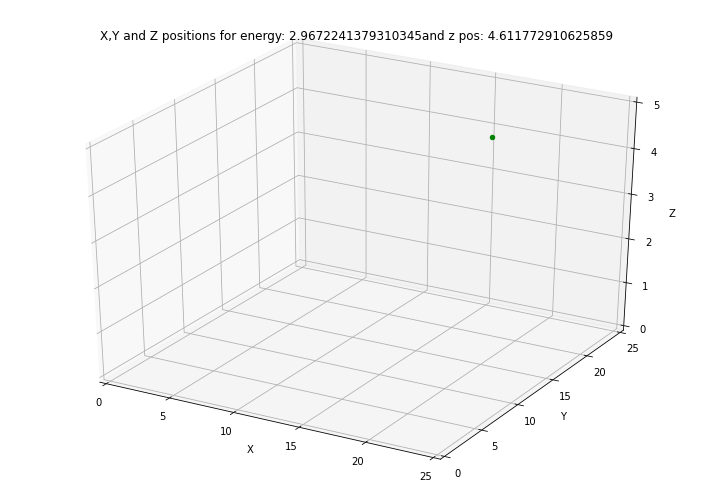

event number= 592


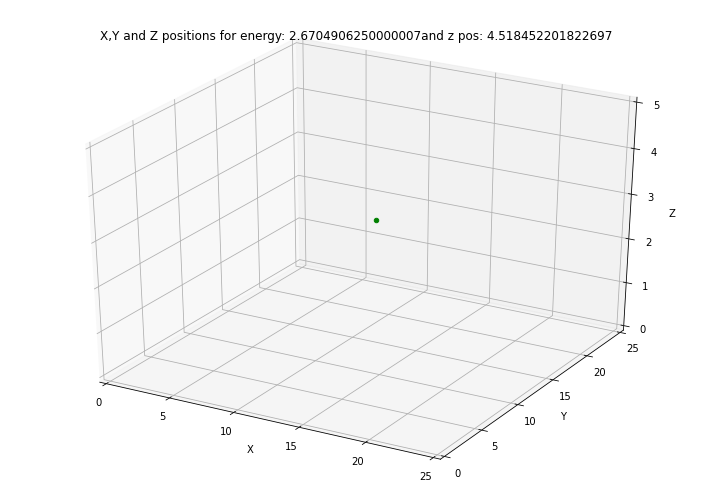

event number= 593


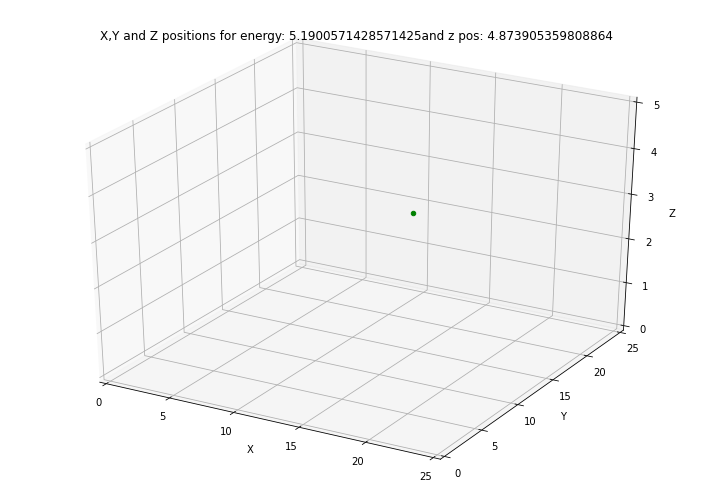

event number= 594


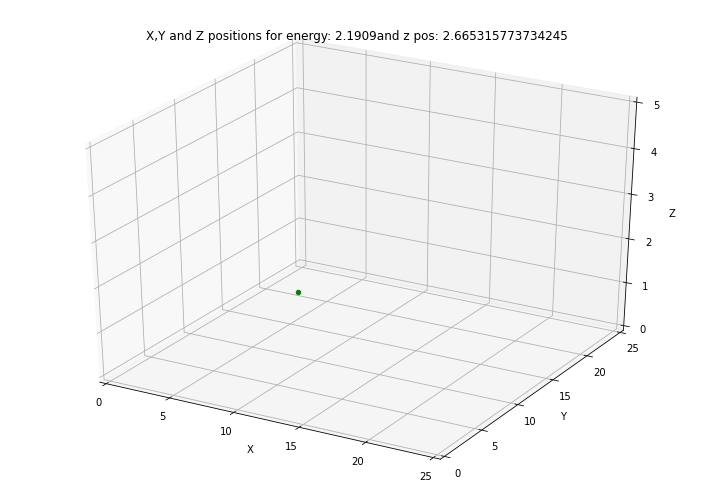

event number= 595


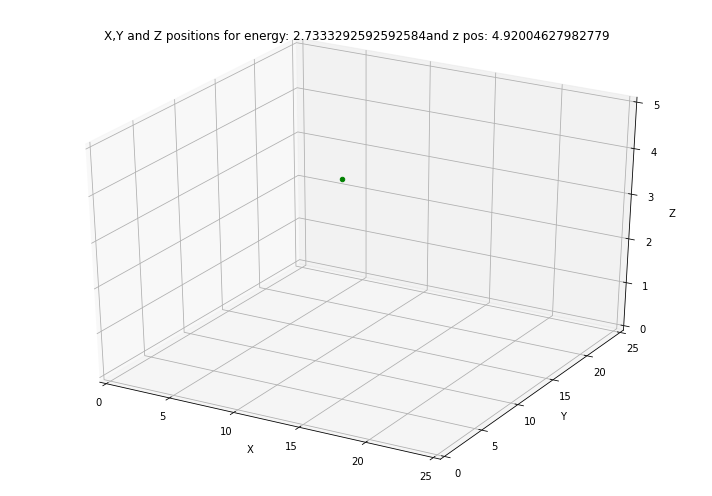

event number= 596


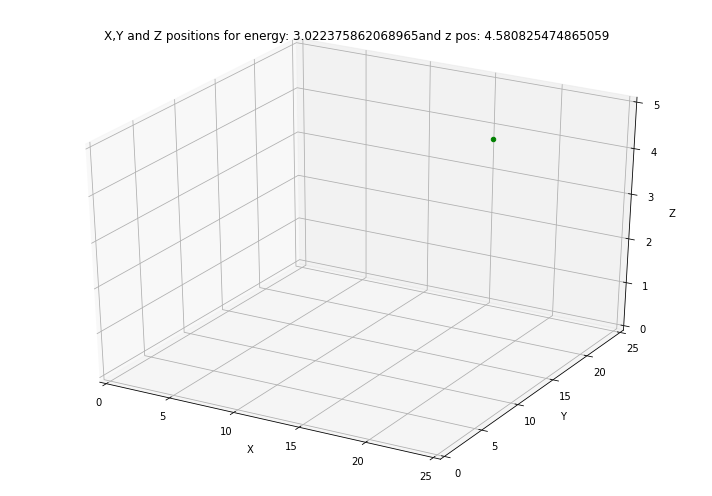

event number= 597


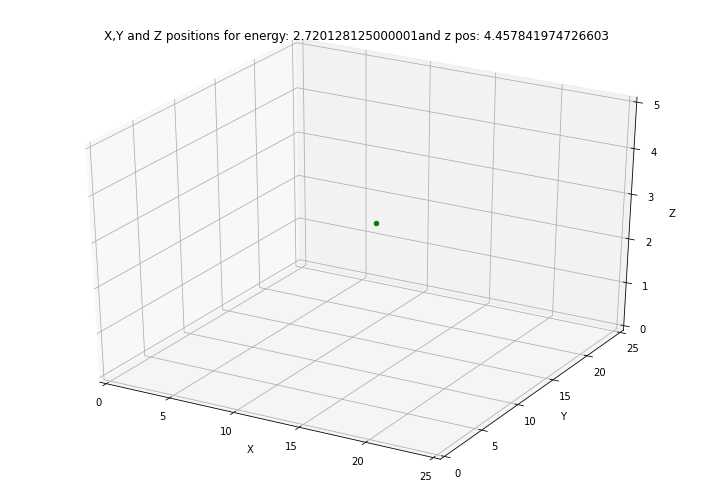

event number= 598


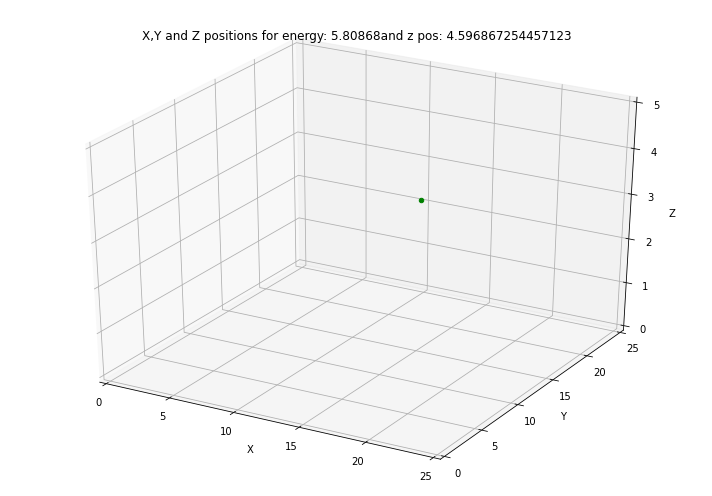

event number= 599


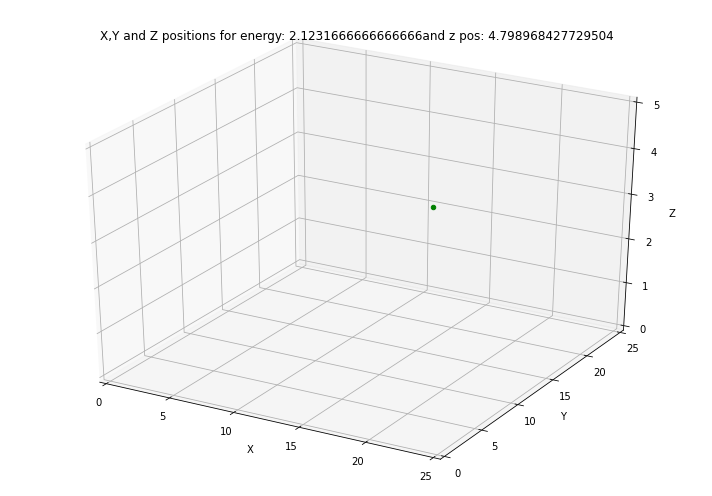

event number= 600


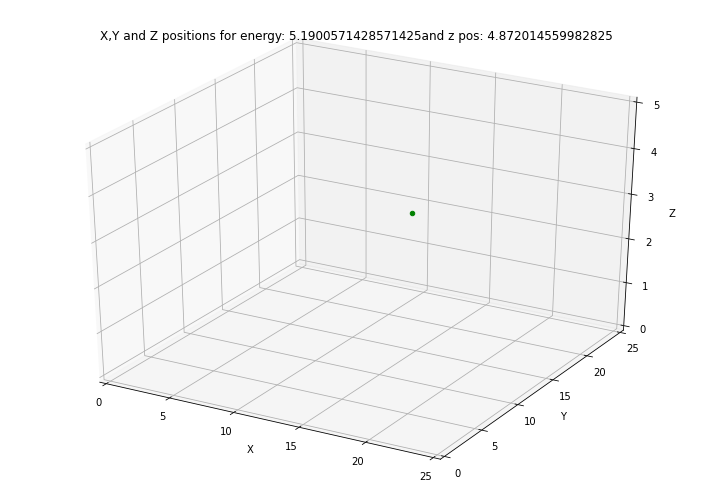

In [ ]:
event_n=500
temp_x=[]
temp_y=[]
temp_z=[]
temp_energy=[]

for i in range(len(mean_xpos_list)):

  if event_n > 600:
    break


  print( "event number=",event_n)
  #print("With energy colored:")
  #plt.rcParams["figure.figsize"] = [7.00, 3.50]
  #plt.rcParams["figure.autolayout"] = True
  #fig = plt.figure()
  #ax = fig.add_subplot(111, projection='3d')
  #img = ax.scatter(mean_xpos_list[i], mean_ypos_list[i], mean_zpos_list[i], c=mean_energy_list[i], cmap='gist_heat', alpha=1)
  #plt.show()

  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(mean_xpos_list[i][1], mean_ypos_list[i][1], mean_zpos_list[i][1], color = "green")
  title_name = "X,Y and Z positions for energy: " + str(mean_energy_list[i][1]) + "and z pos: " + str(mean_zpos_list[i][1])
  plt.title(title_name)

  ax.set_xlabel('X')
  ax.set_ylabel('Y')
  ax.set_zlabel('Z')

  ax.set_xlim3d(0,25)
  ax.set_ylim3d(0,25)
  ax.set_zlim3d(0,5)

  plt.show()


  event_n+=1



/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)
No handles with labels found to put in legend.


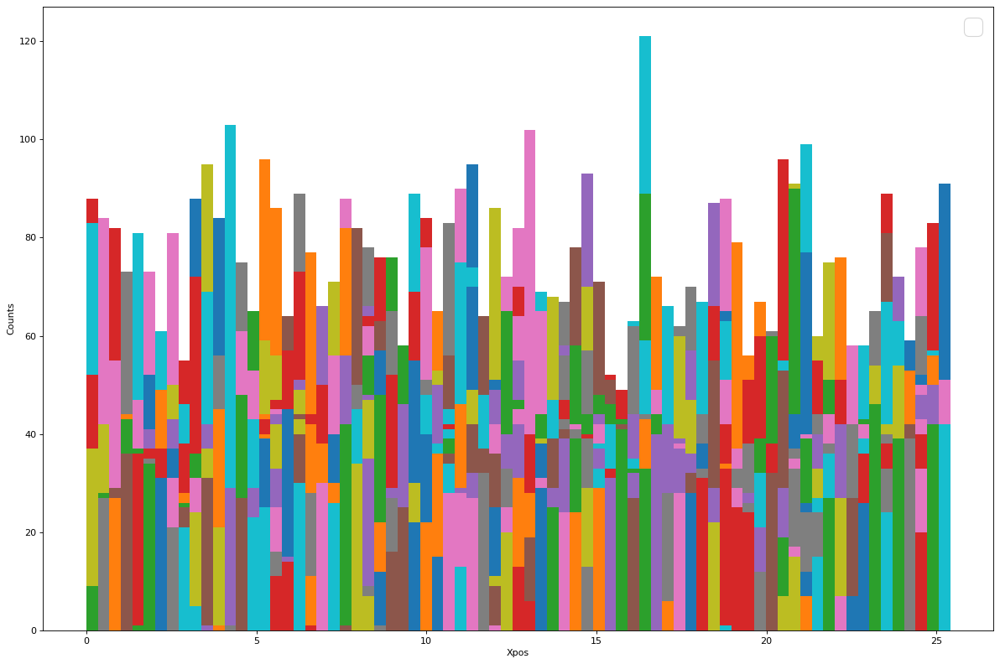

In [56]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(mean_xpos_list_1,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


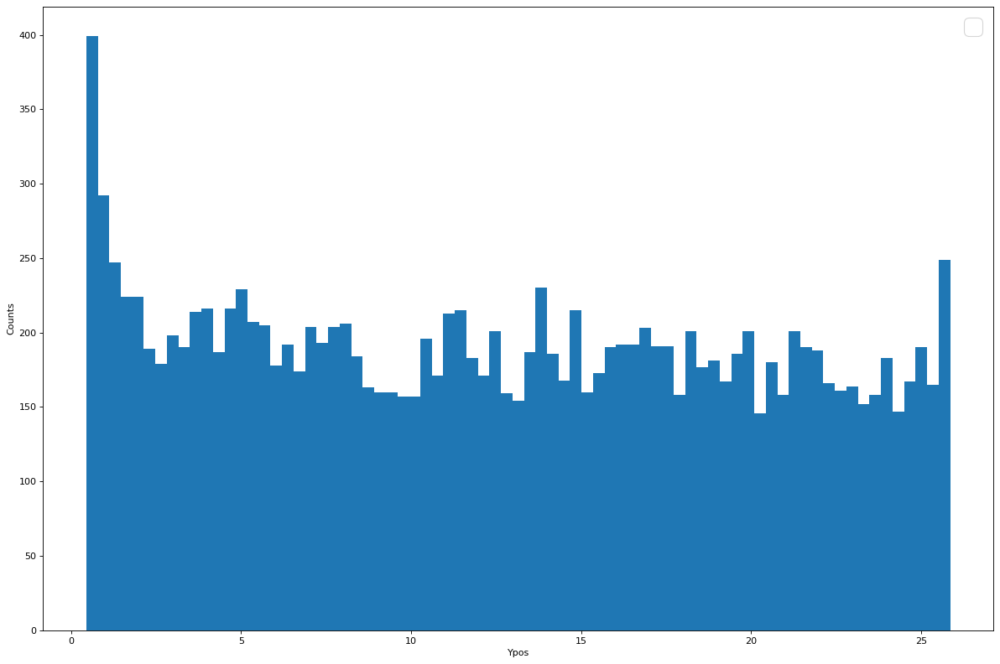

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(mean_ypos_list_1,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


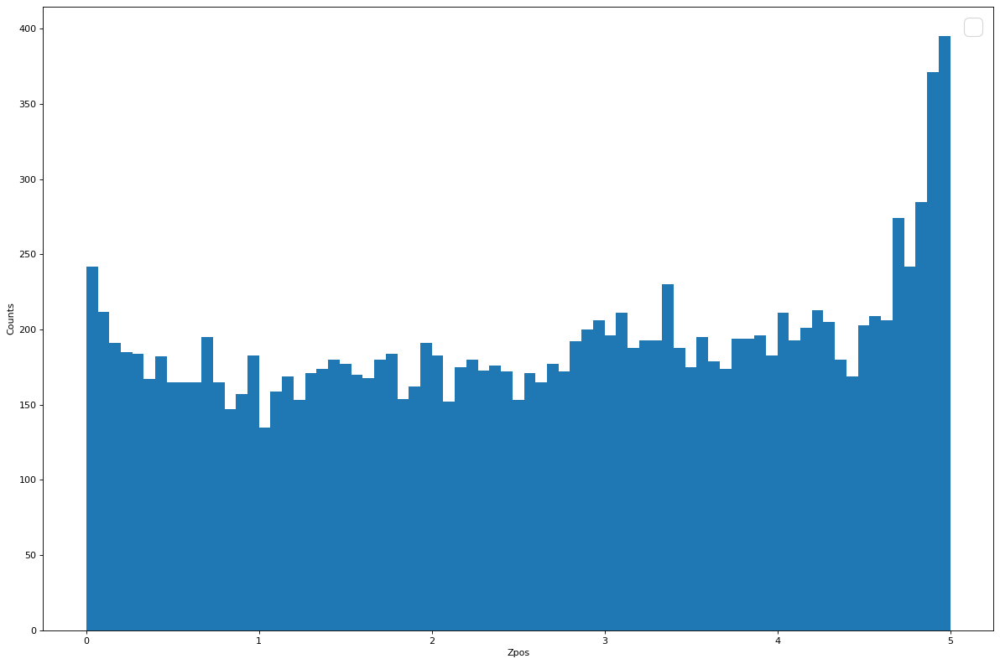

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(mean_zpos_list_1,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


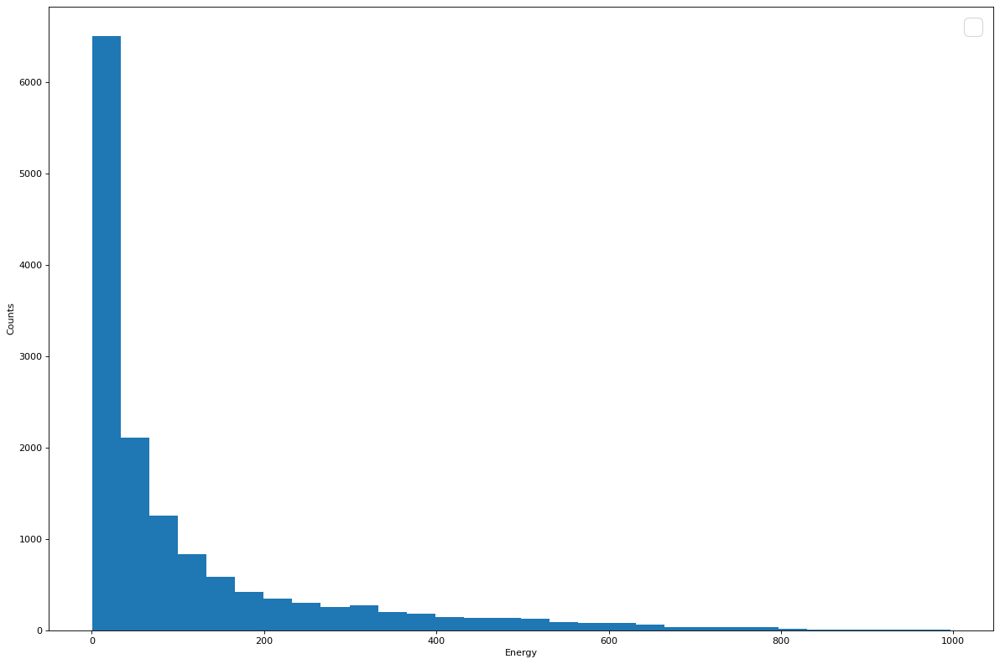

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(mean_energy_list_1,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


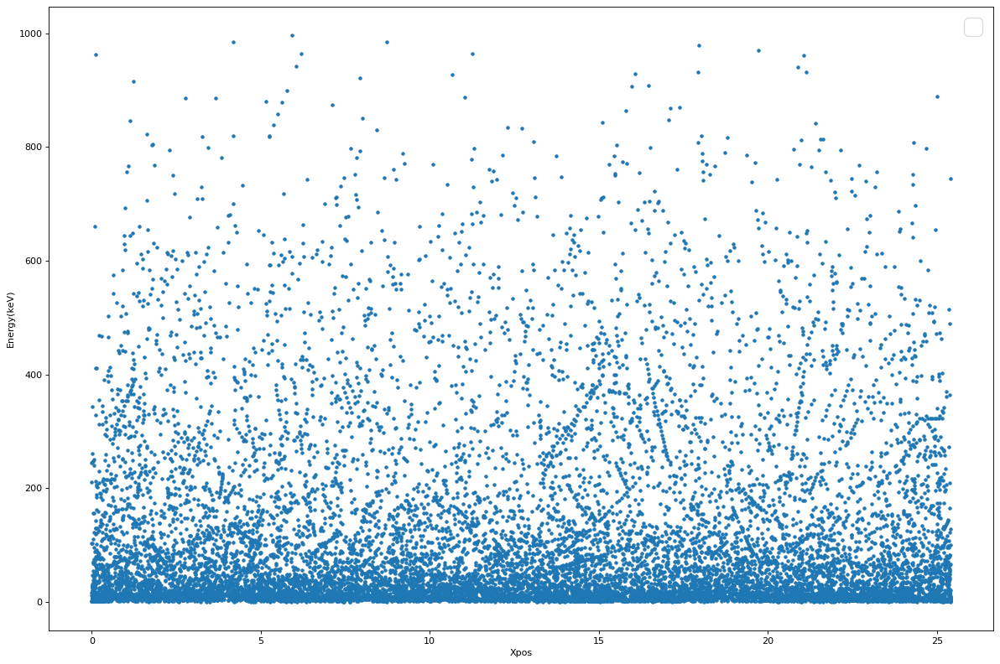

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(mean_xpos_list_1, mean_energy_list,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


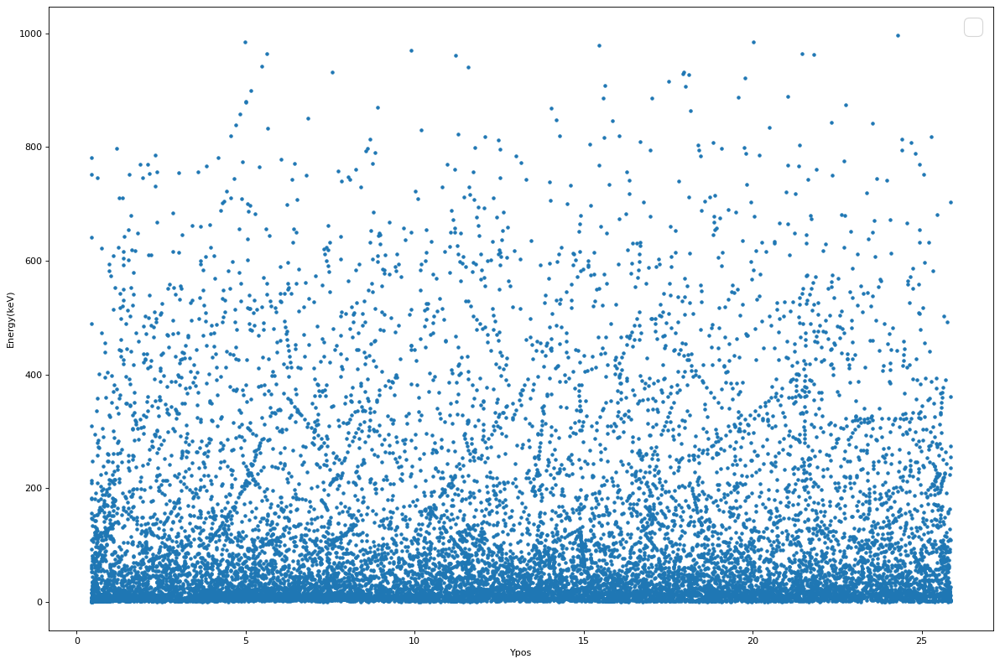

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(mean_ypos_list_1, mean_energy_list,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


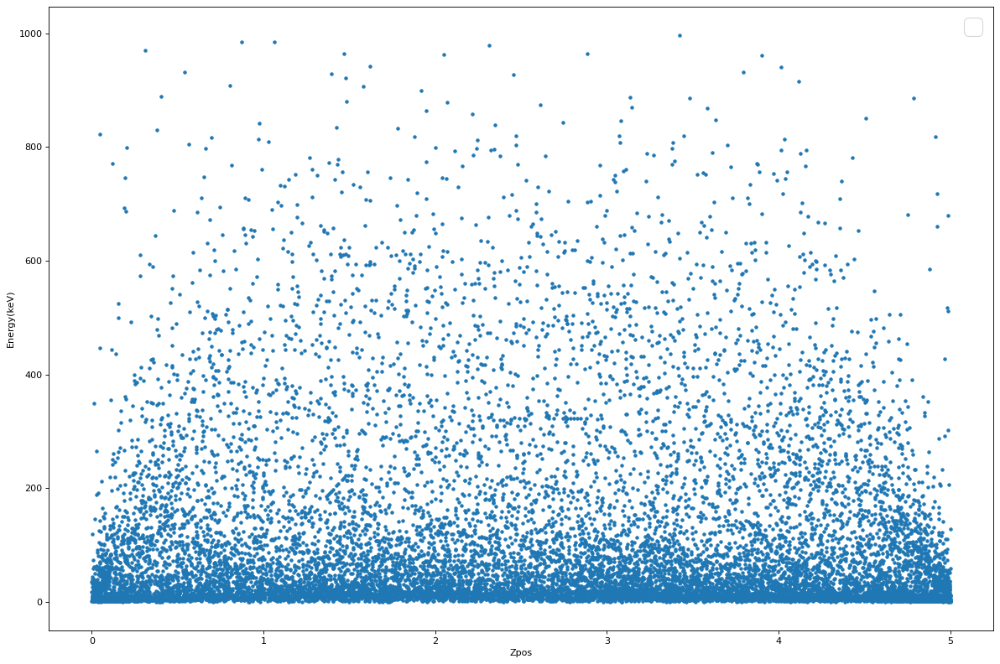

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(mean_zpos_list_1, mean_energy_list,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

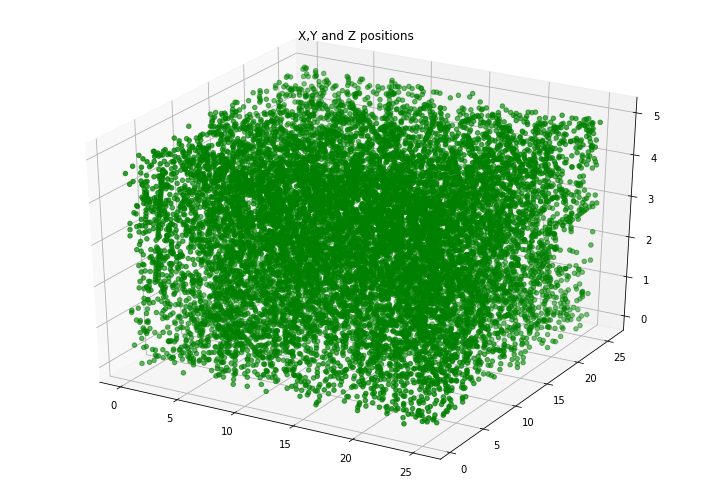

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(mean_xpos_list_1, mean_ypos_list_1, mean_zpos_list_1, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

In [ ]:
a=0
b=1000

for i in range(10):
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(mean_xpos_list_1[a:b], mean_ypos_list_1[a:b], mean_zpos_list_1[a:b], color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

  a+=1000
  b+=1000

Output hidden; open in https://colab.research.google.com to view.

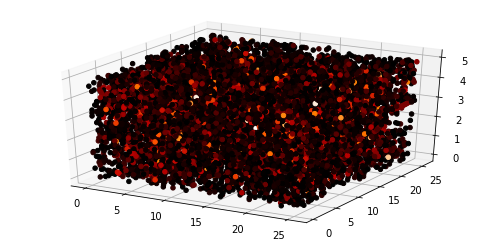

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(mean_xpos_list_1, mean_ypos_list_1, mean_zpos_list_1, c=mean_energy_list_1, cmap='gist_heat', alpha=1)
plt.show()

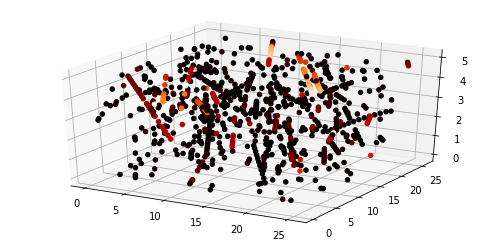

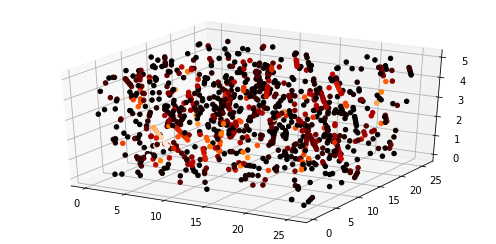

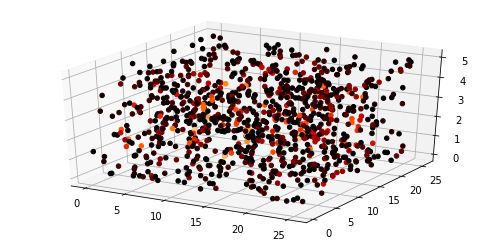

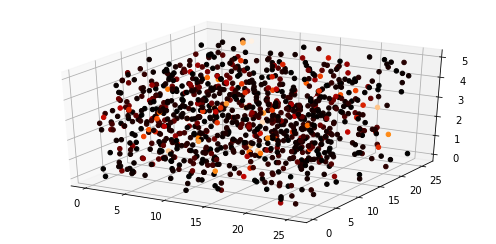

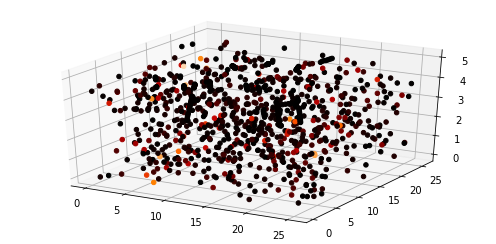

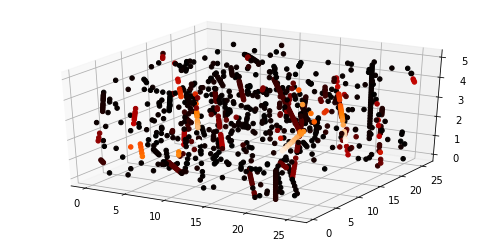

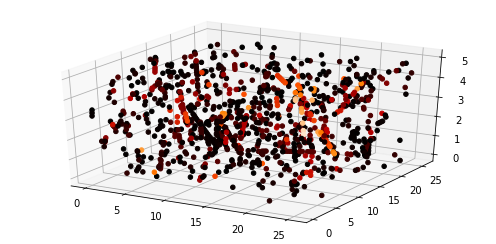

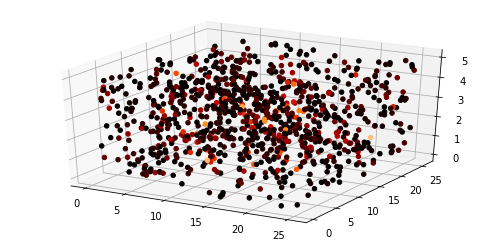

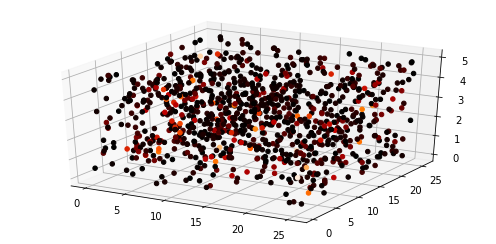

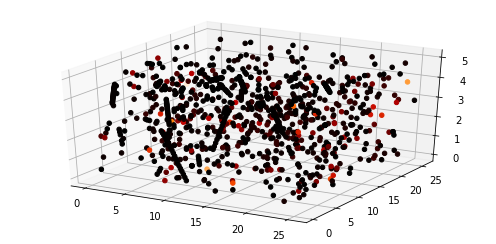

In [ ]:
a=0
b=1000

for i in range(10):
  plt.rcParams["figure.figsize"] = [7.00, 3.50]
  plt.rcParams["figure.autolayout"] = True

  fig = plt.figure()
  ax = fig.add_subplot(111, projection='3d')


  img = ax.scatter(mean_xpos_list_1[a:b], mean_ypos_list_1[a:b], mean_zpos_list_1[a:b], c=mean_energy_list_1[a:b], cmap='gist_heat', alpha=1)
  plt.show()

  a+=1000
  b+=1000

# ENERGY BOUNDED GRAPHS


## First e cloud

### 20-250

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >20 and first_energy_list[i]<250:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


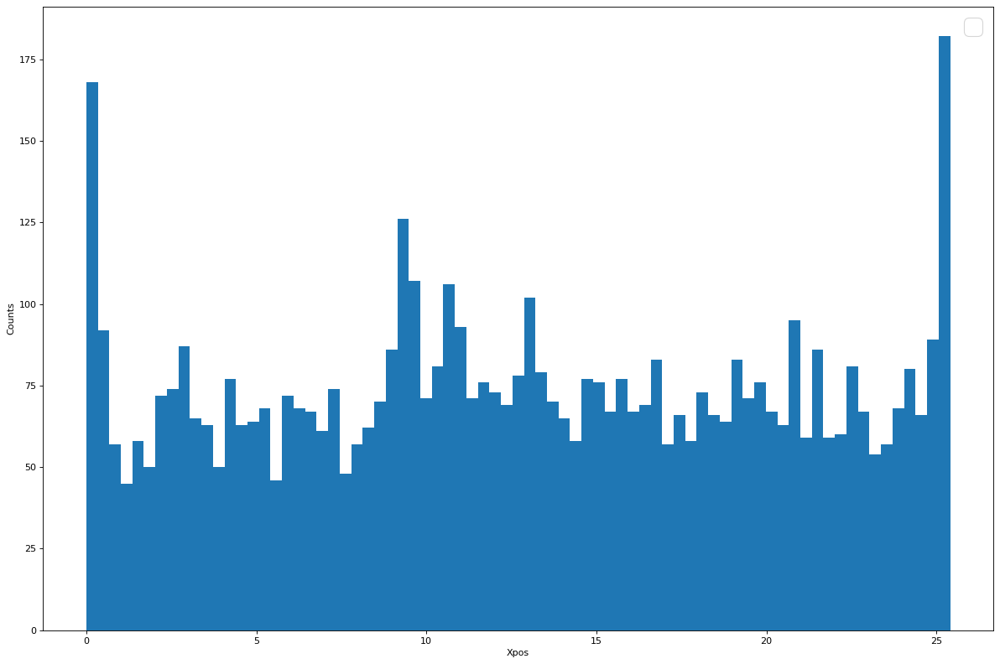

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


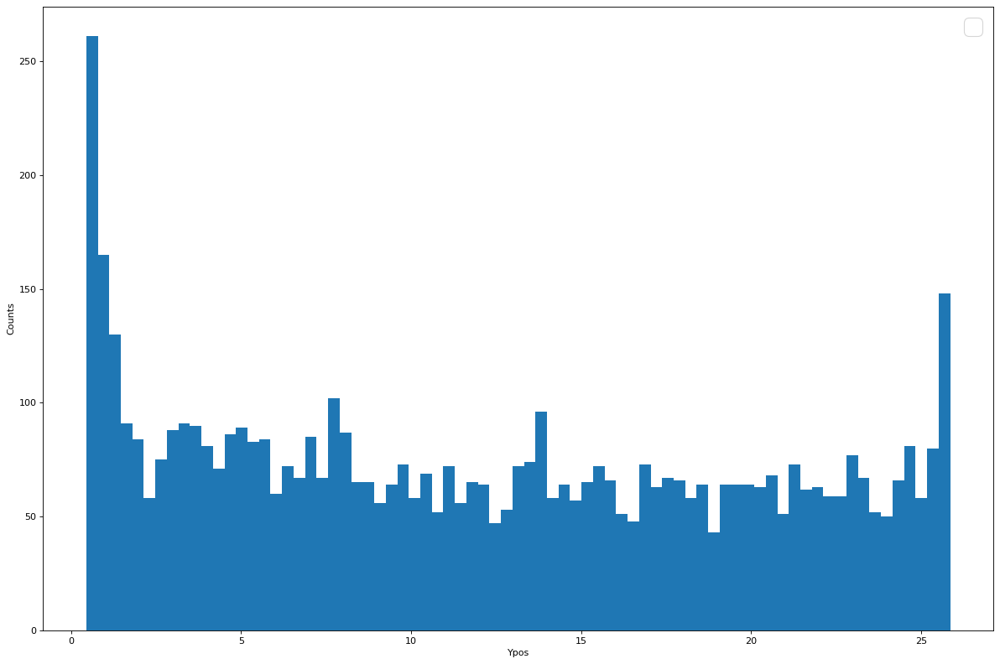

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


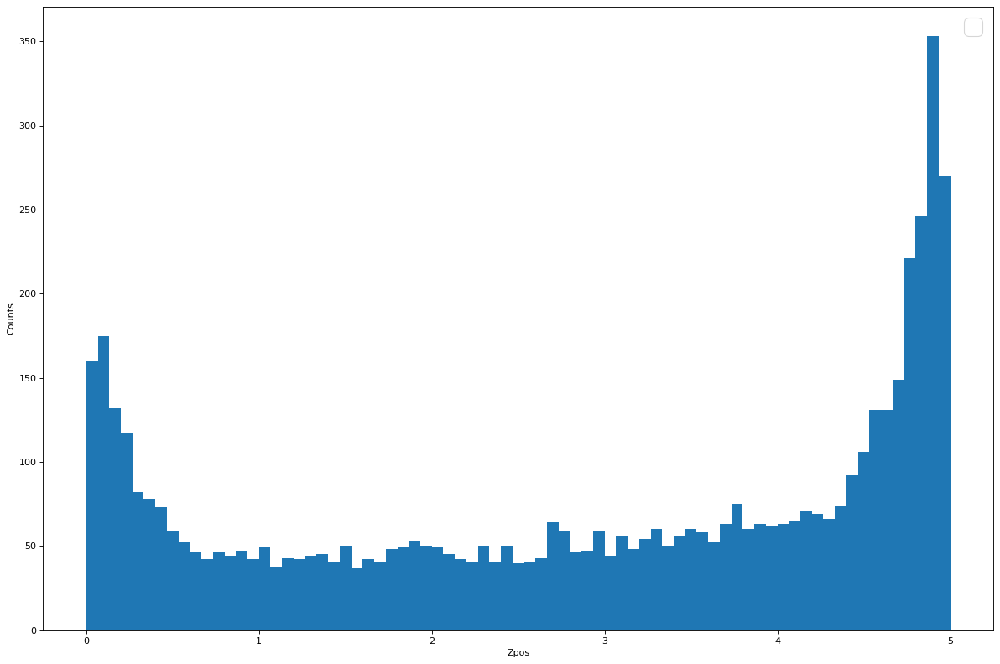

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


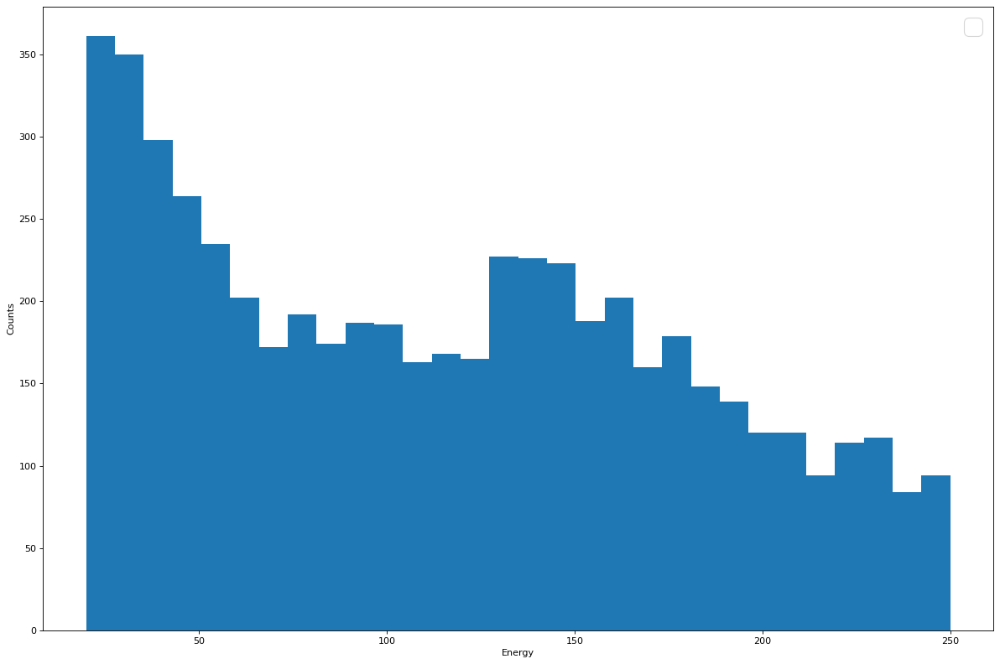

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


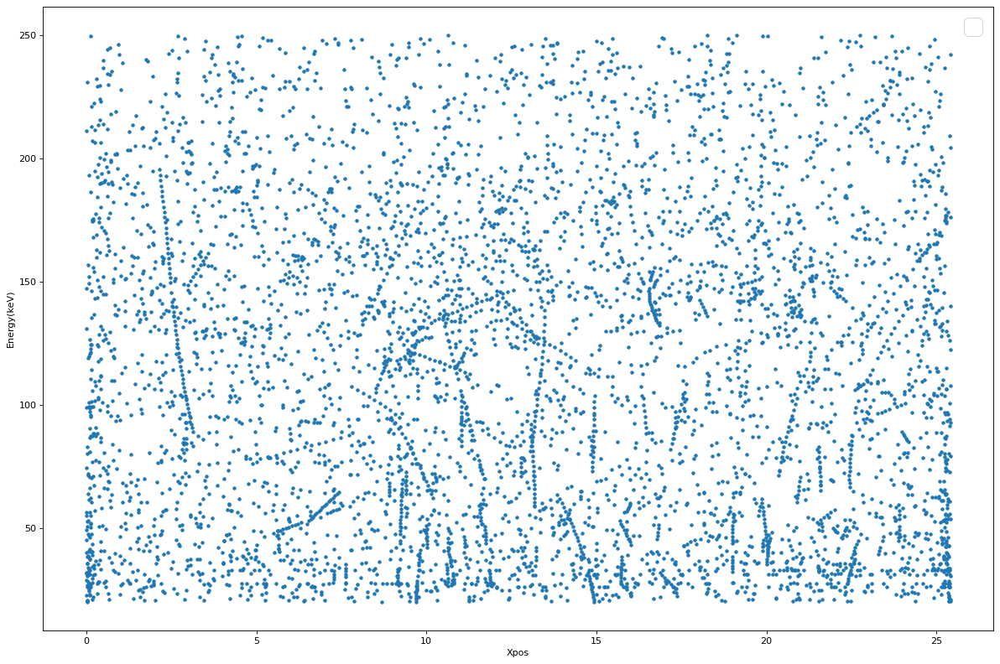

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


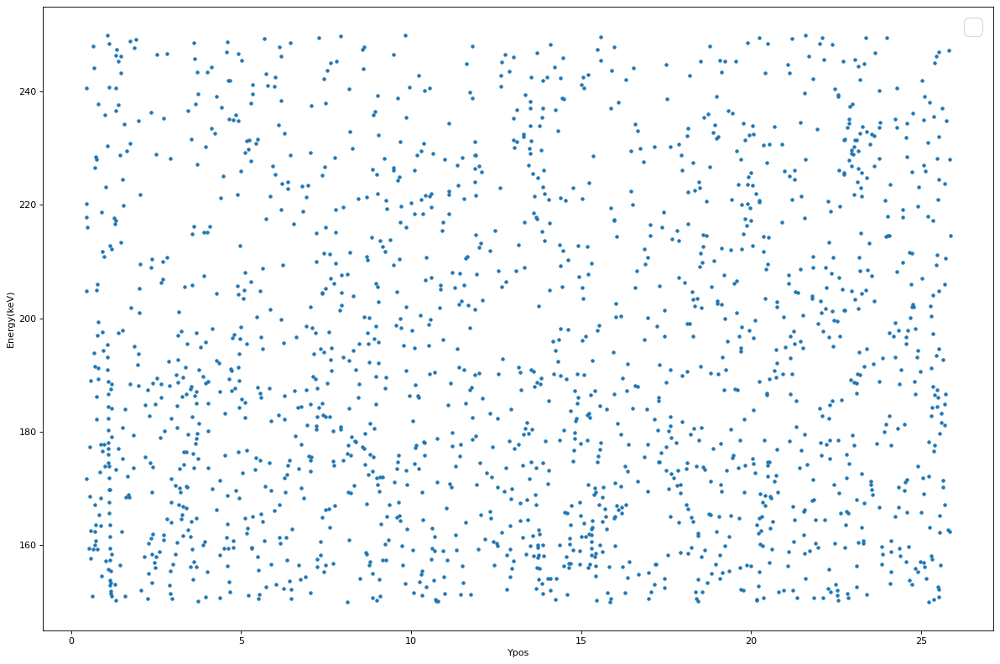

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


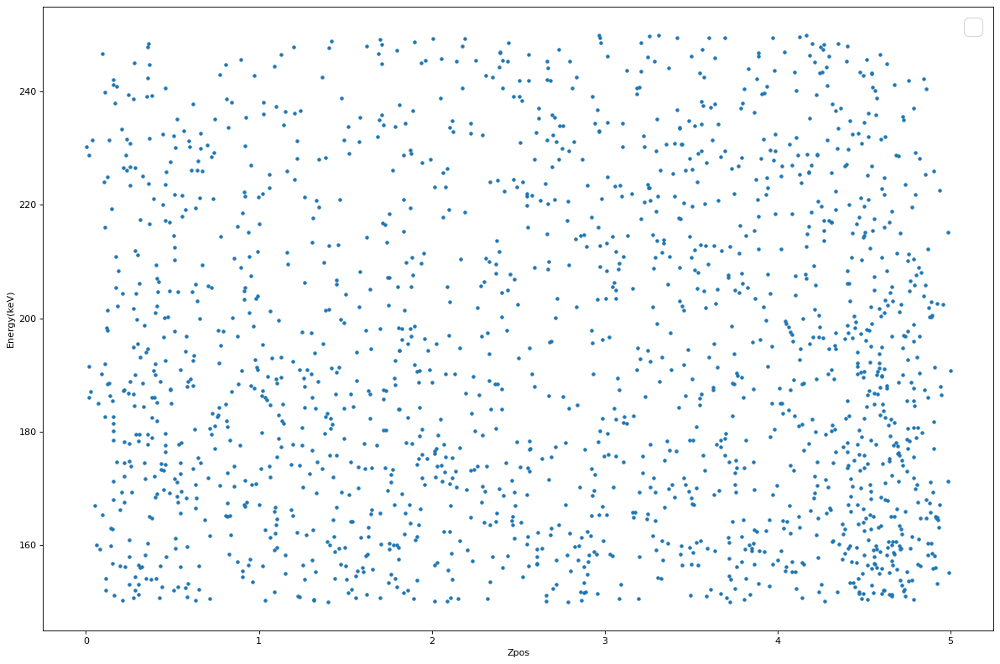

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

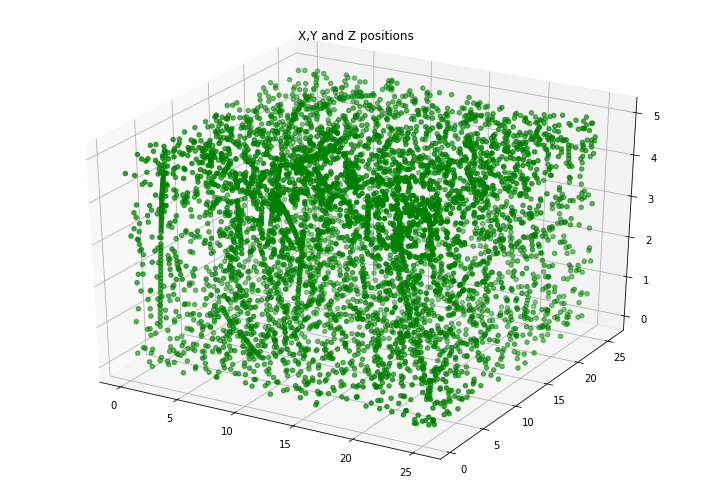

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

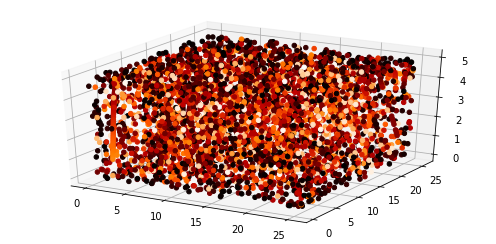

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 20-80

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >20 and first_energy_list[i]<80:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


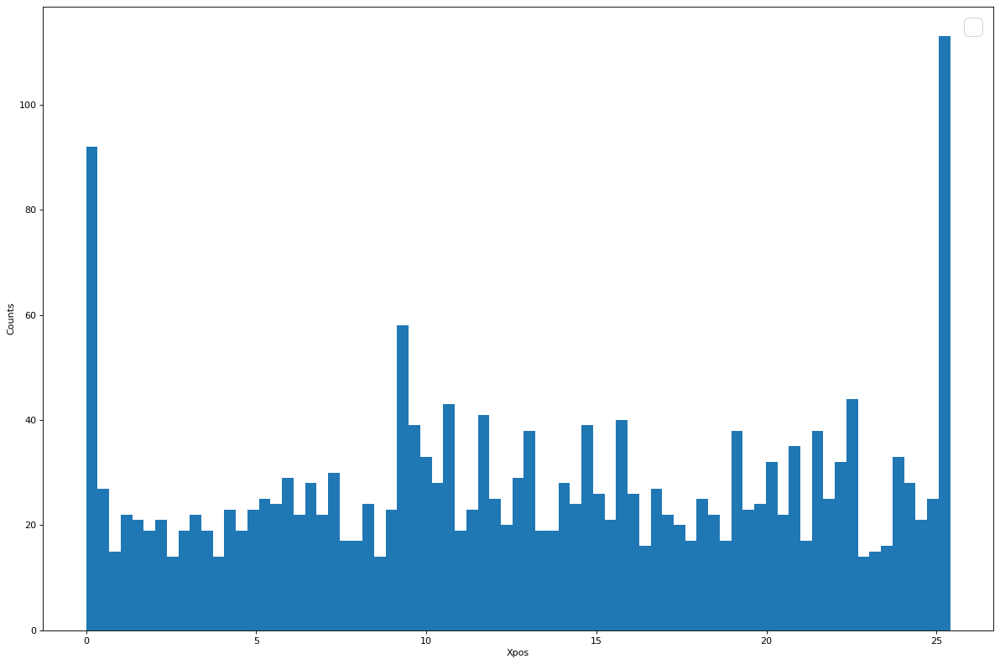

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


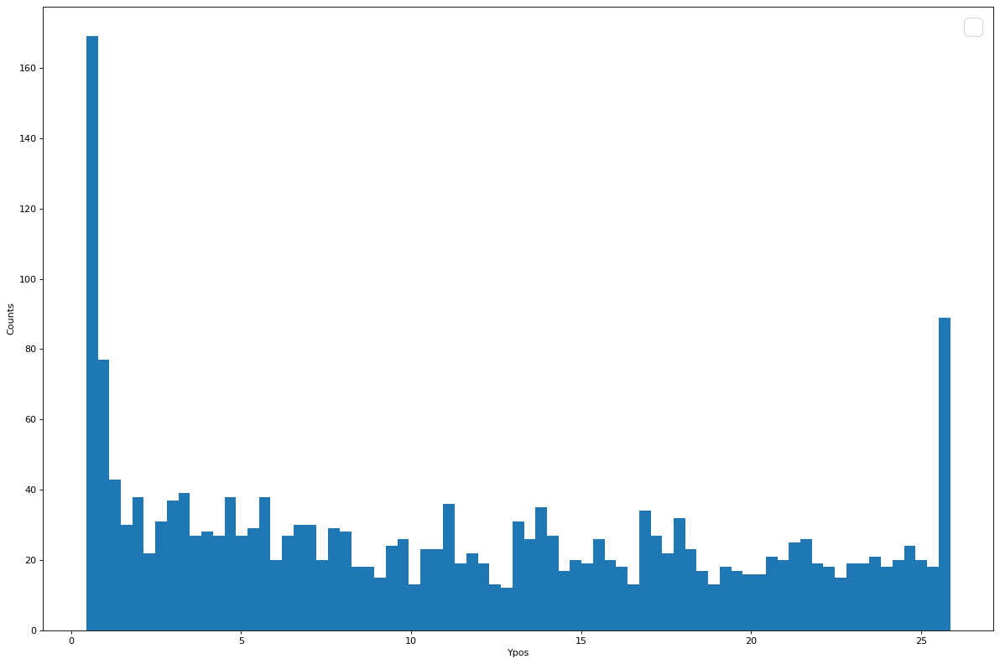

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


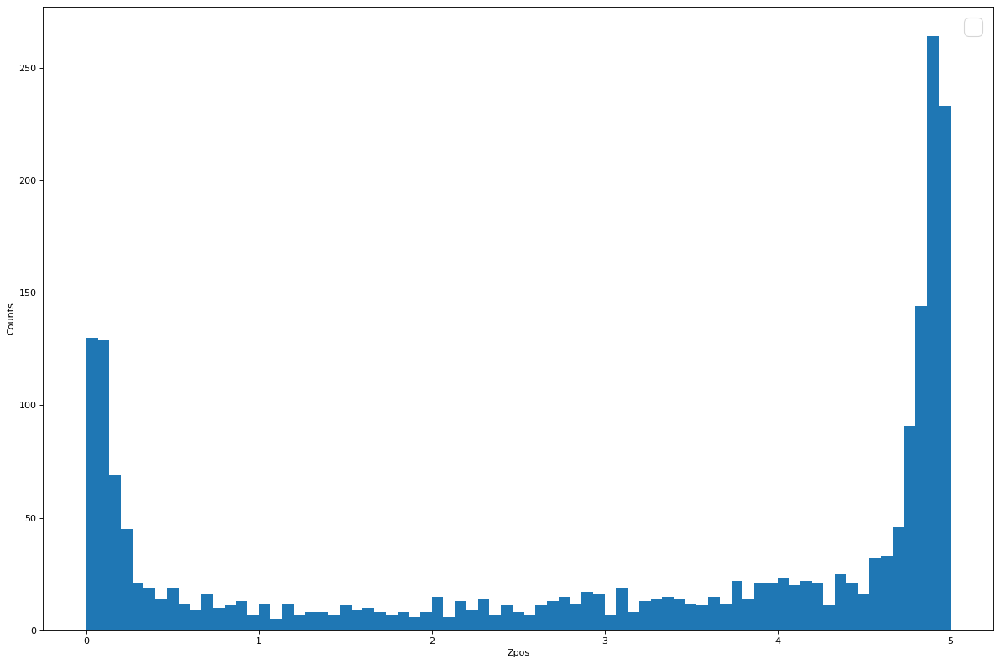

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


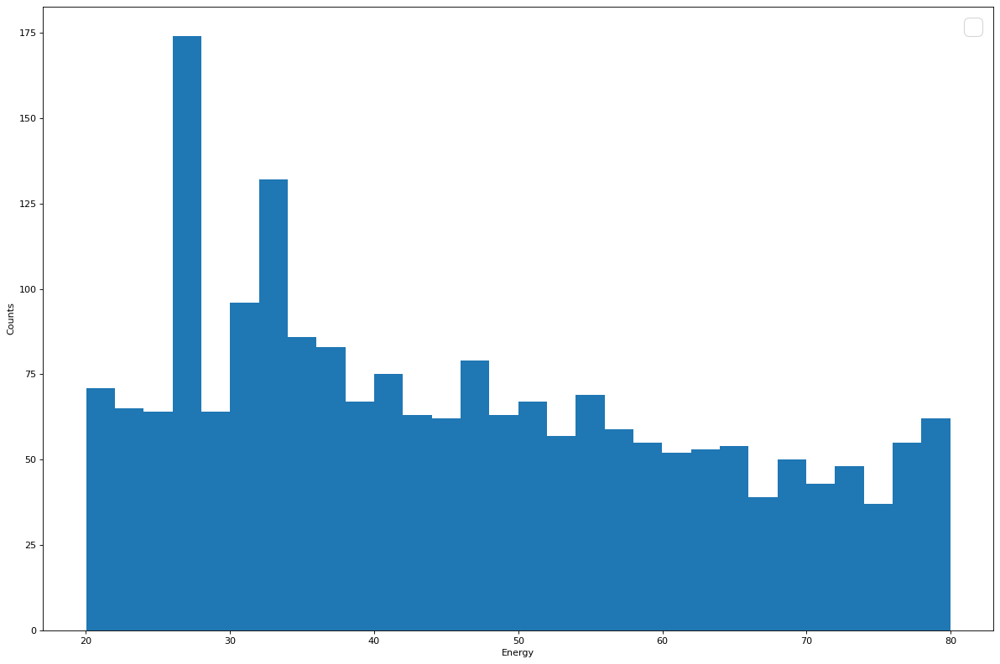

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


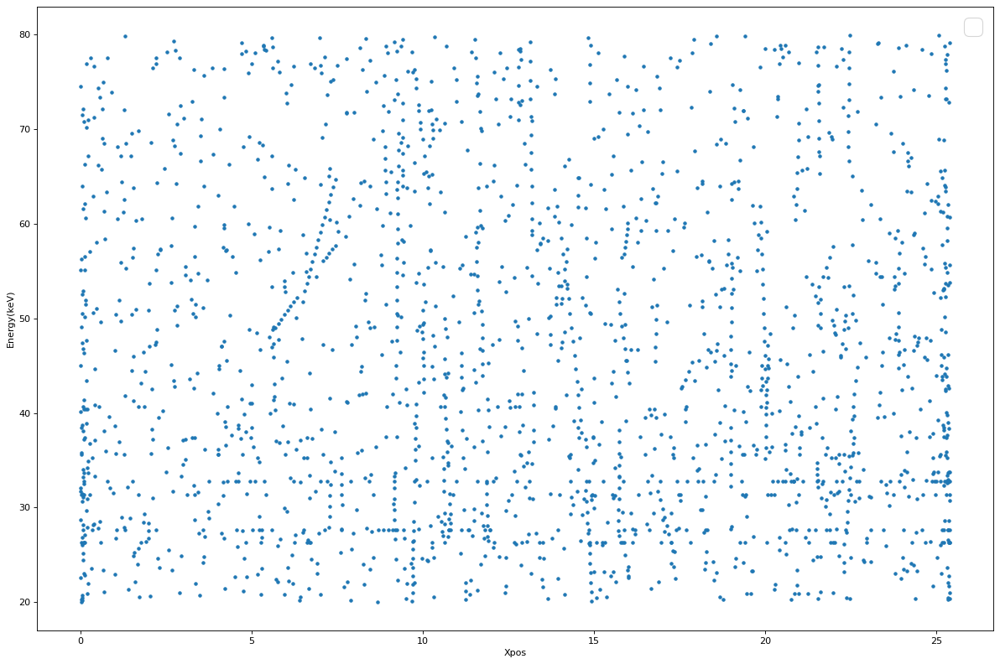

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


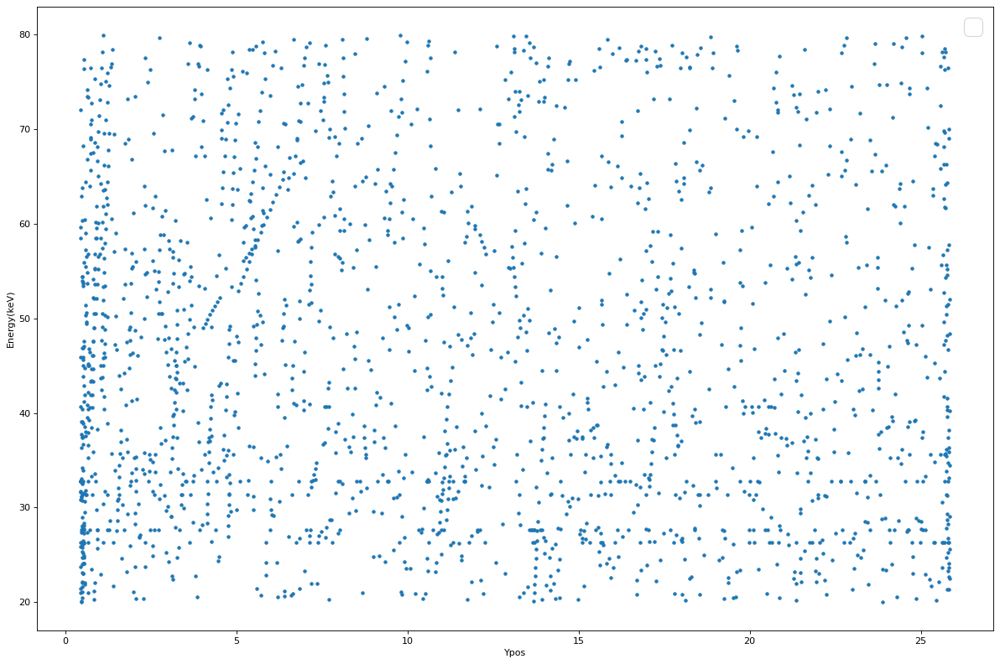

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


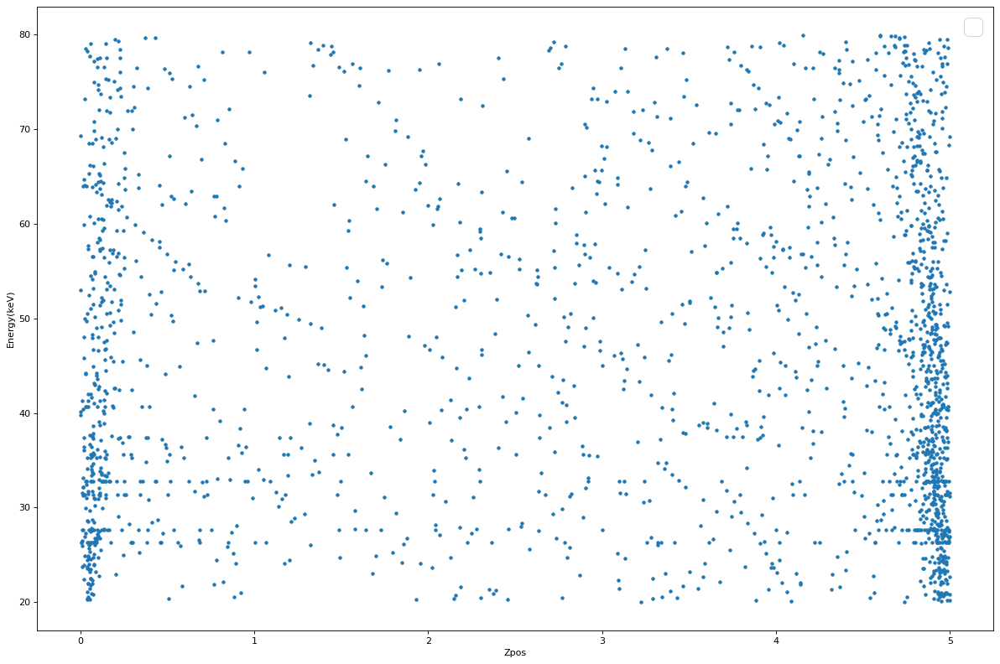

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

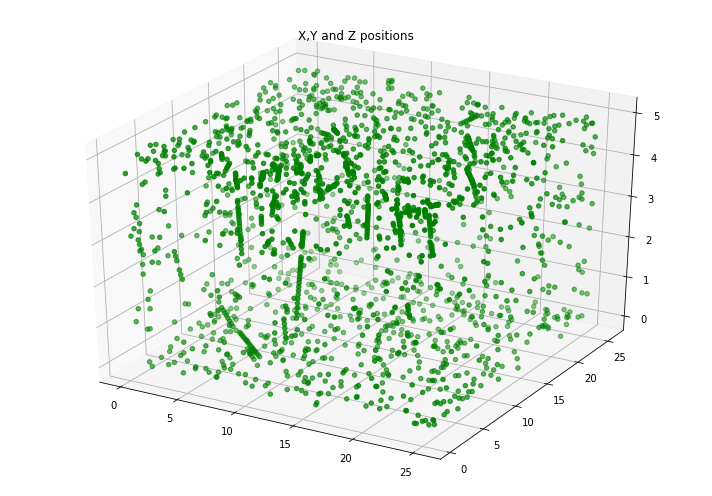

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

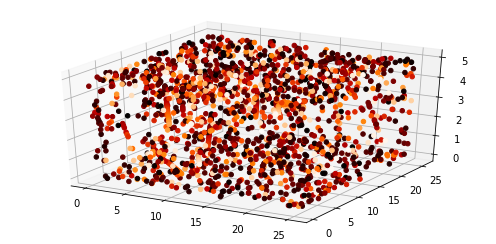

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 40-60

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >40 and first_energy_list[i]<60:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


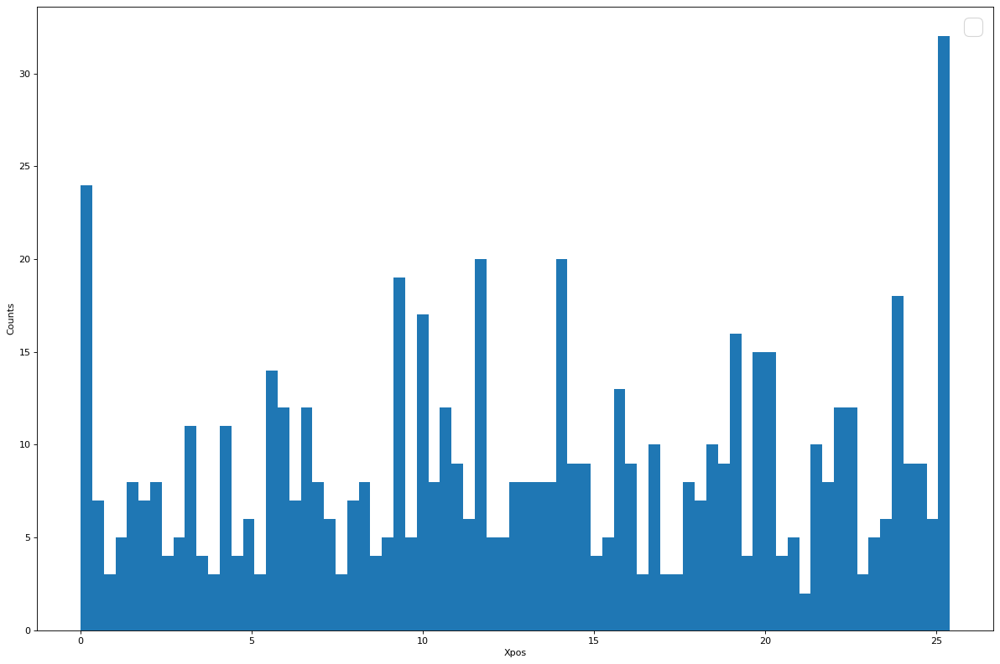

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


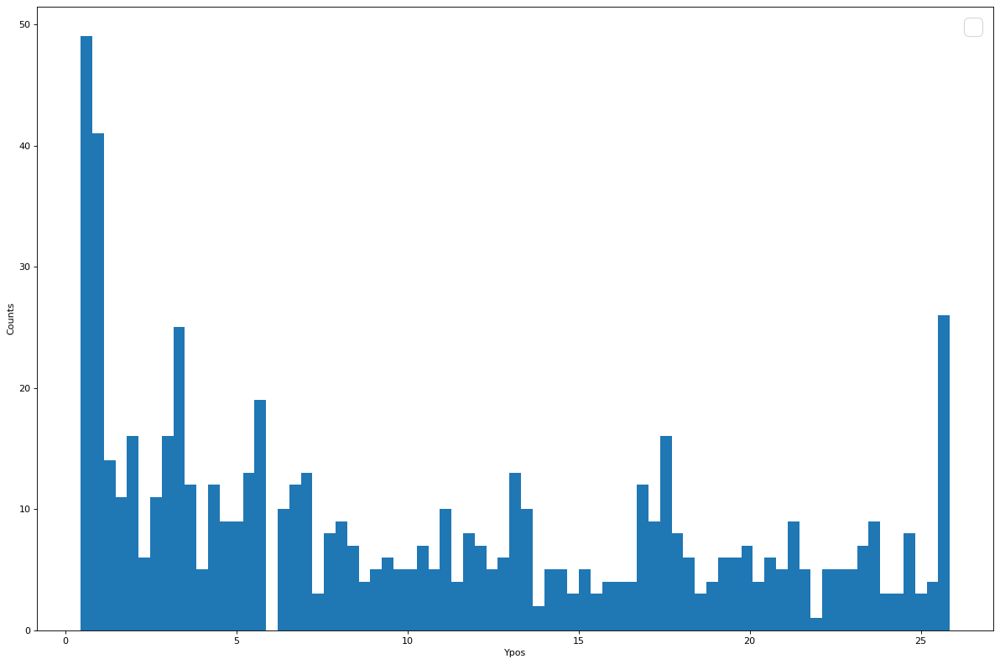

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


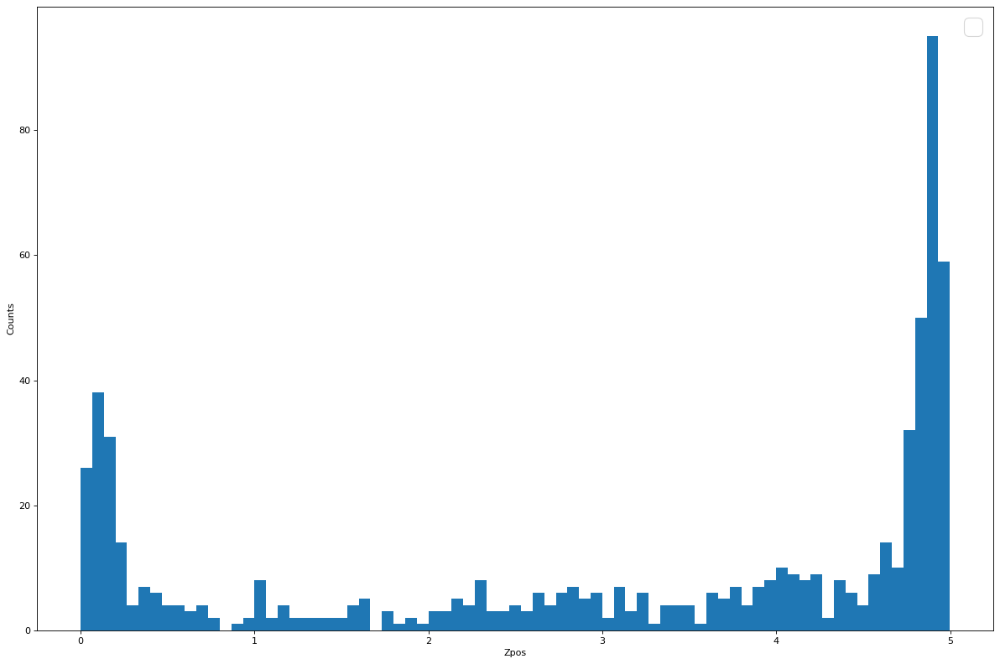

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


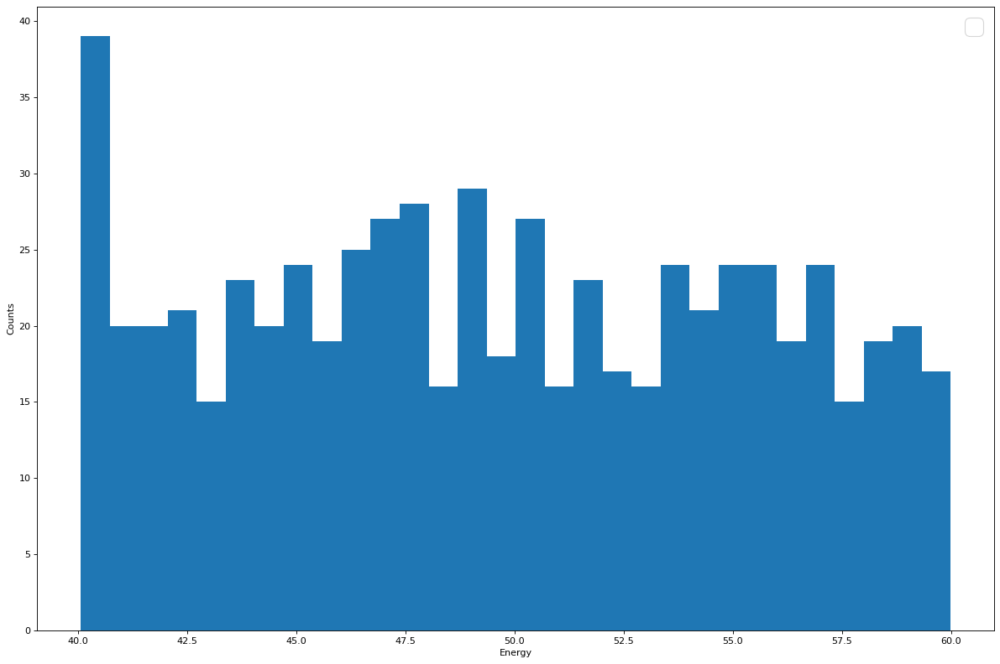

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


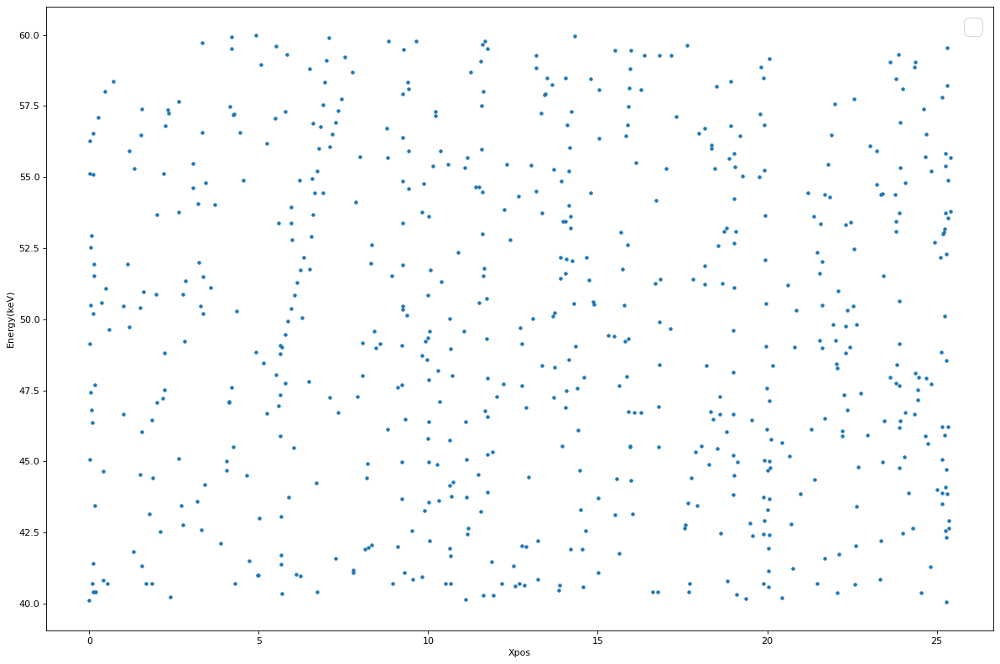

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


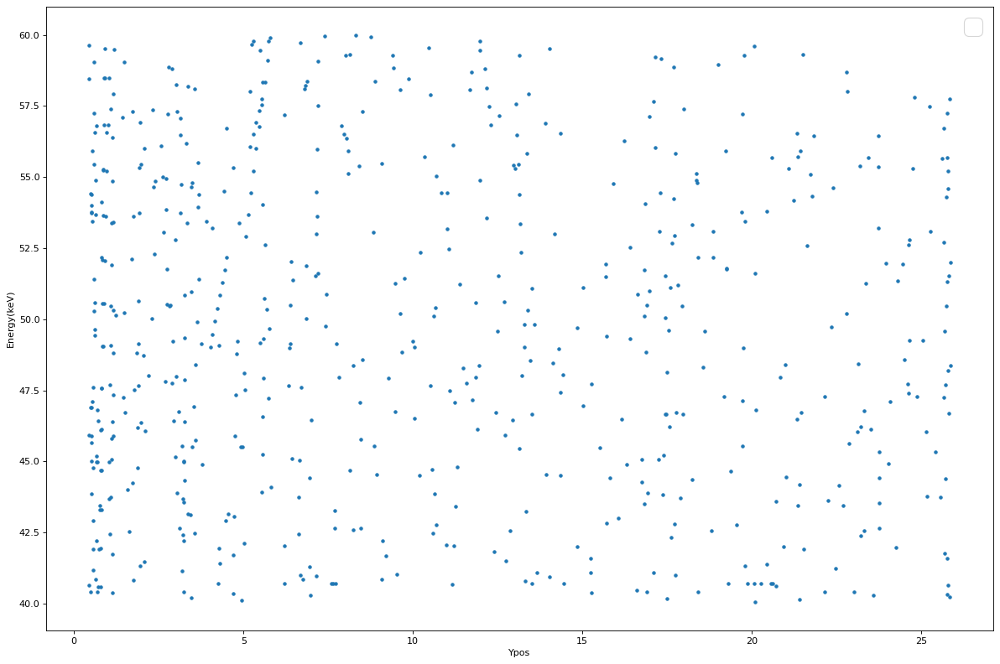

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


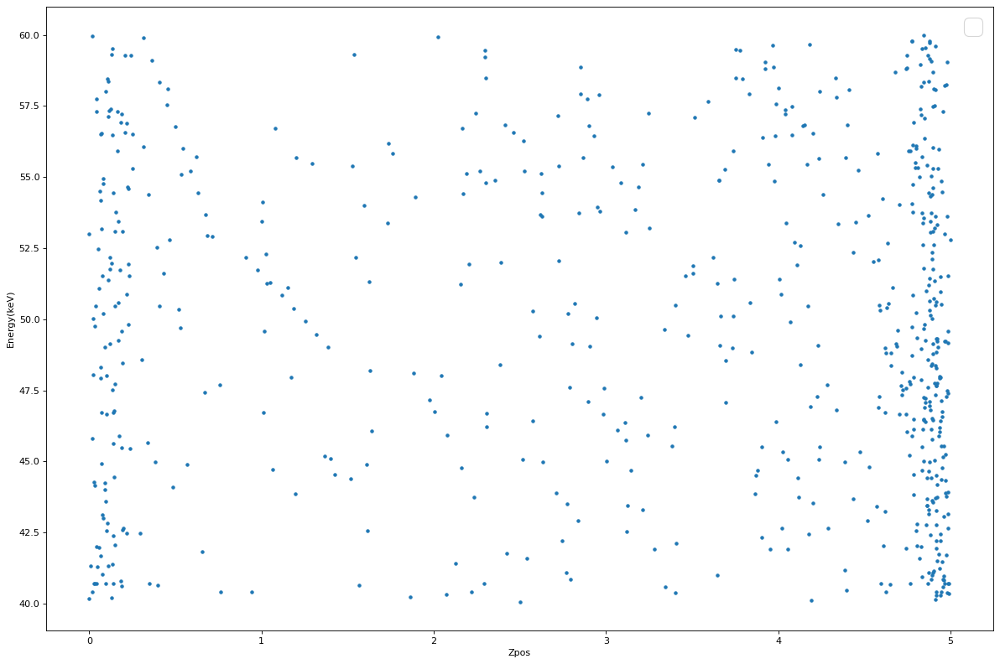

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

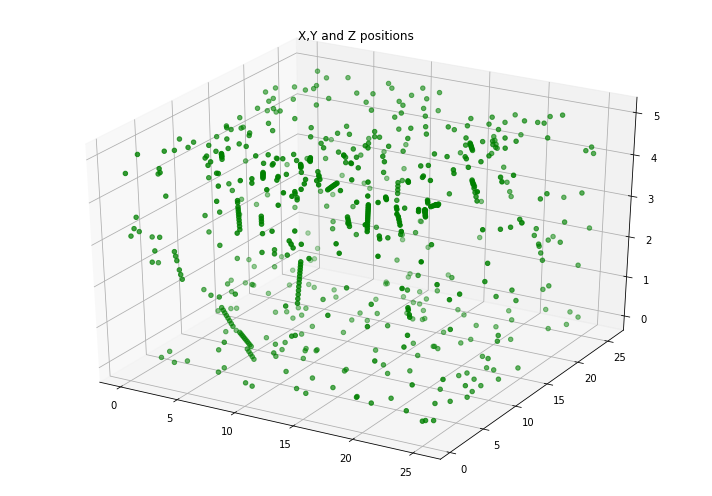

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

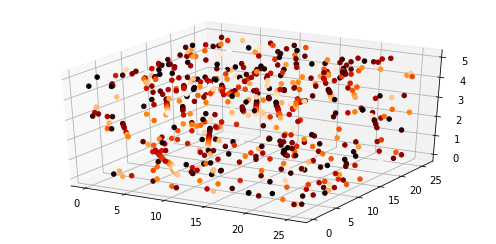

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 60-80

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >60 and first_energy_list[i]<80:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


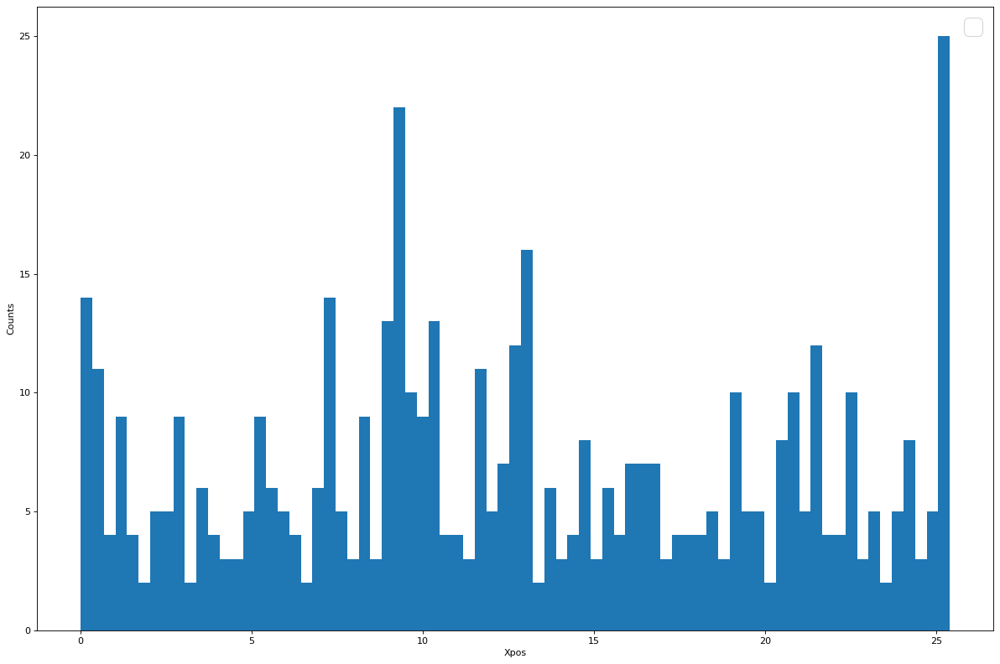

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


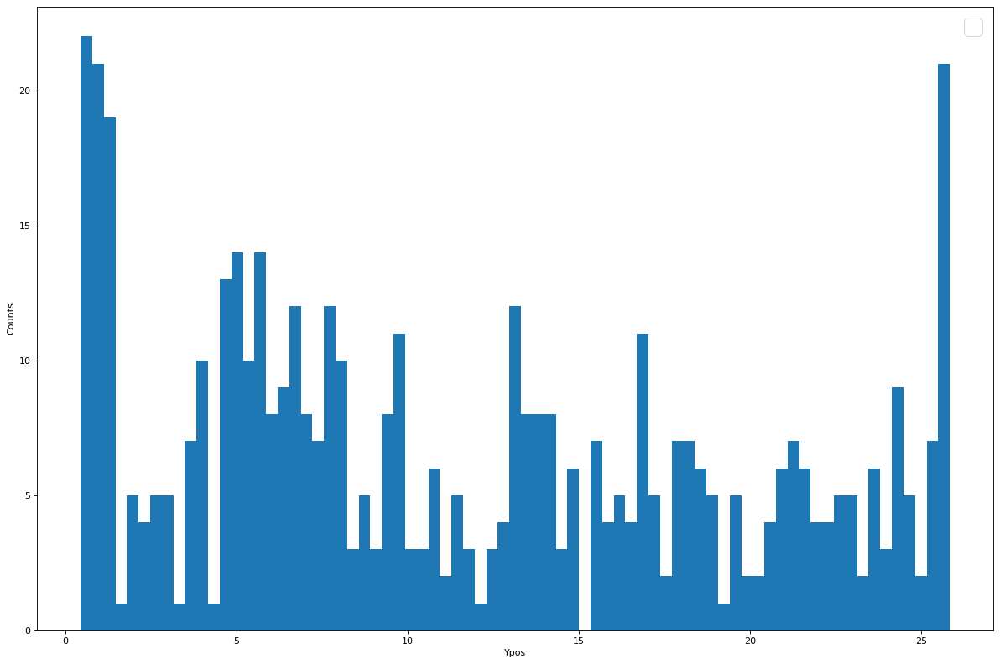

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


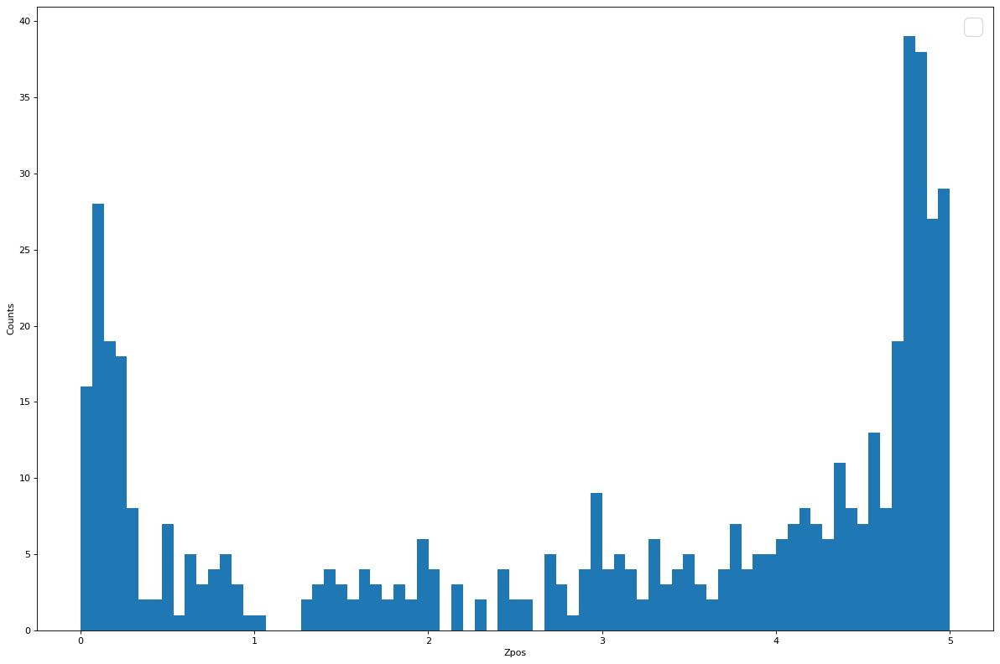

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


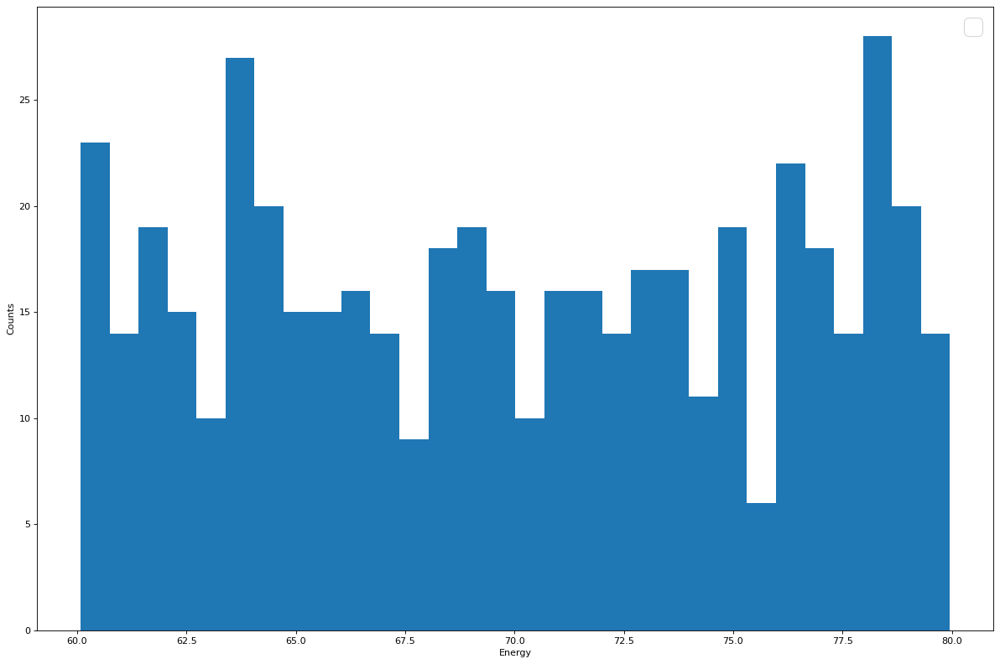

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


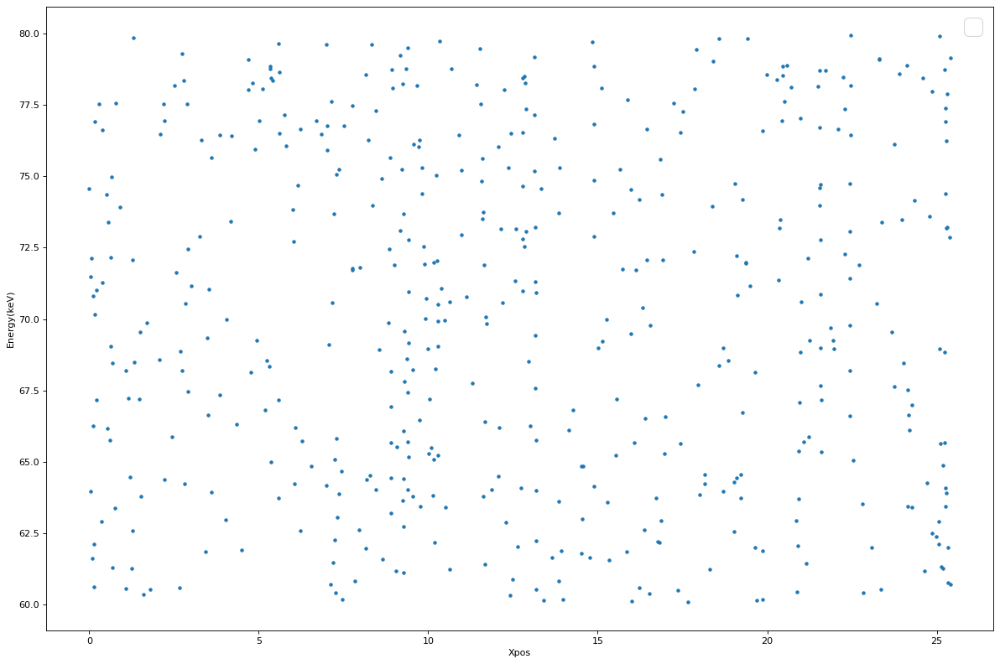

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


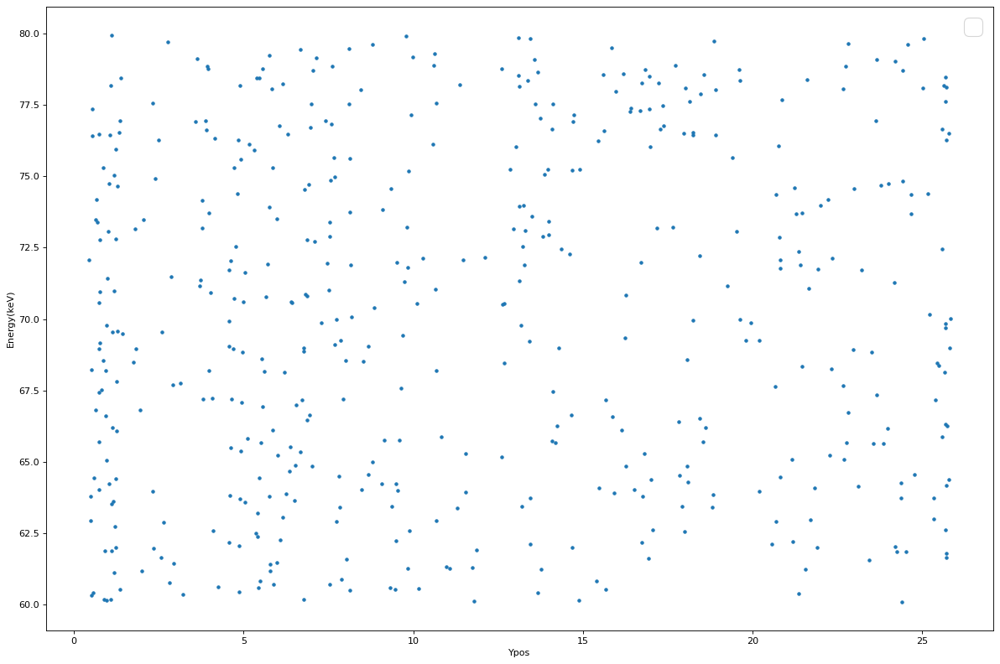

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


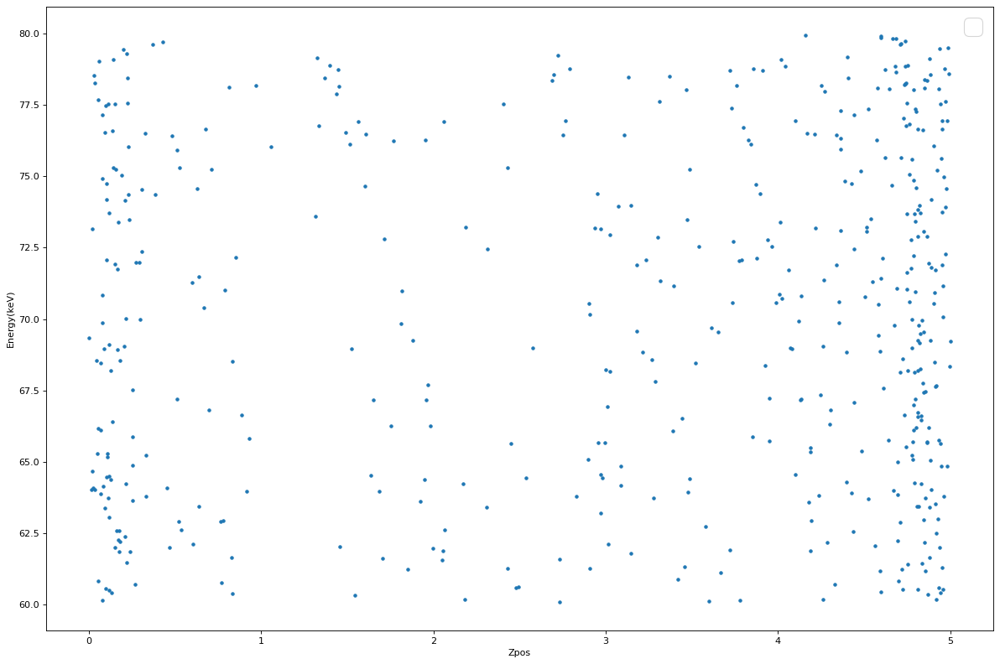

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

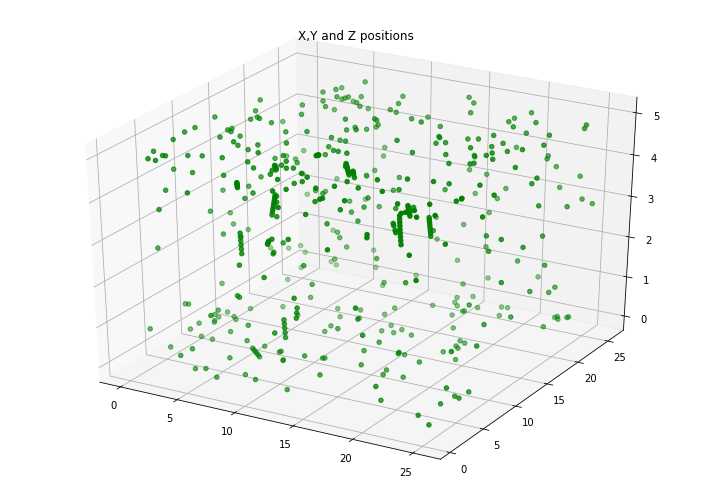

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

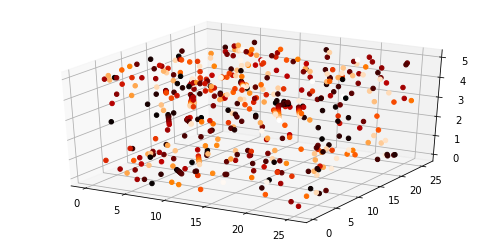

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 80-100

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >80 and first_energy_list[i]<100:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


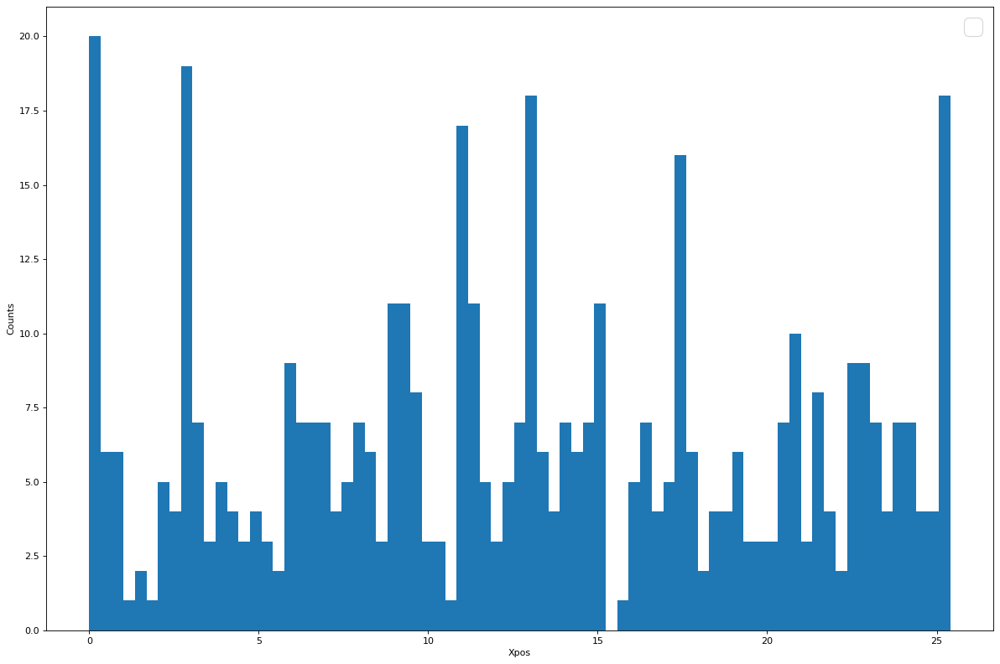

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


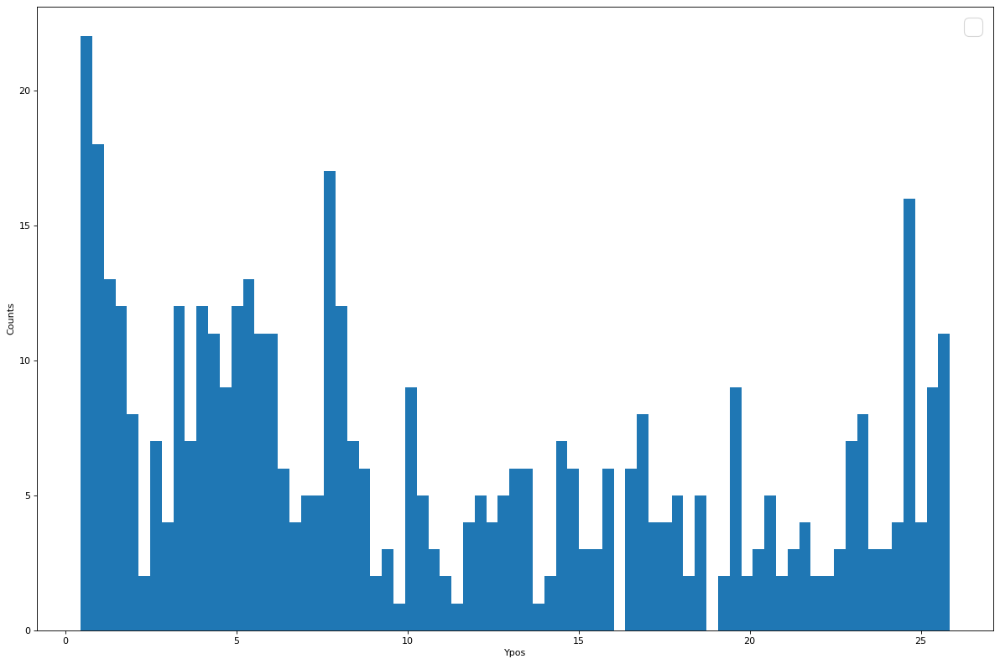

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


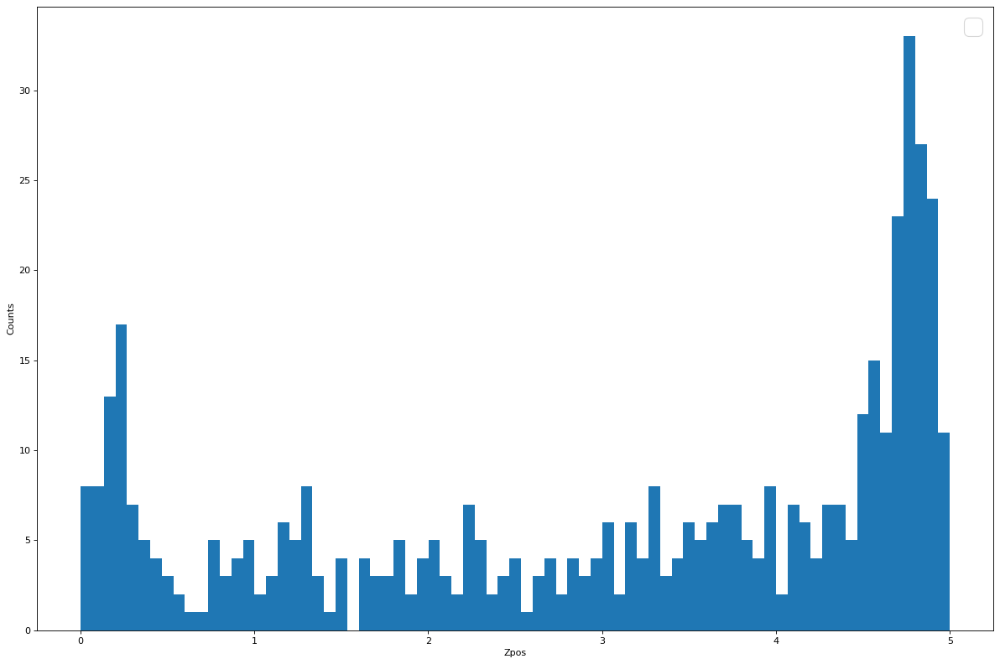

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


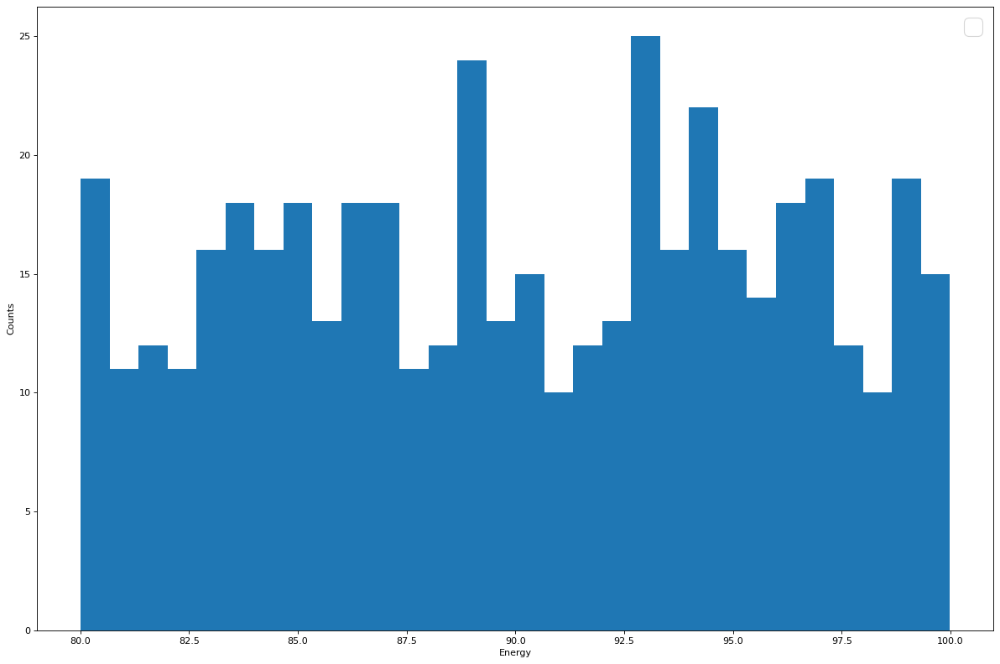

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


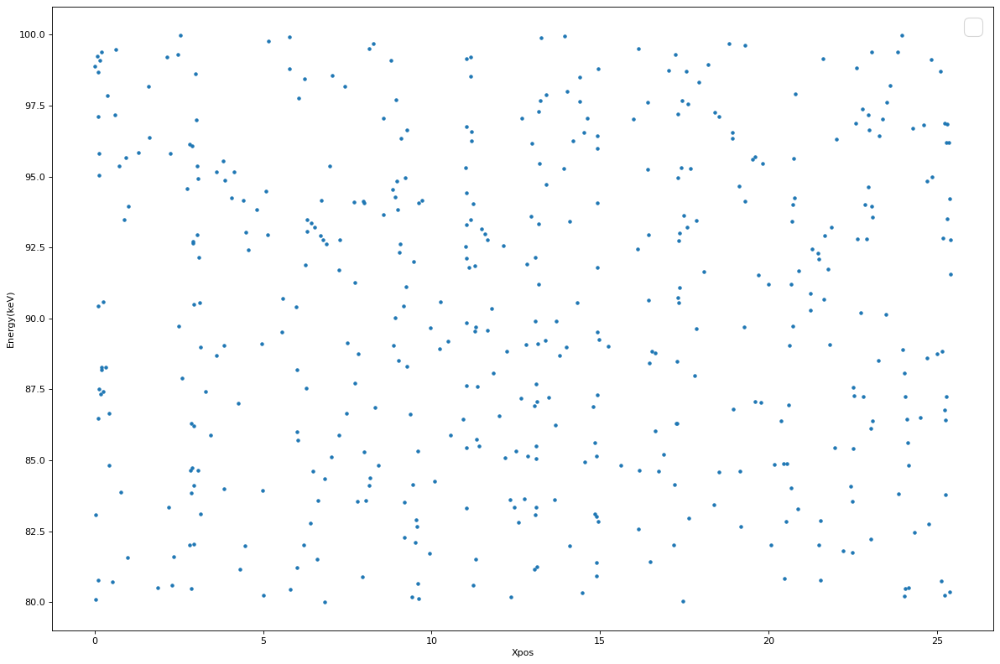

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


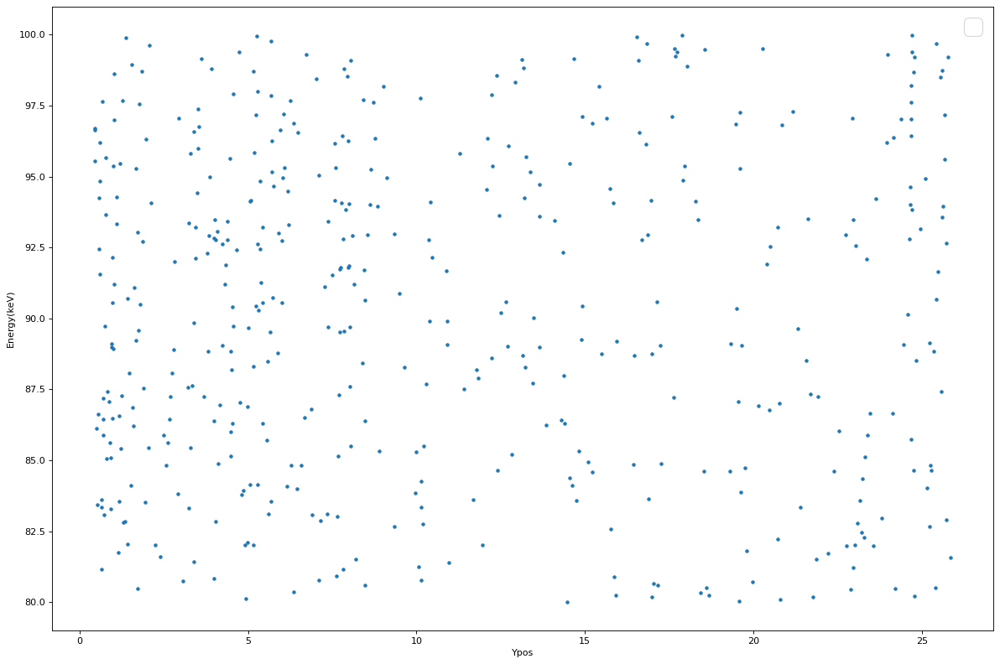

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


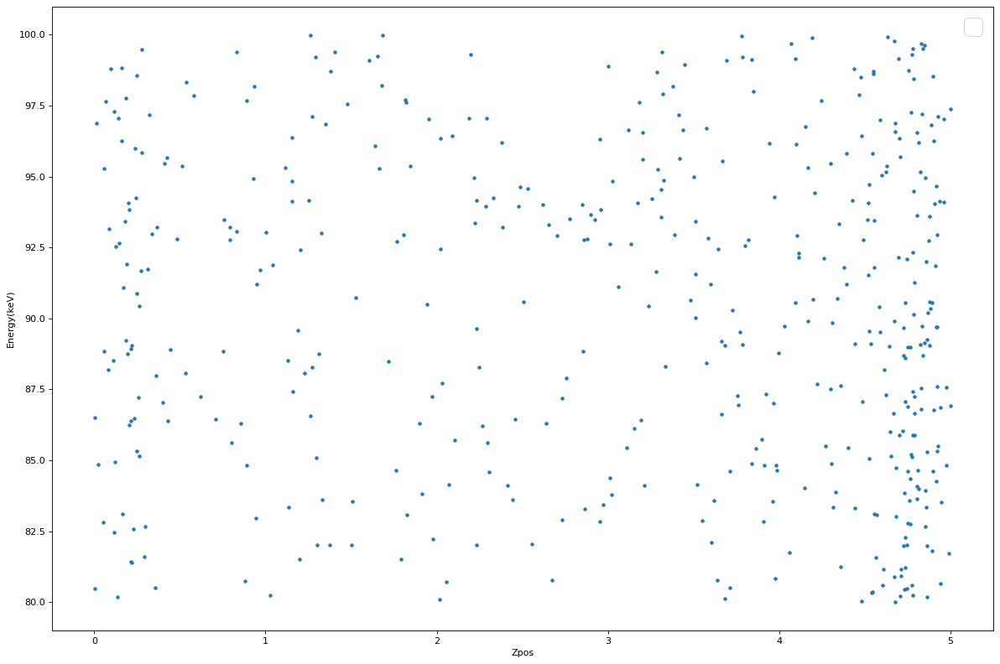

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

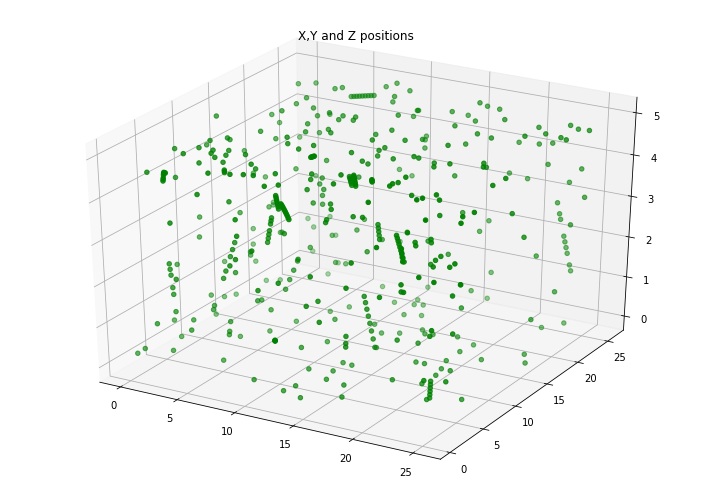

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

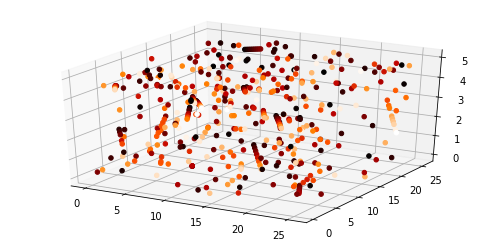

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 80-150

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >80 and first_energy_list[i]<150:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


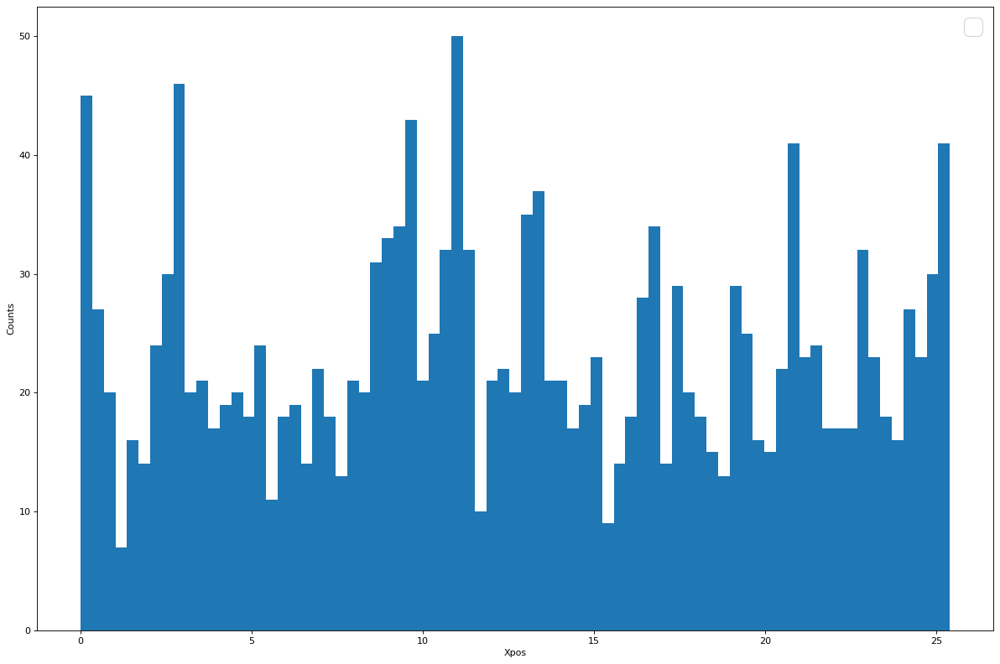

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


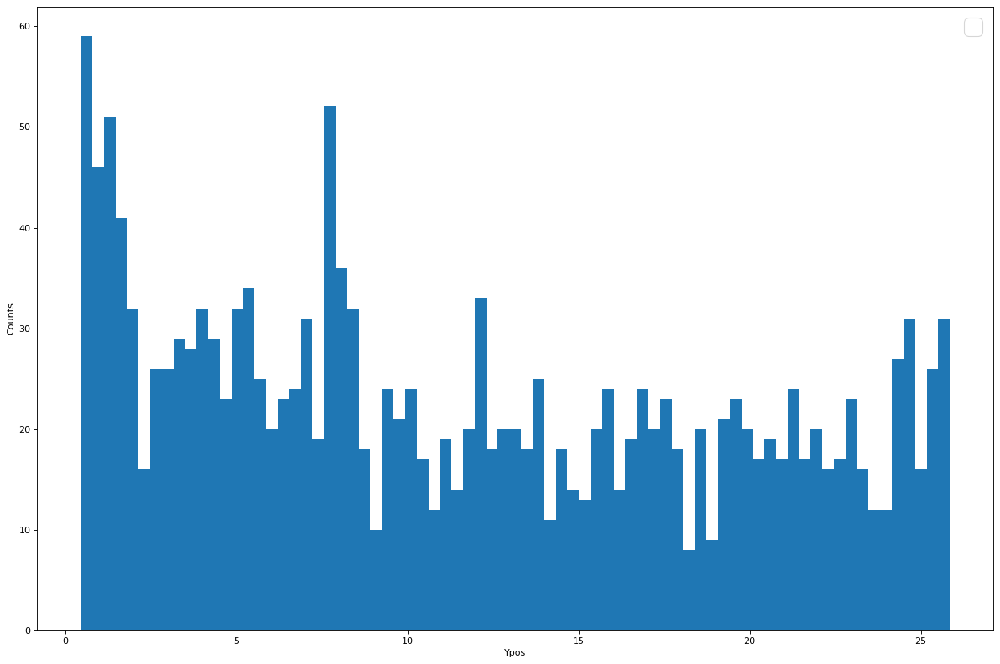

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


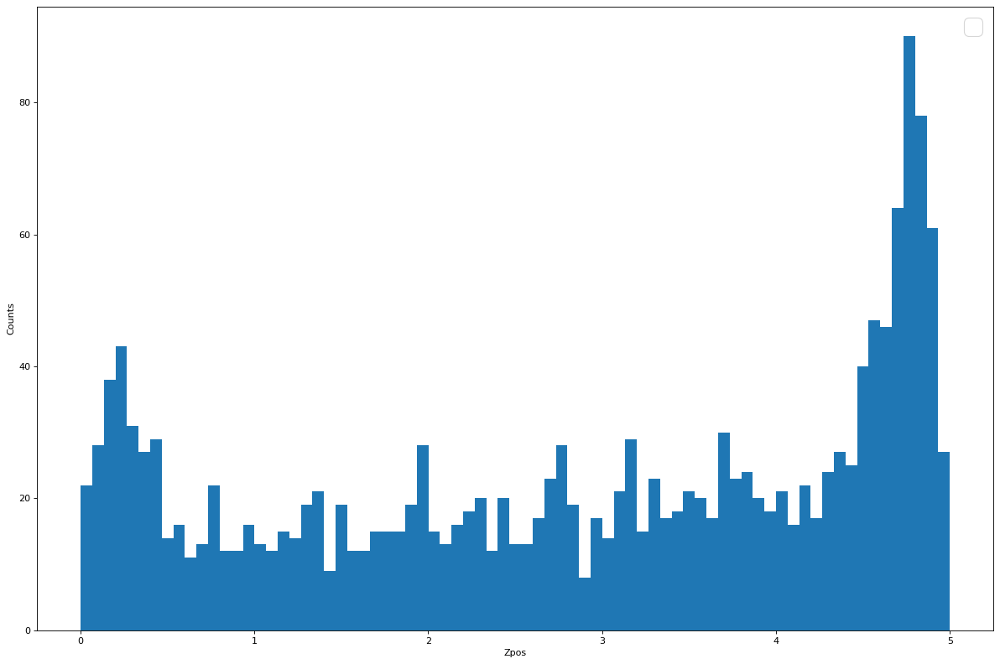

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


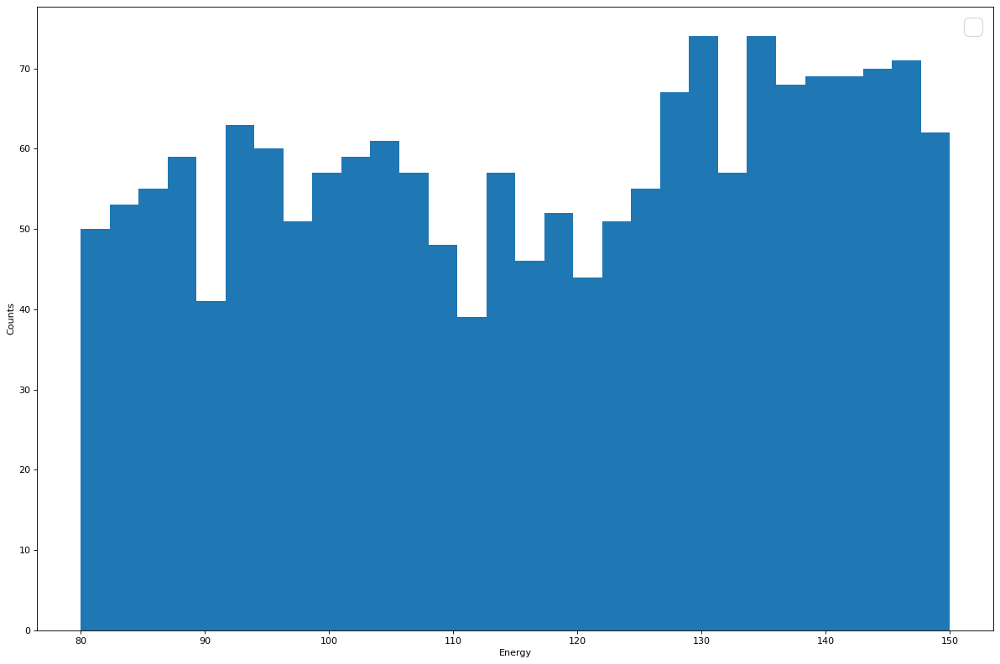

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


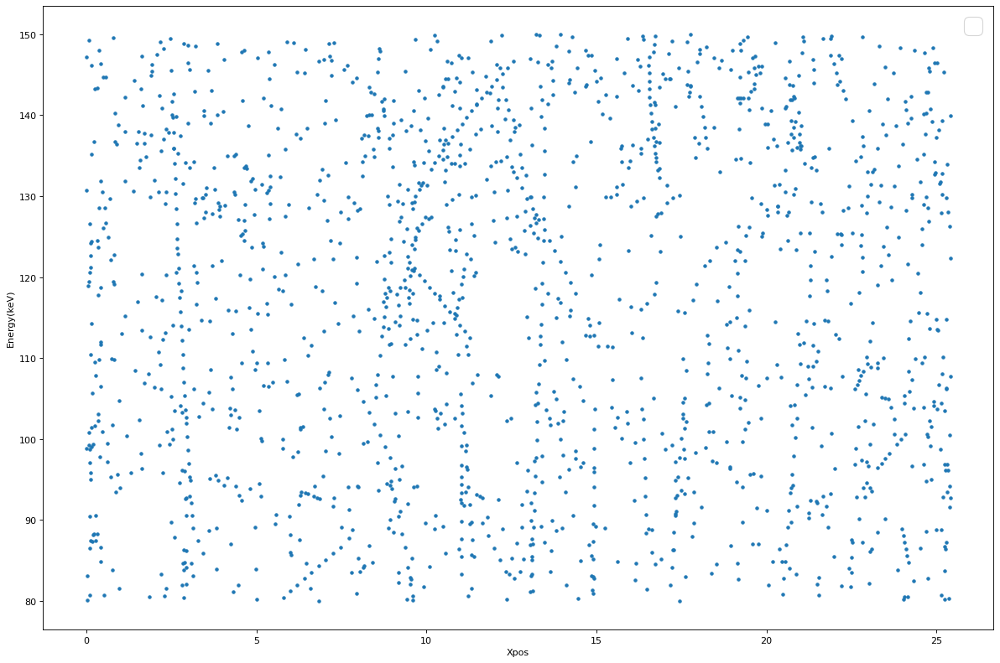

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


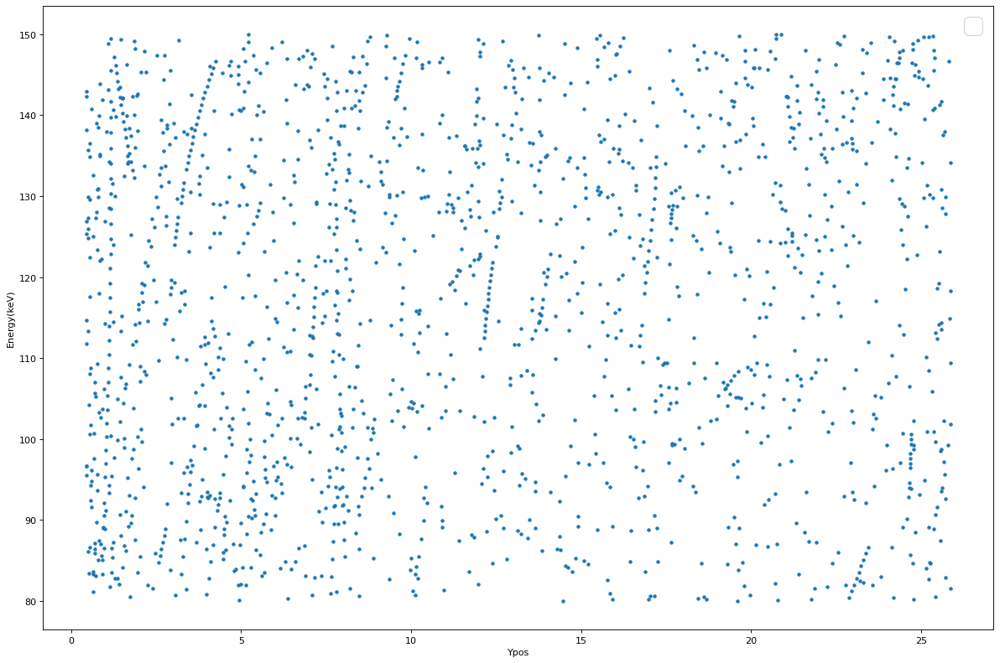

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


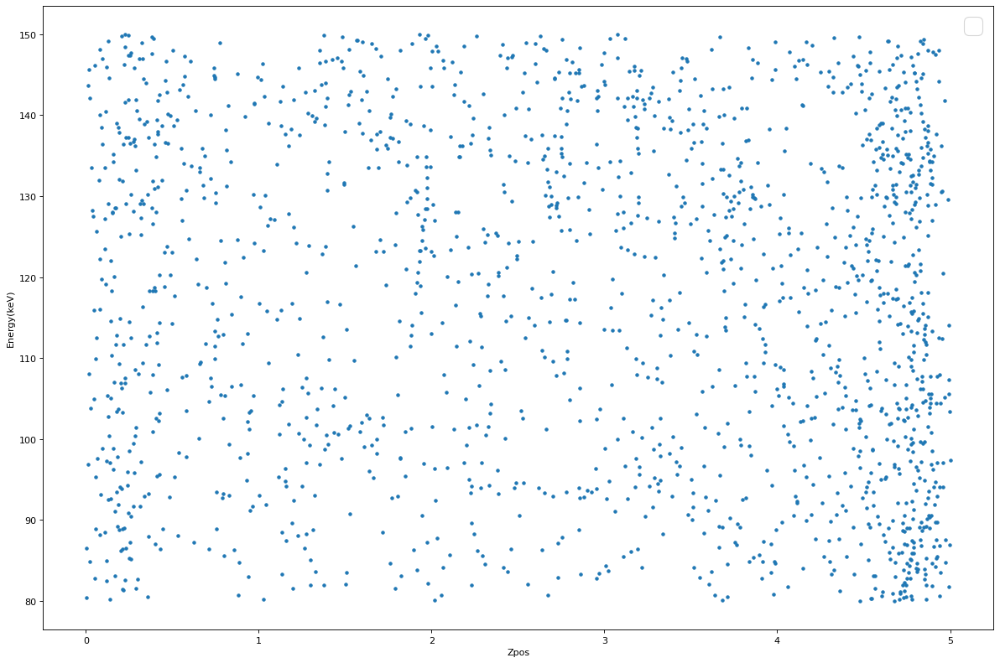

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

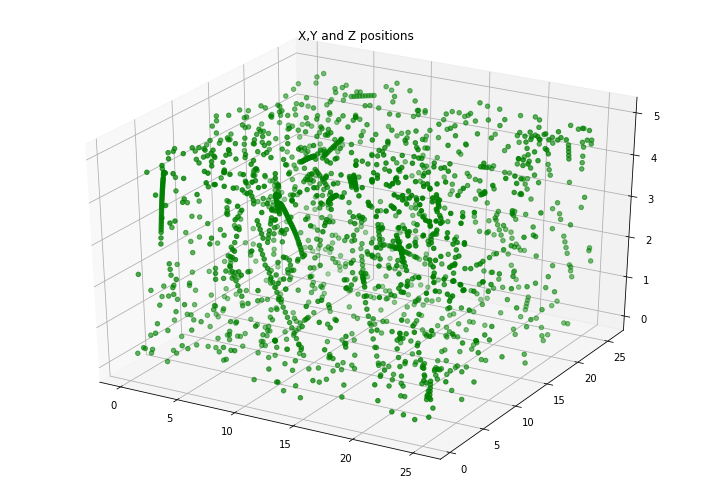

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

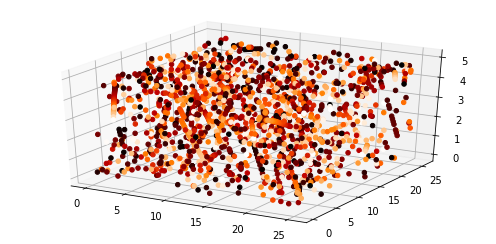

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 150-250

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(first_energy_list)):
  if first_energy_list[i] >150 and first_energy_list[i]<250:
    list_x.append(first_xpos_list[i])
    list_y.append(first_ypos_list[i])
    list_z.append(first_zpos_list[i])
    list_en.append(first_energy_list[i])

No handles with labels found to put in legend.


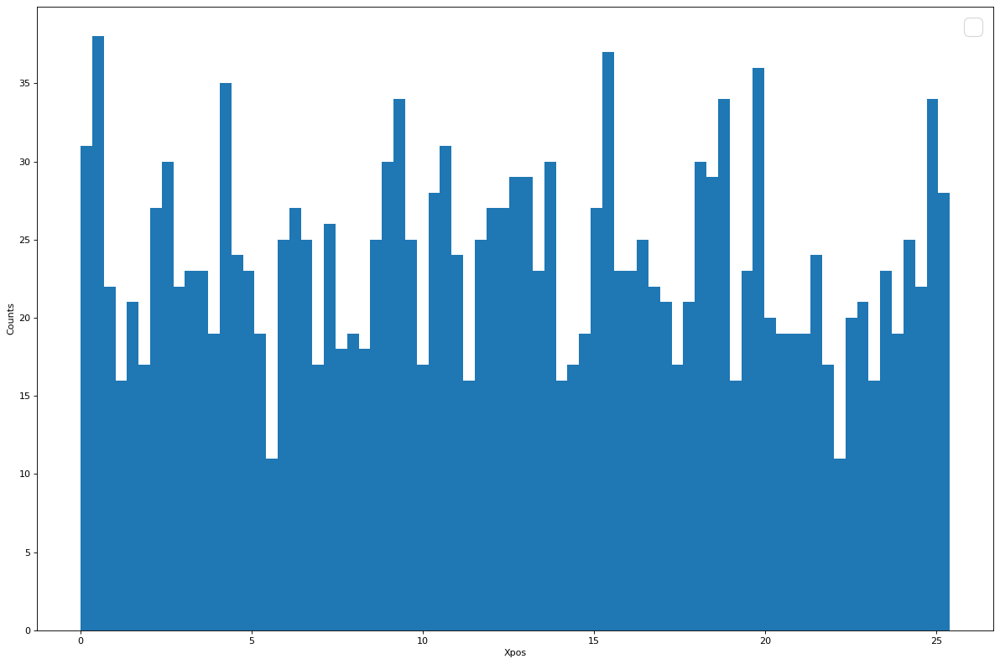

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


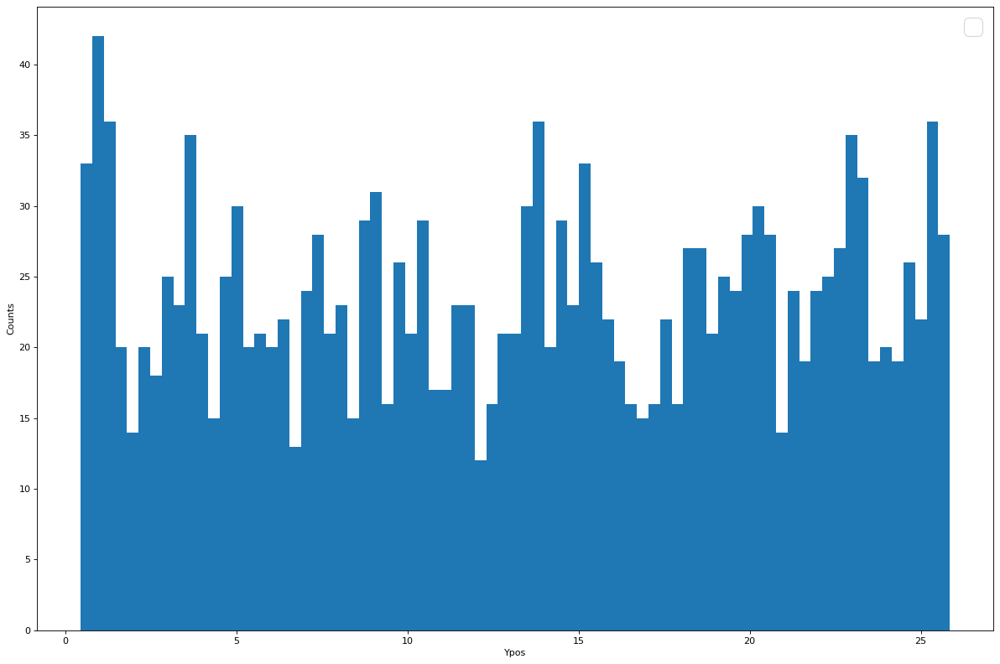

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


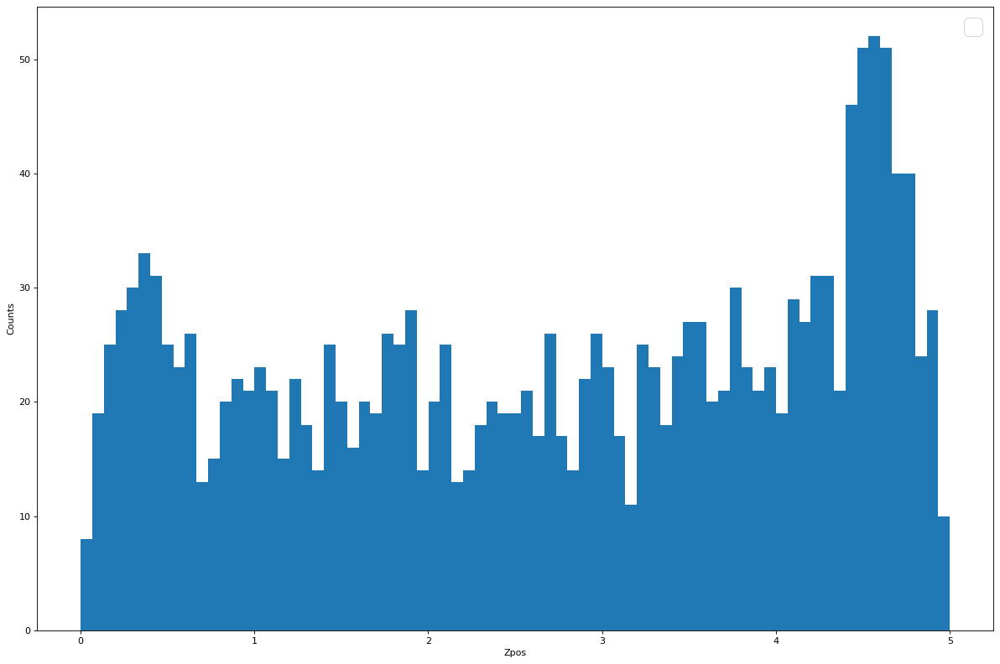

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


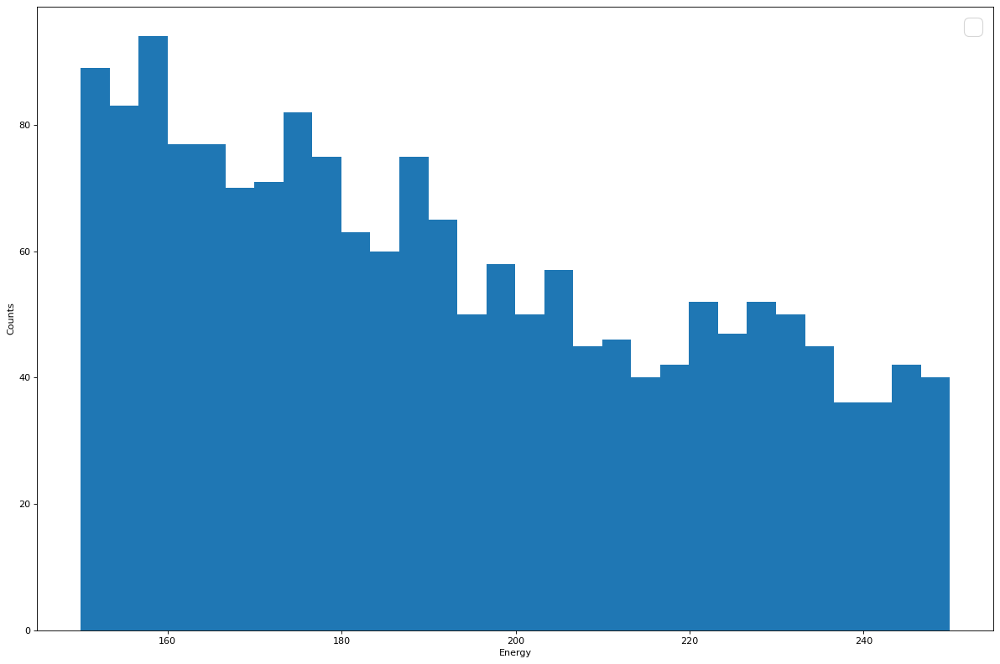

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


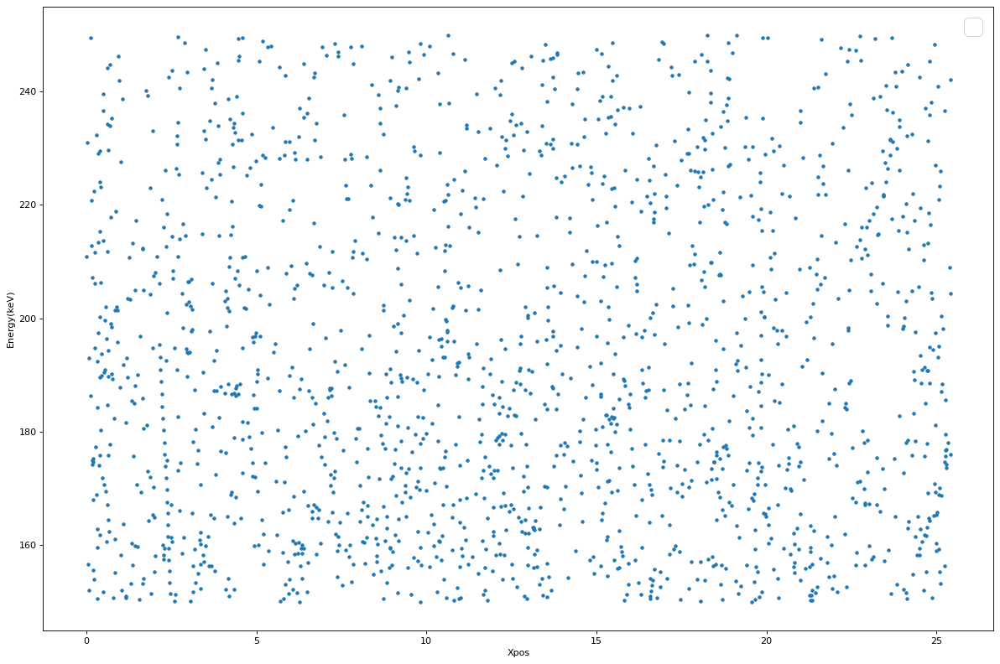

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


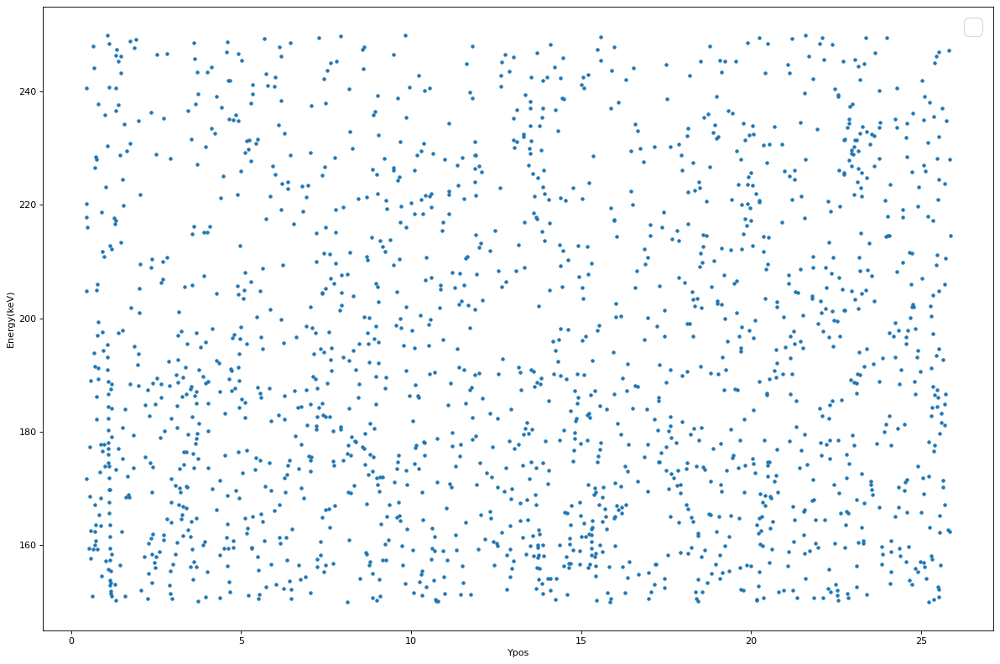

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


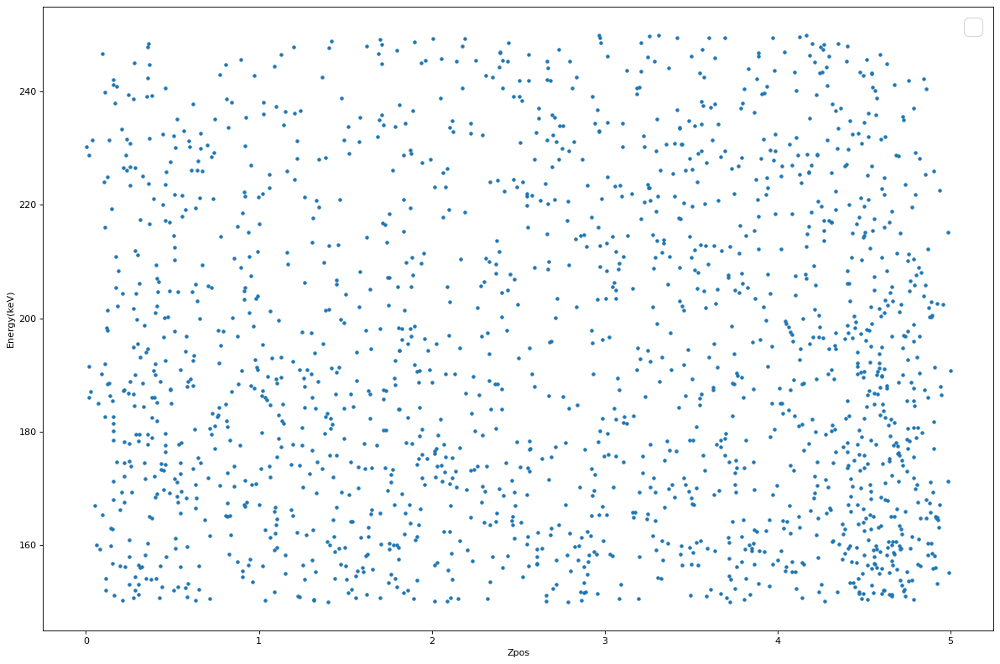

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

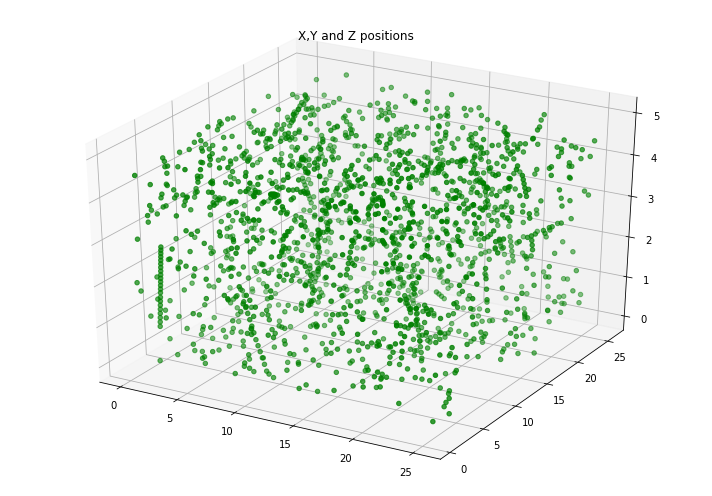

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

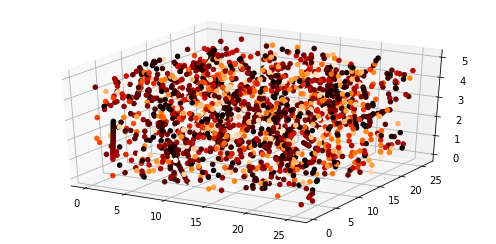

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

## Mean e cloud

### 20-250

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >20 and mean_energy_list[i]<250:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


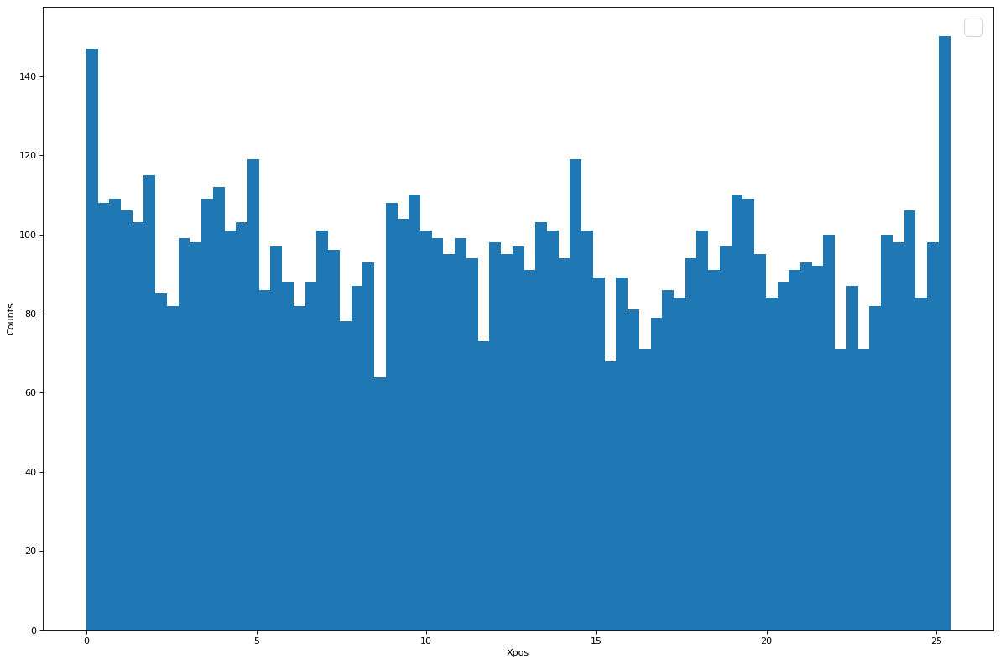

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


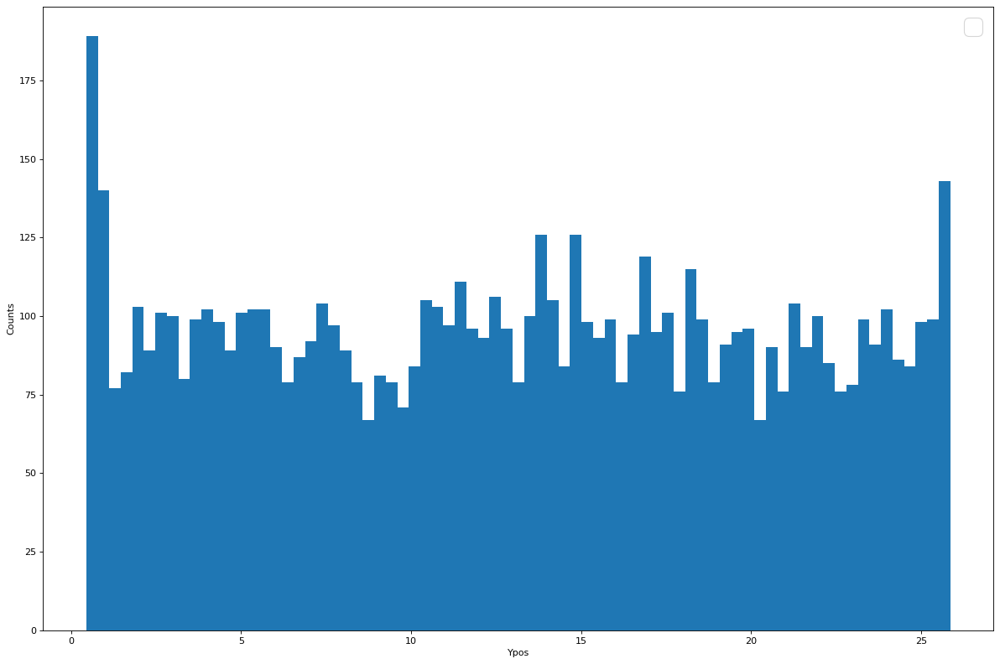

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


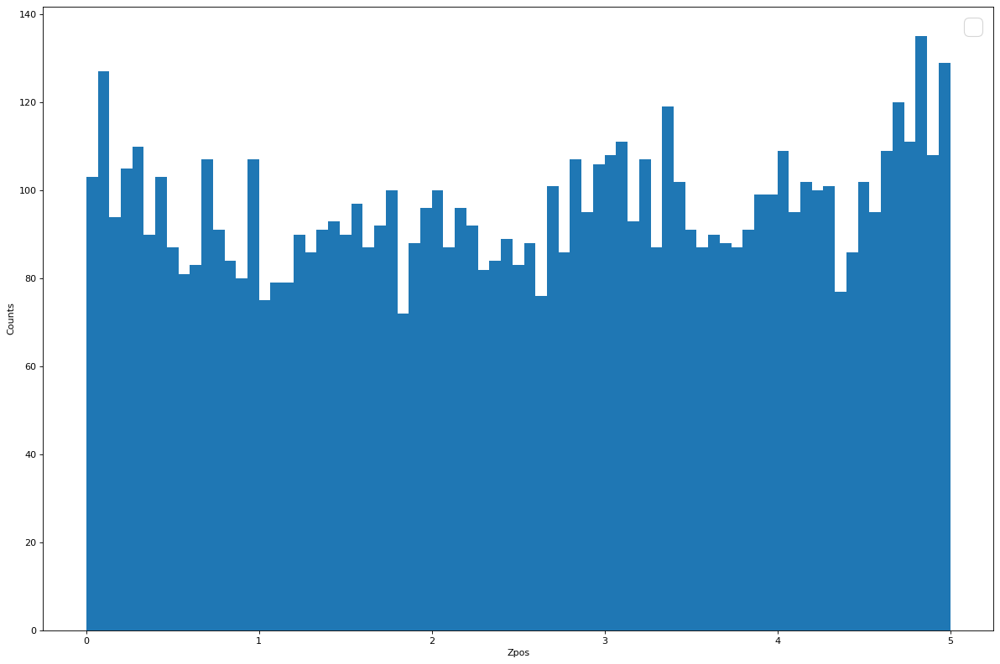

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


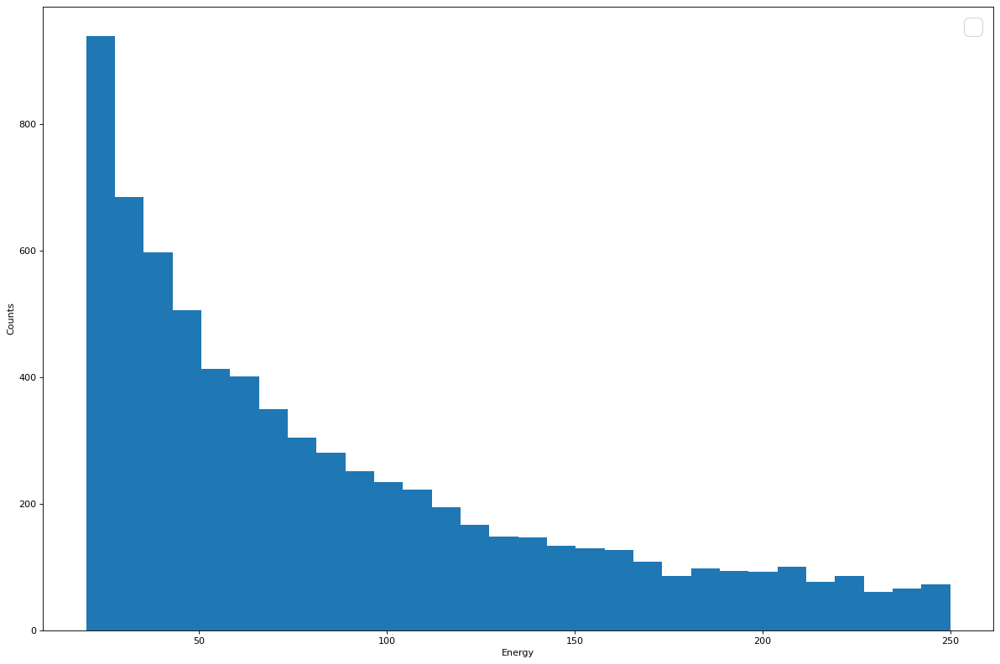

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


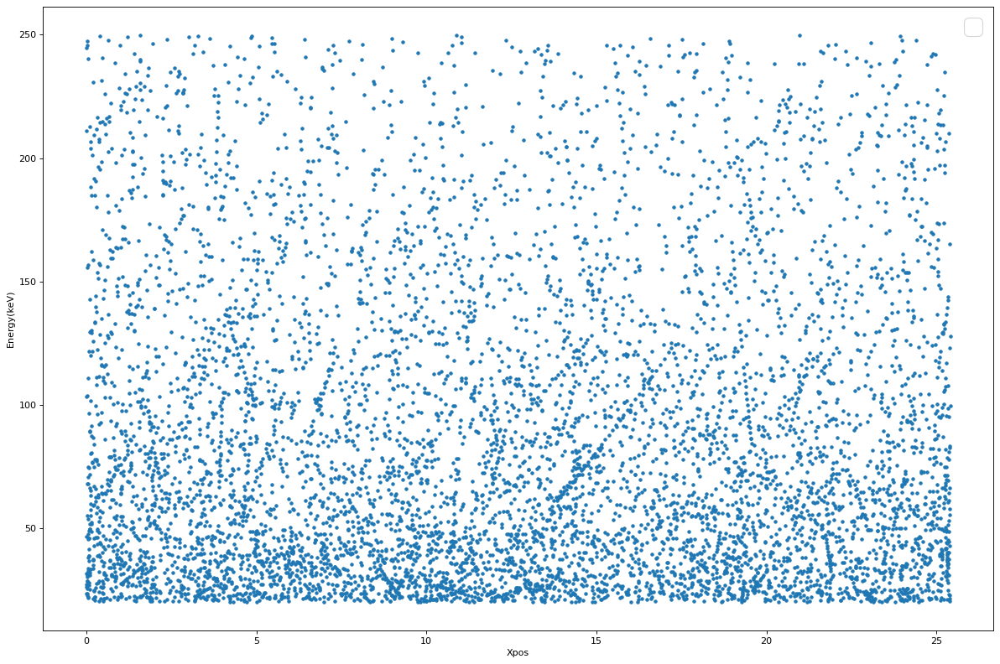

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


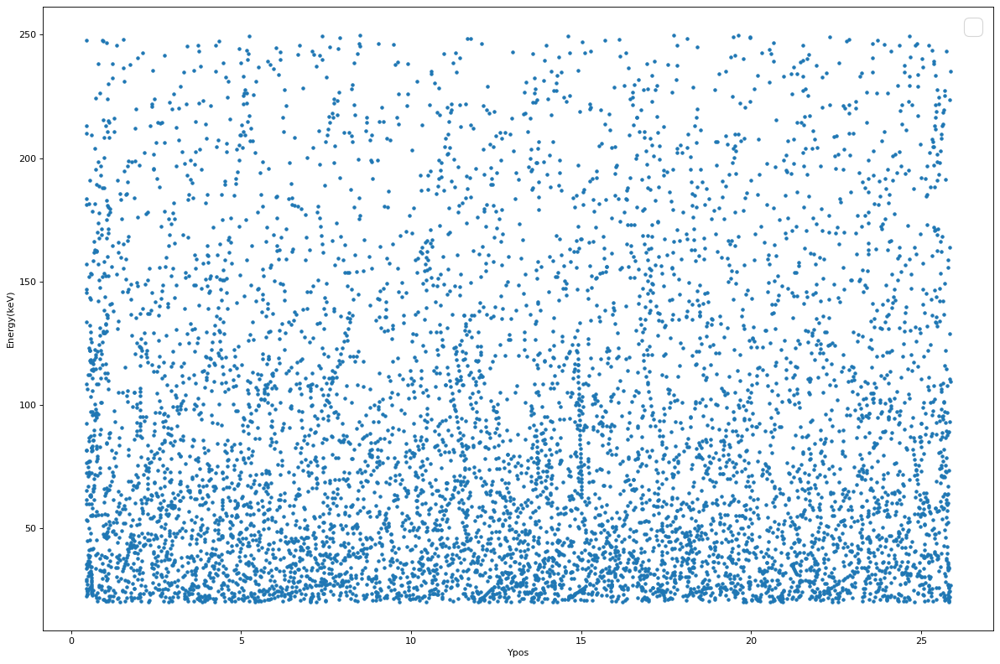

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


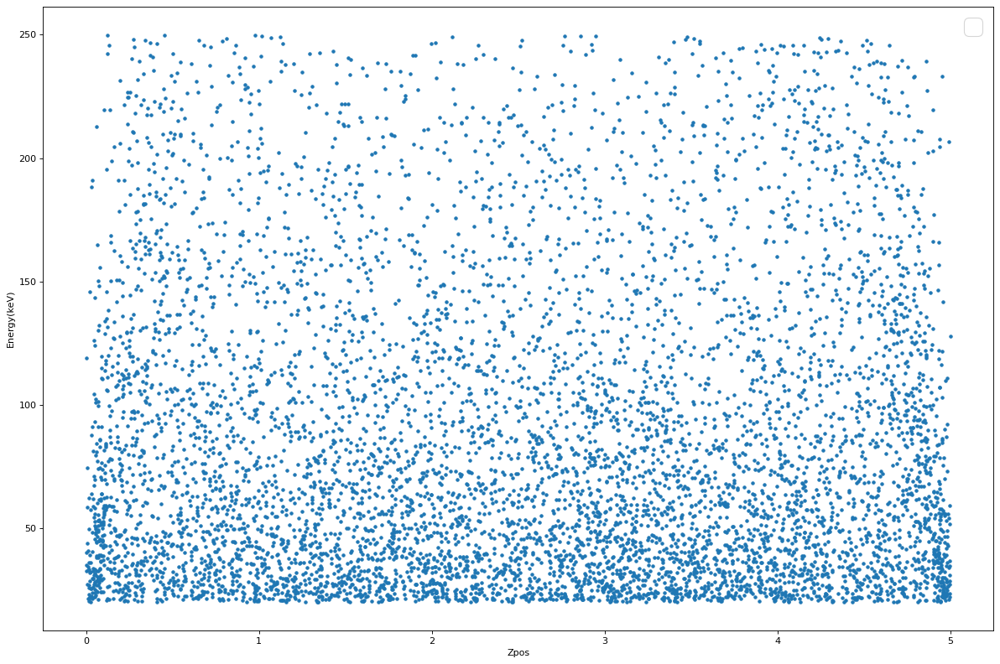

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

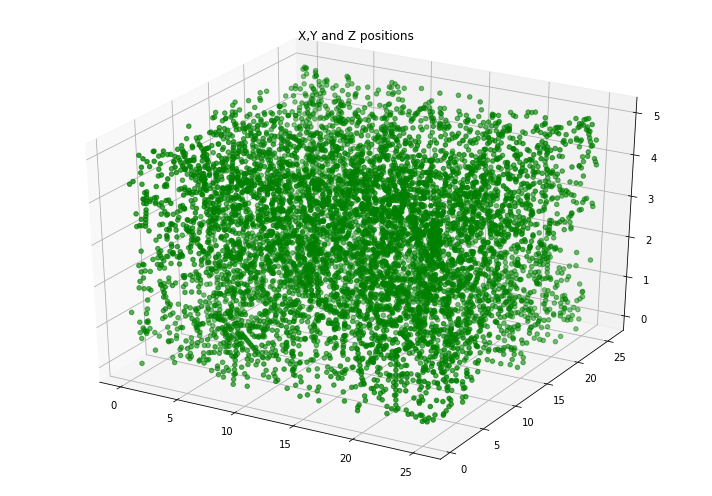

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

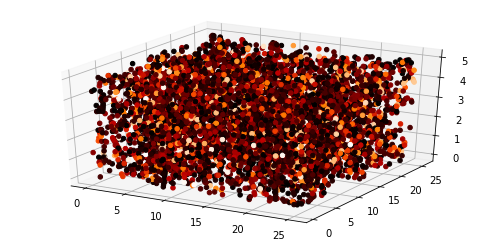

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 20-80

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >20 and mean_energy_list[i]<80:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


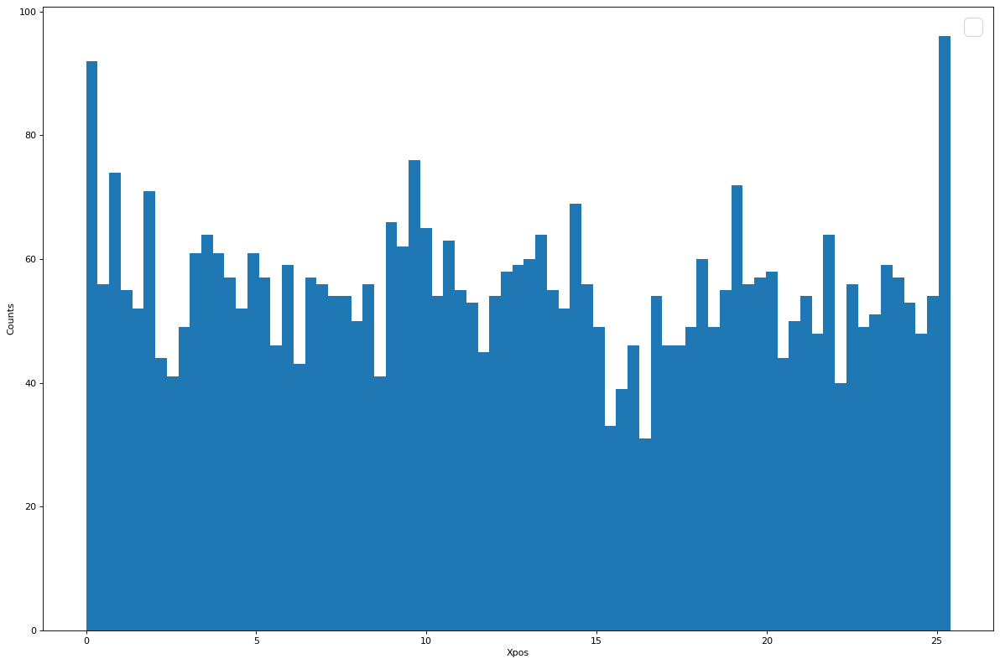

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


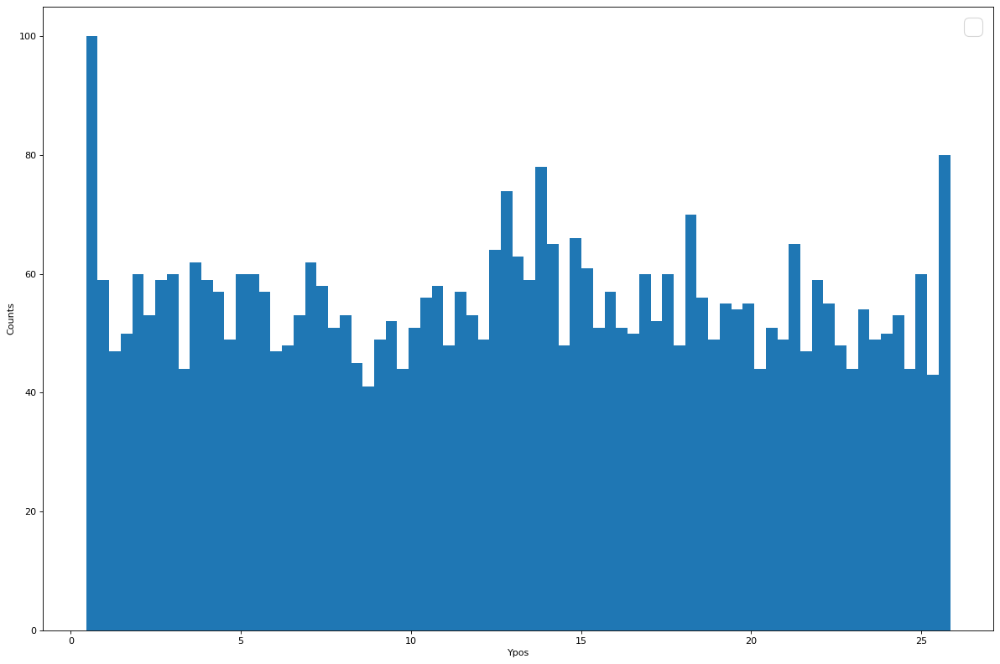

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


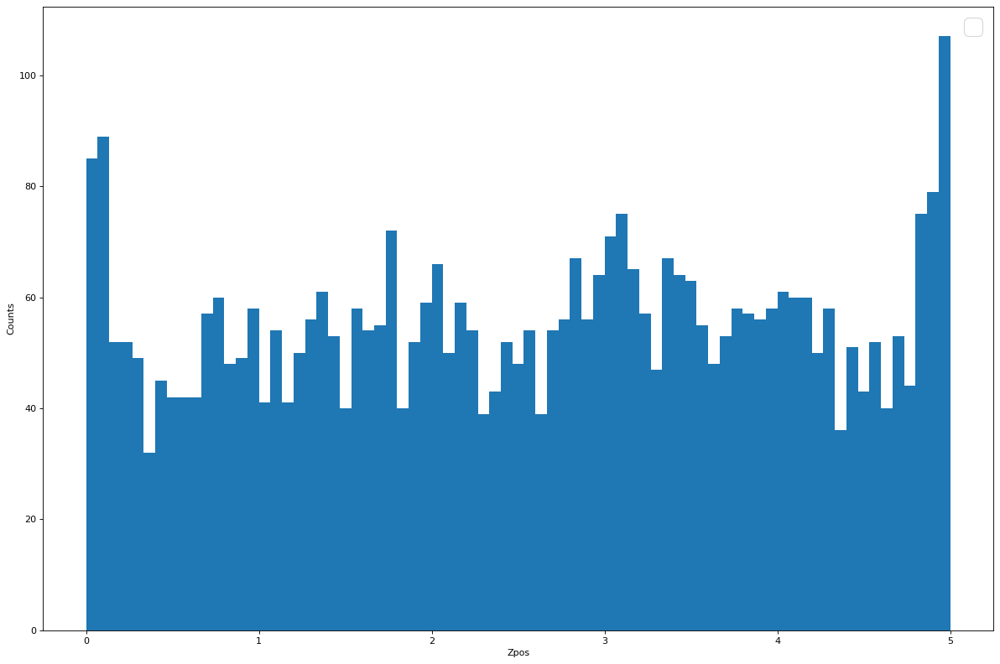

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


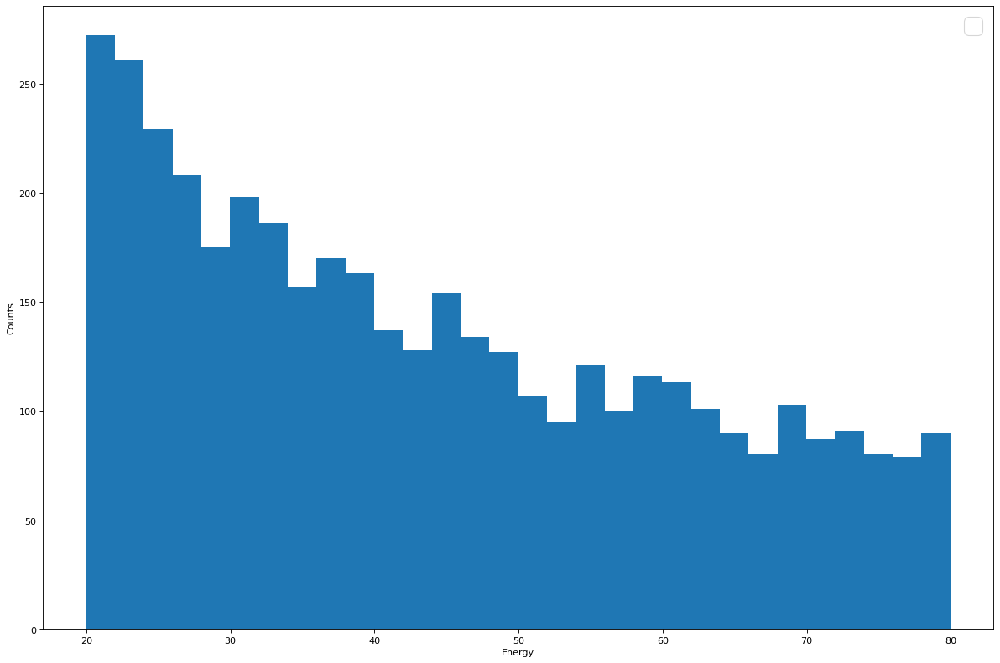

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


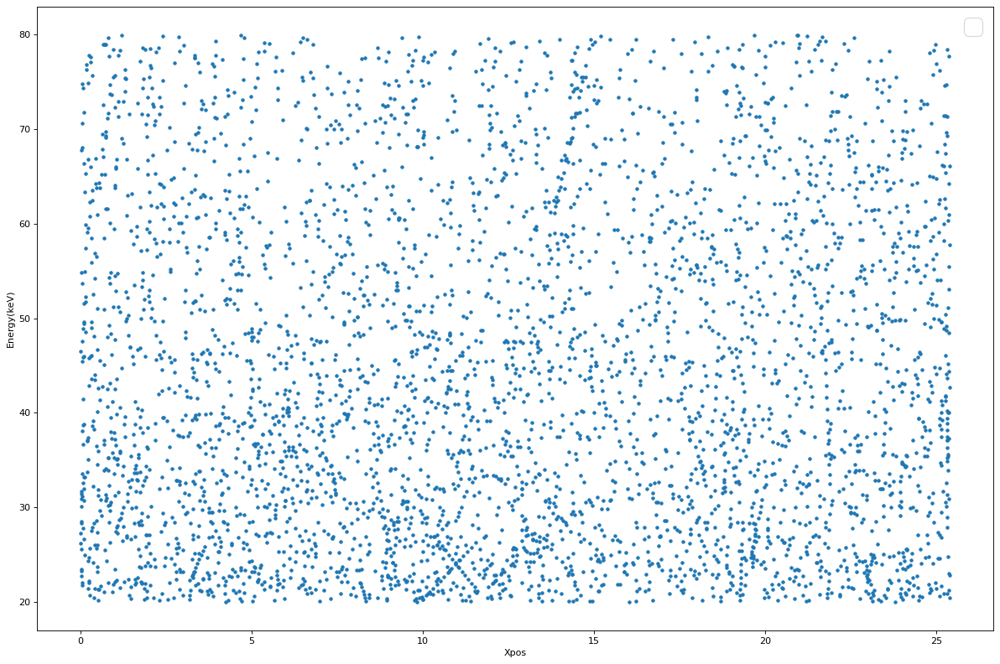

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


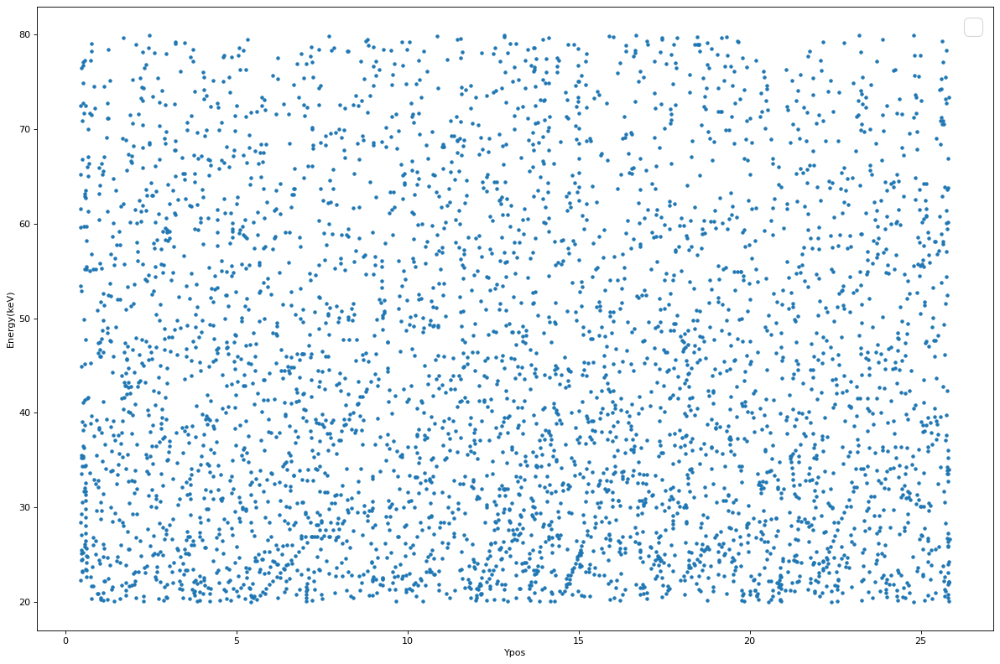

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


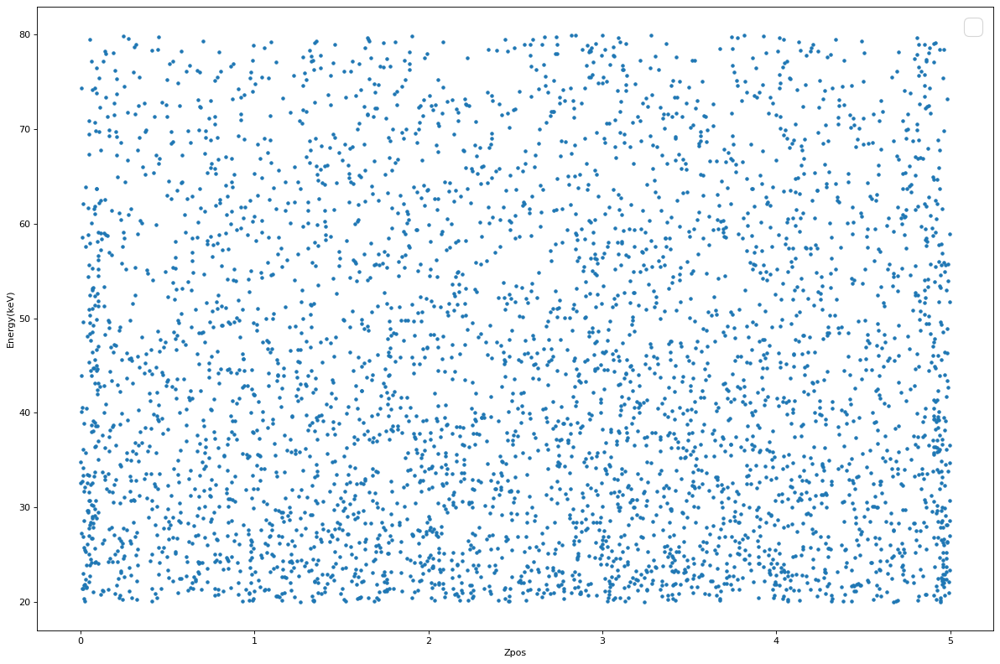

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

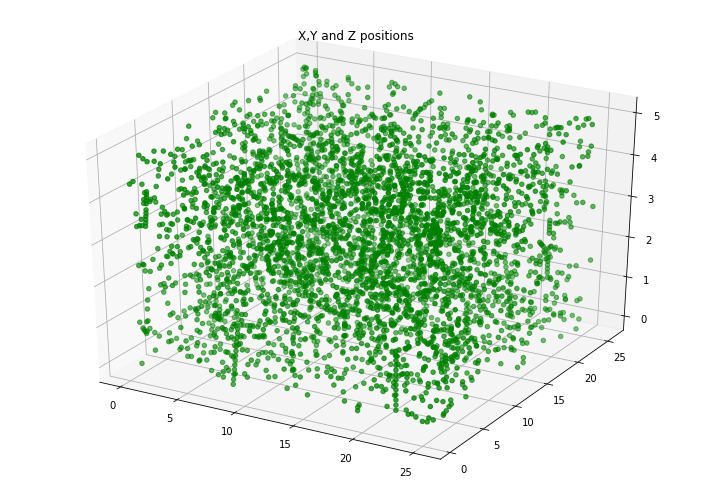

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

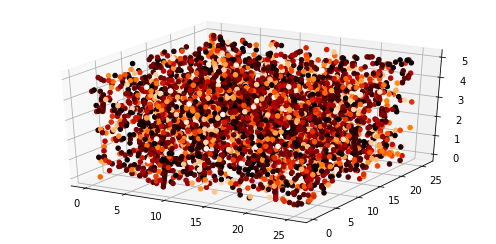

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 40-60

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >40 and mean_energy_list[i]<60:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


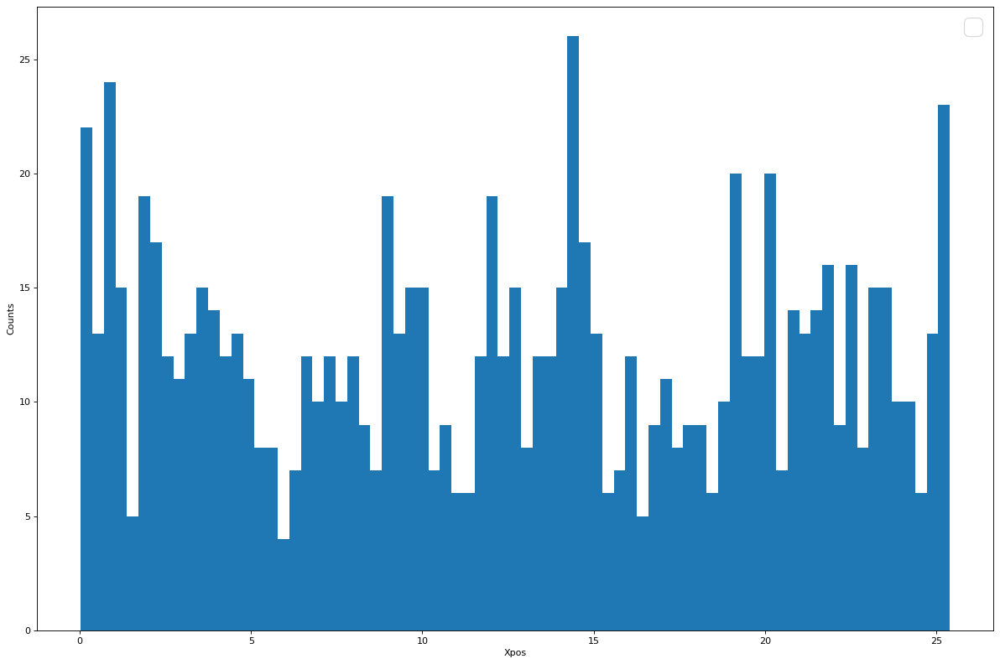

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


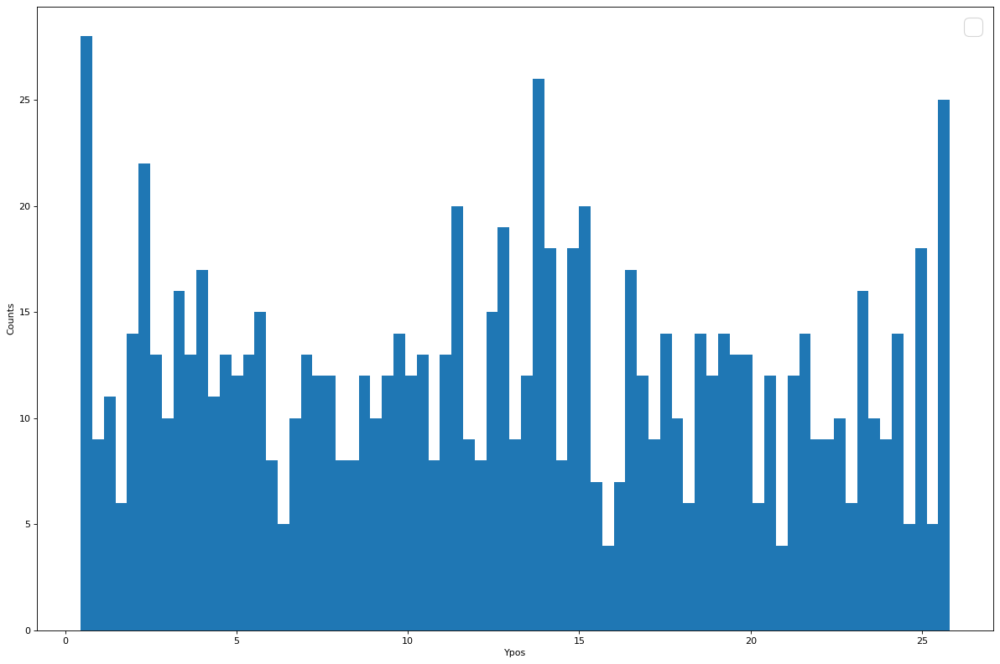

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


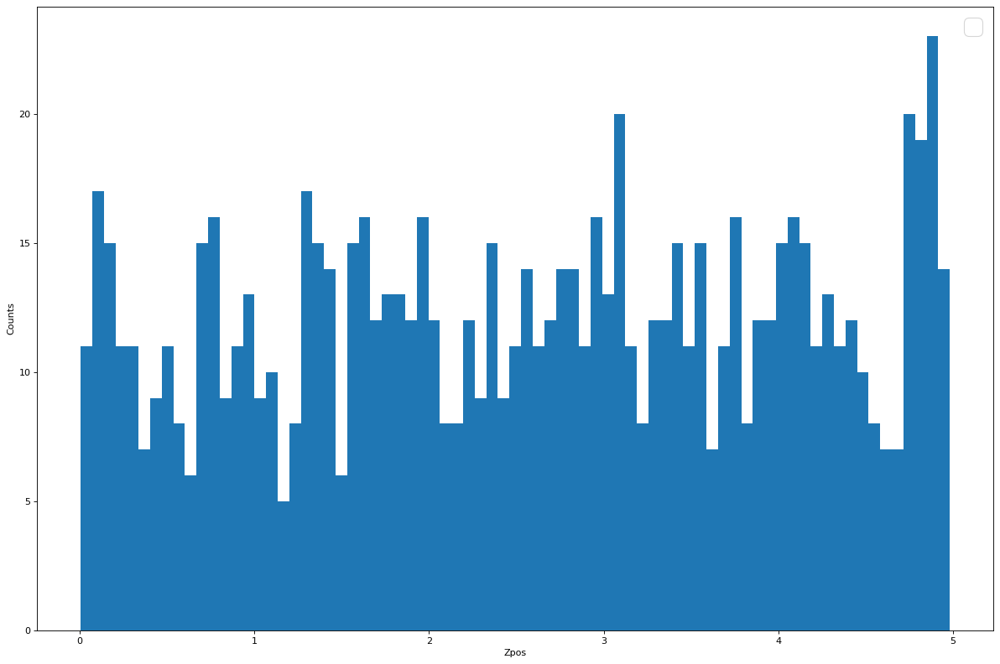

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


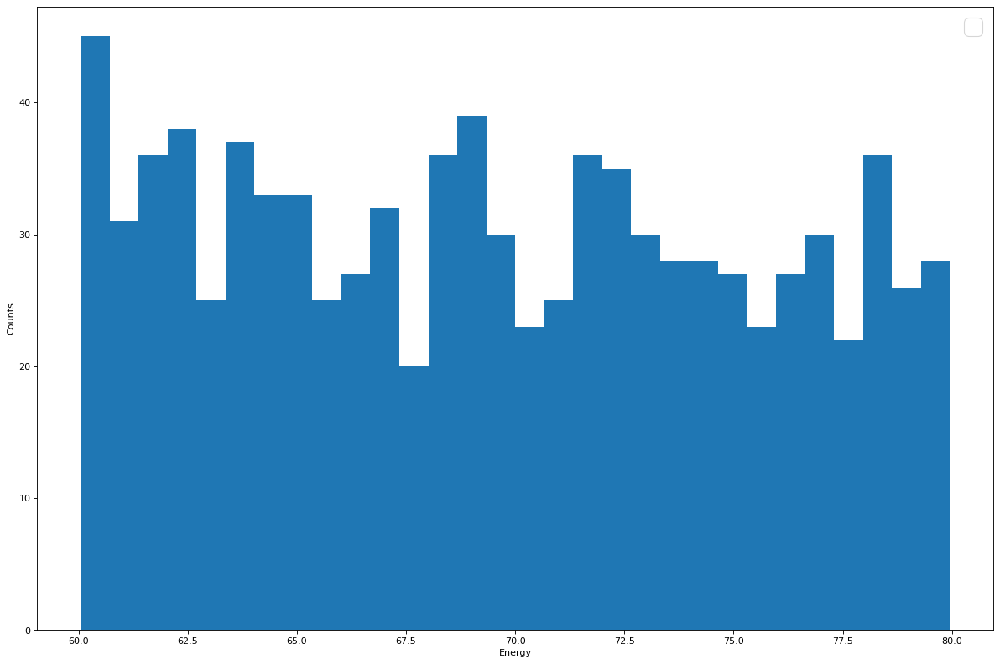

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


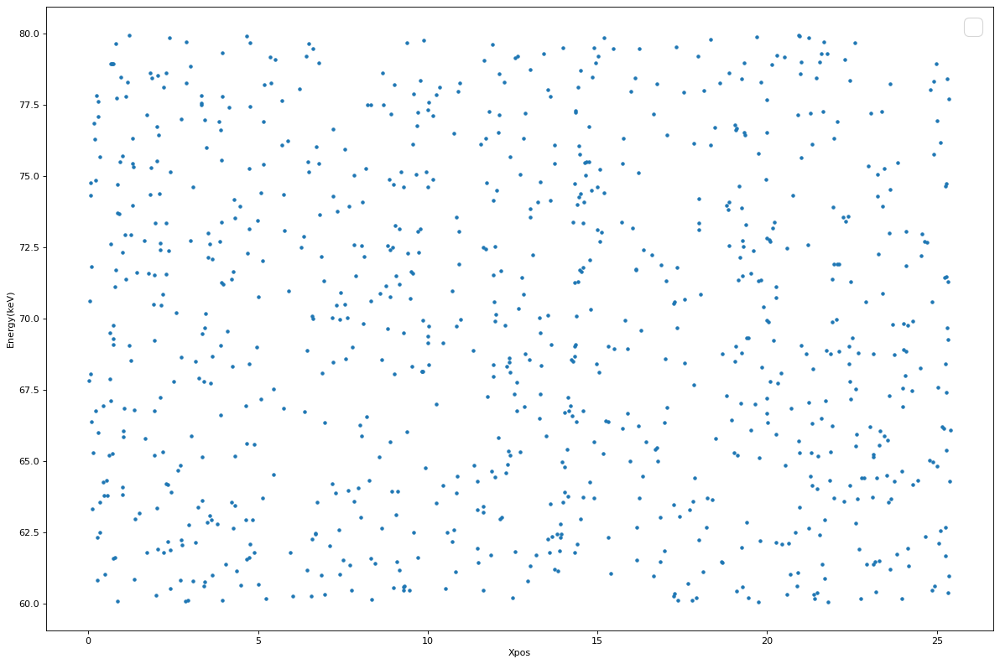

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


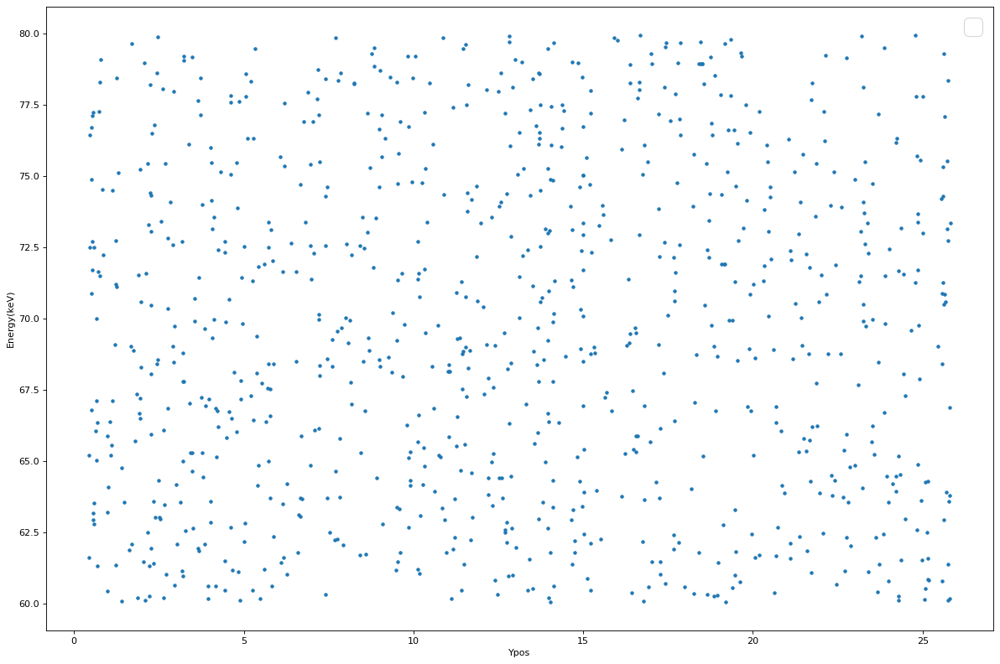

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


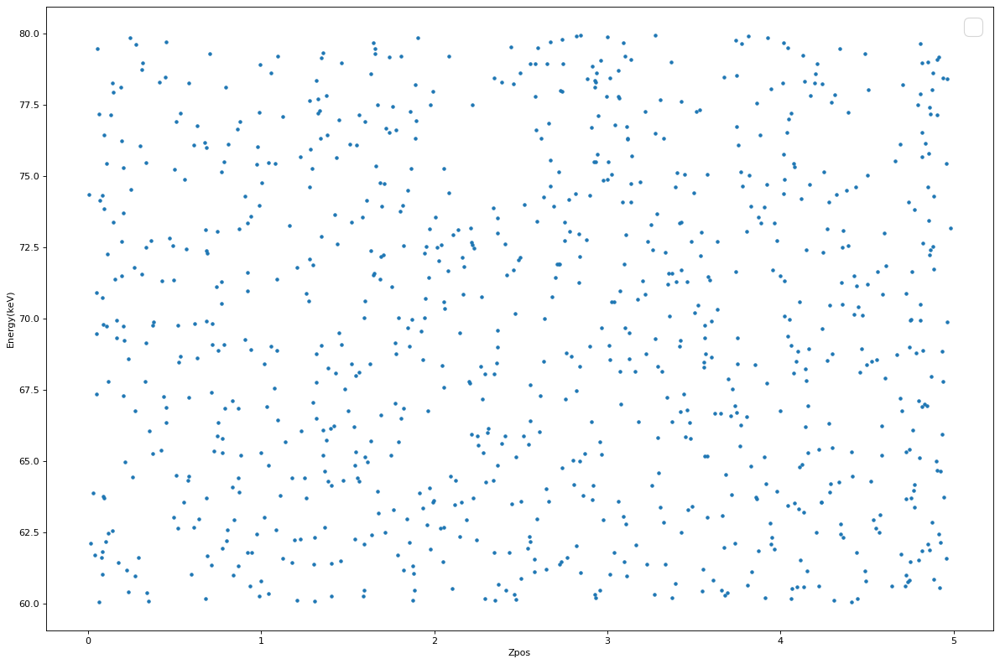

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

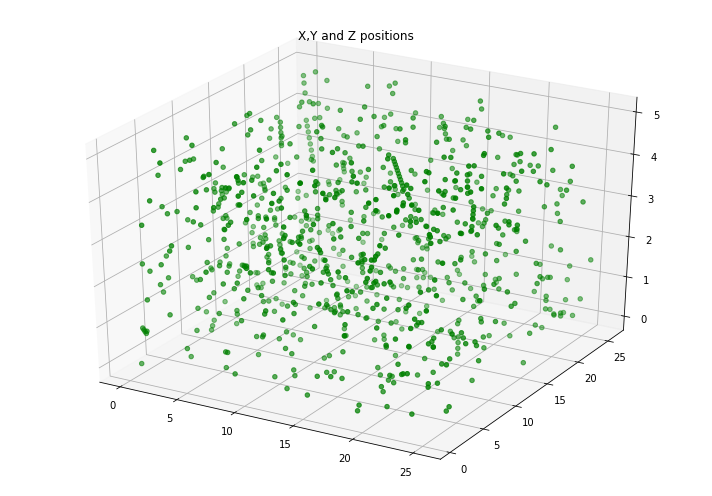

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

<Figure size 720x504 with 0 Axes>

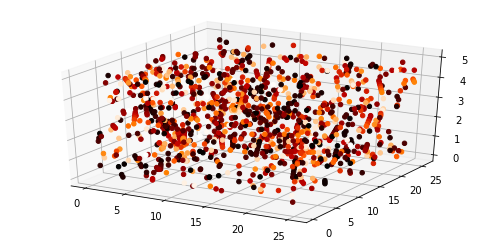

In [ ]:
fig = plt.figure(figsize = (10, 7))

plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 60-80

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >60 and mean_energy_list[i]<80:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


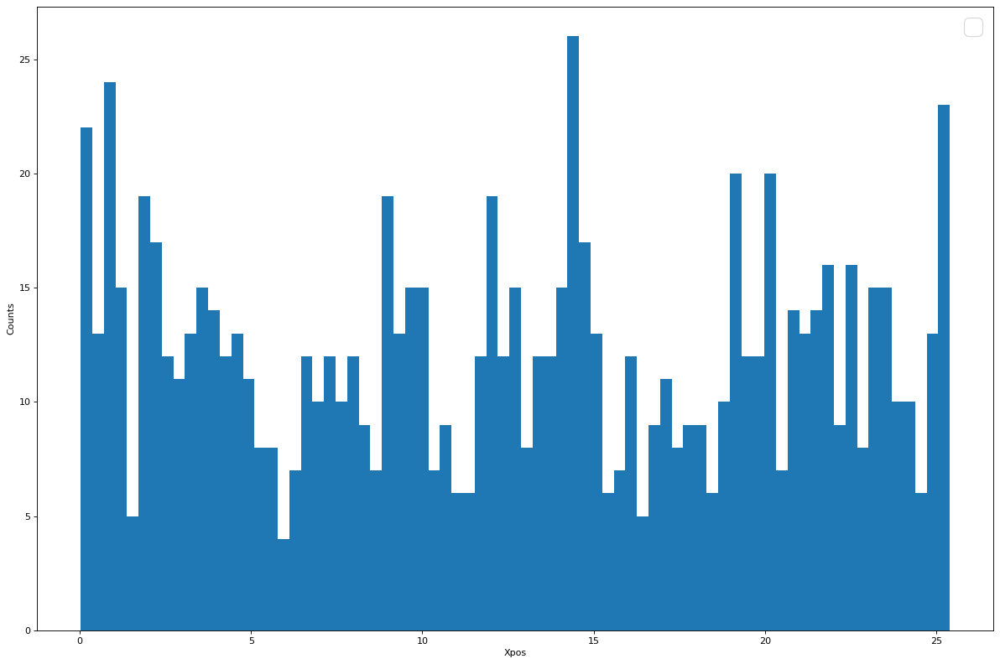

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


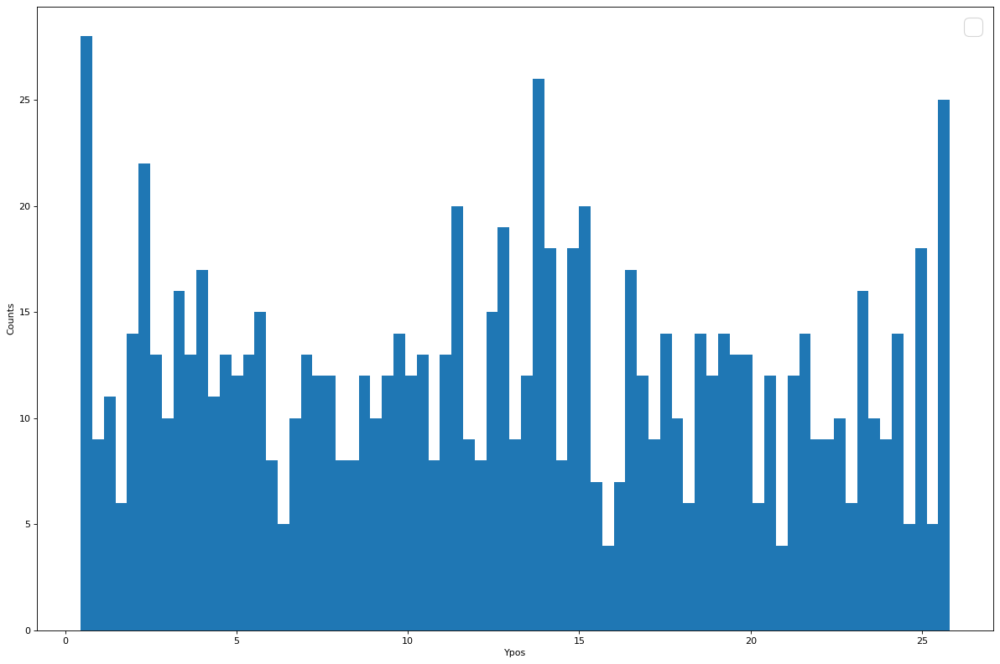

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


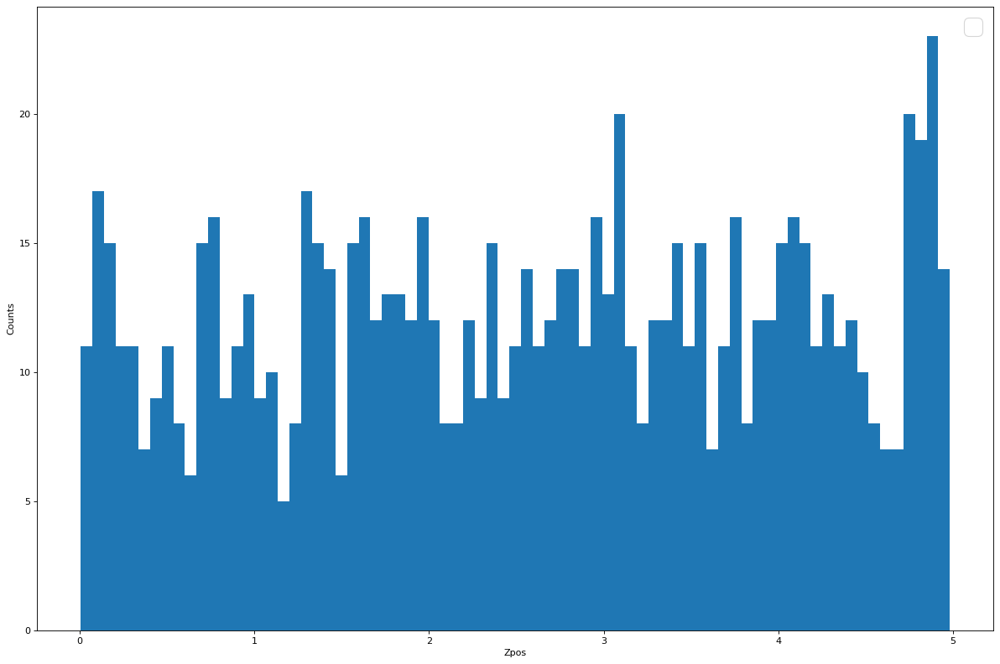

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


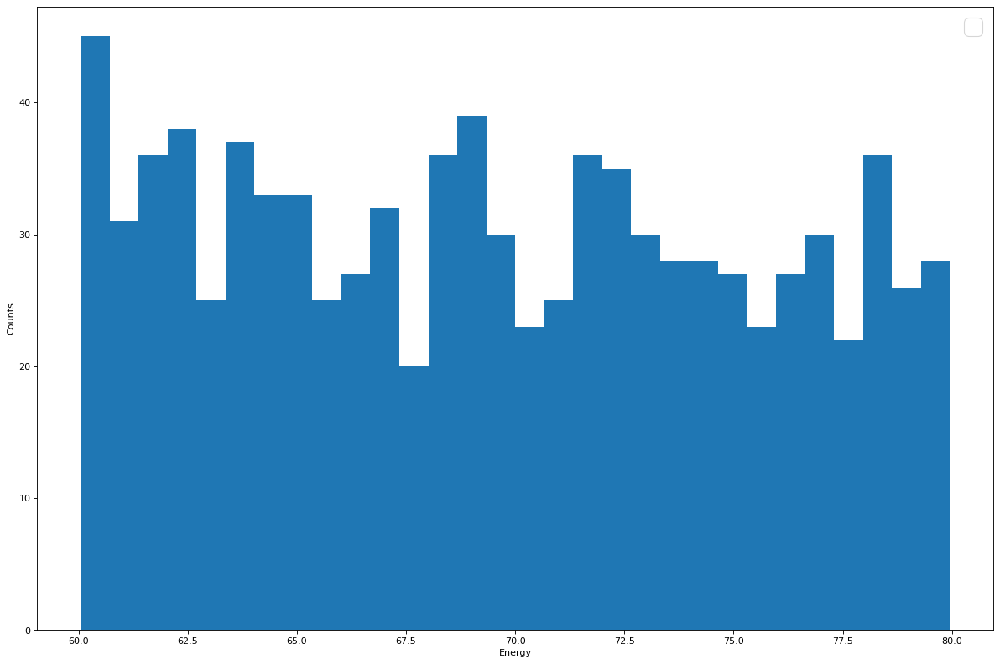

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


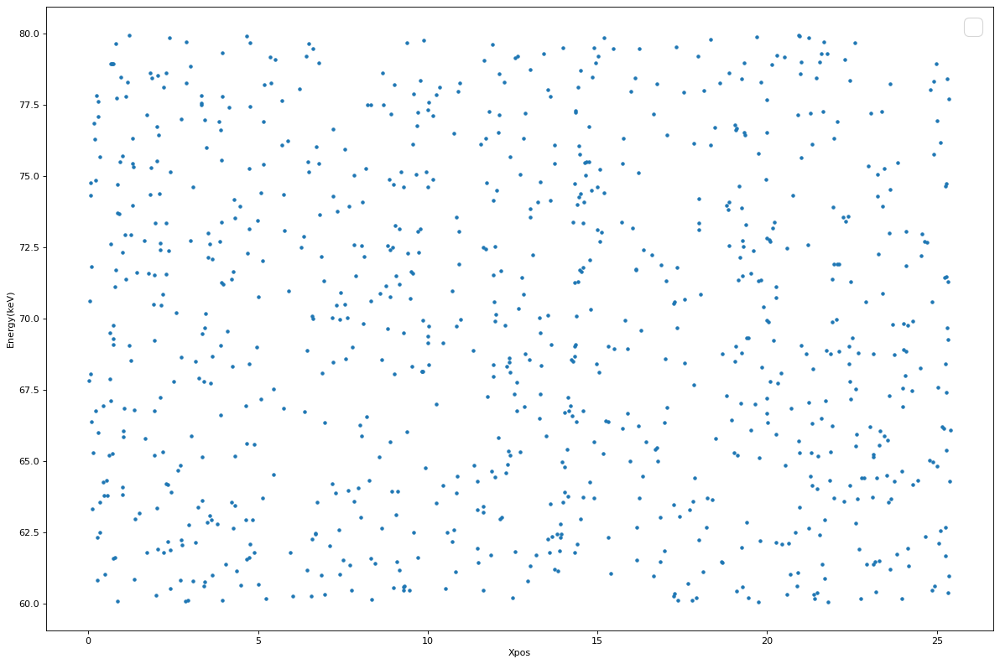

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


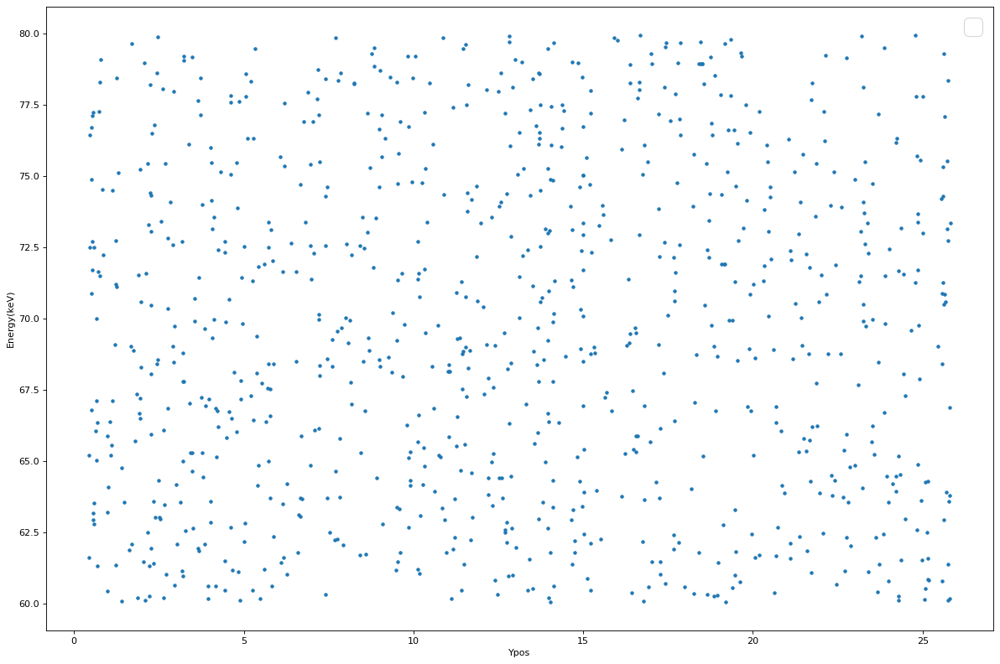

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


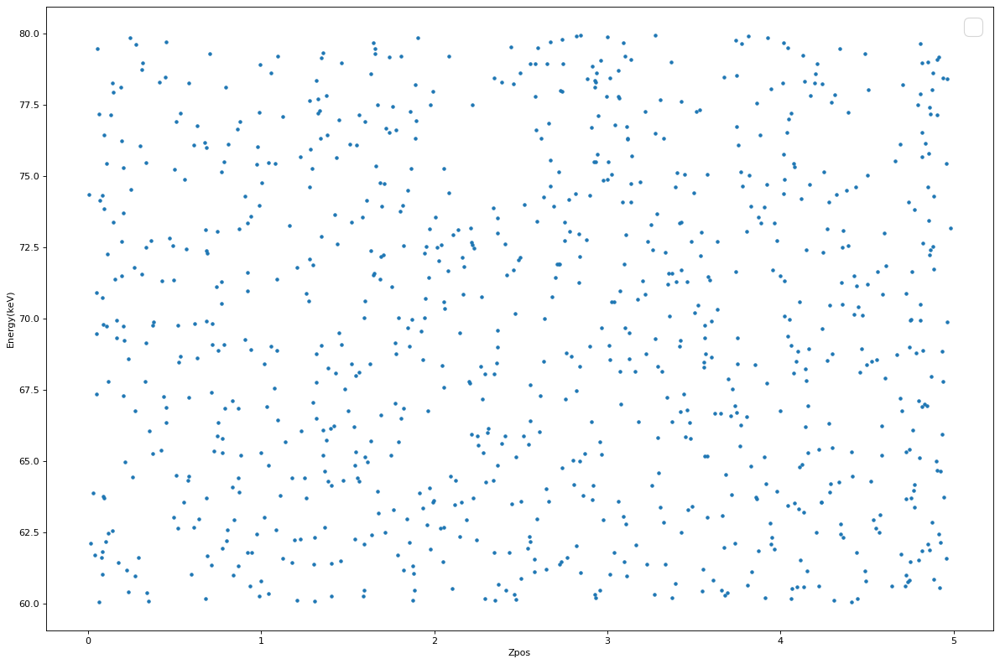

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

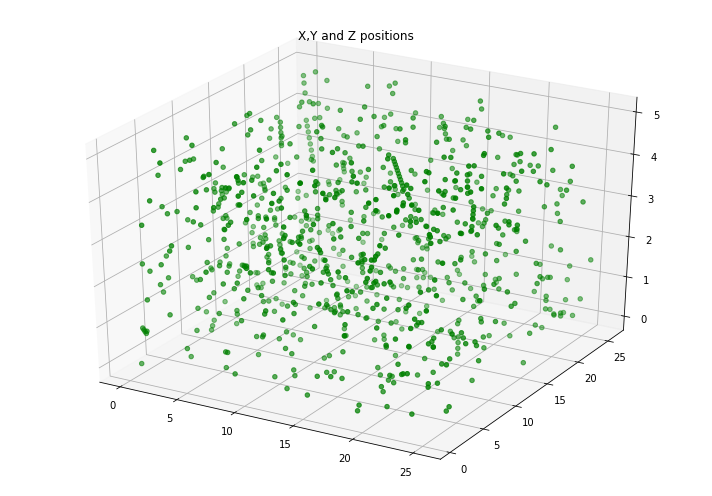

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

<Figure size 720x504 with 0 Axes>

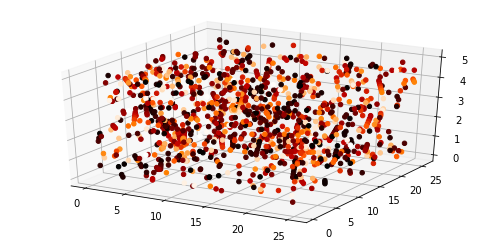

In [ ]:
fig = plt.figure(figsize = (10, 7))

plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 100-80

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >80 and mean_energy_list[i]<100:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


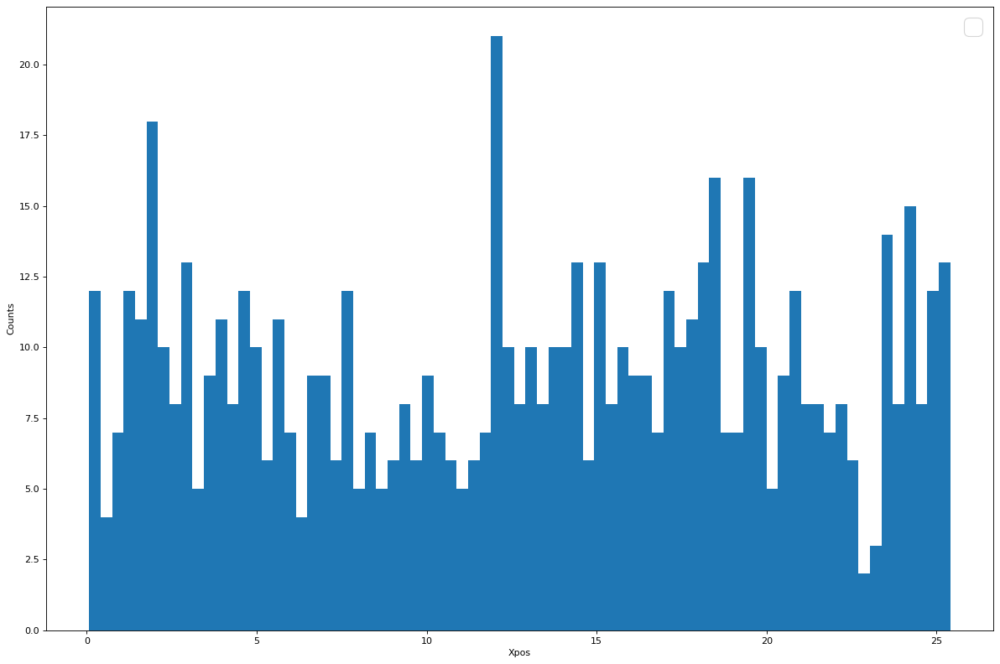

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


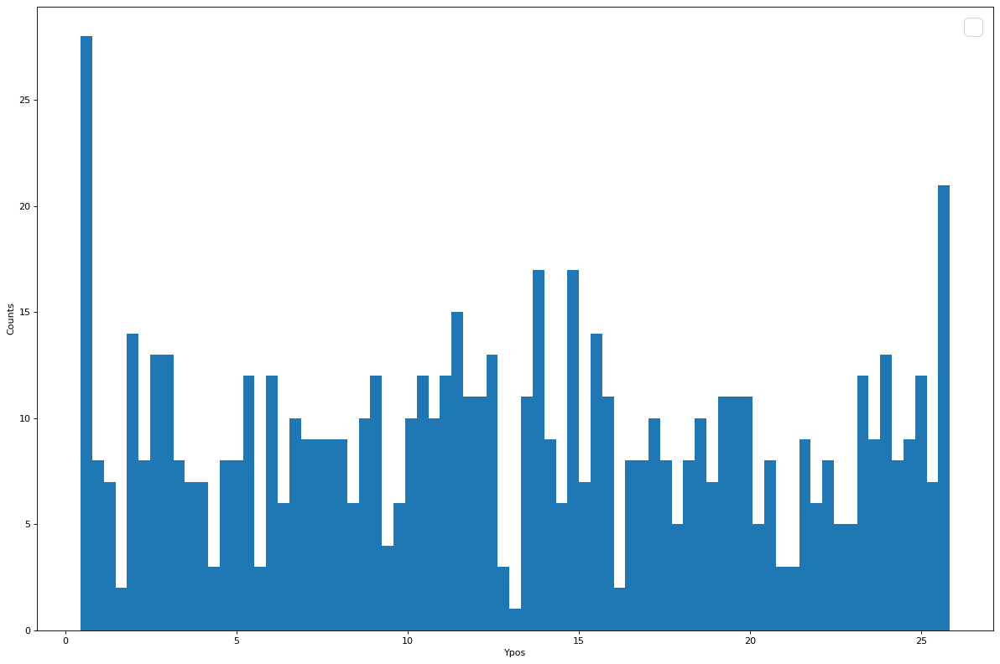

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


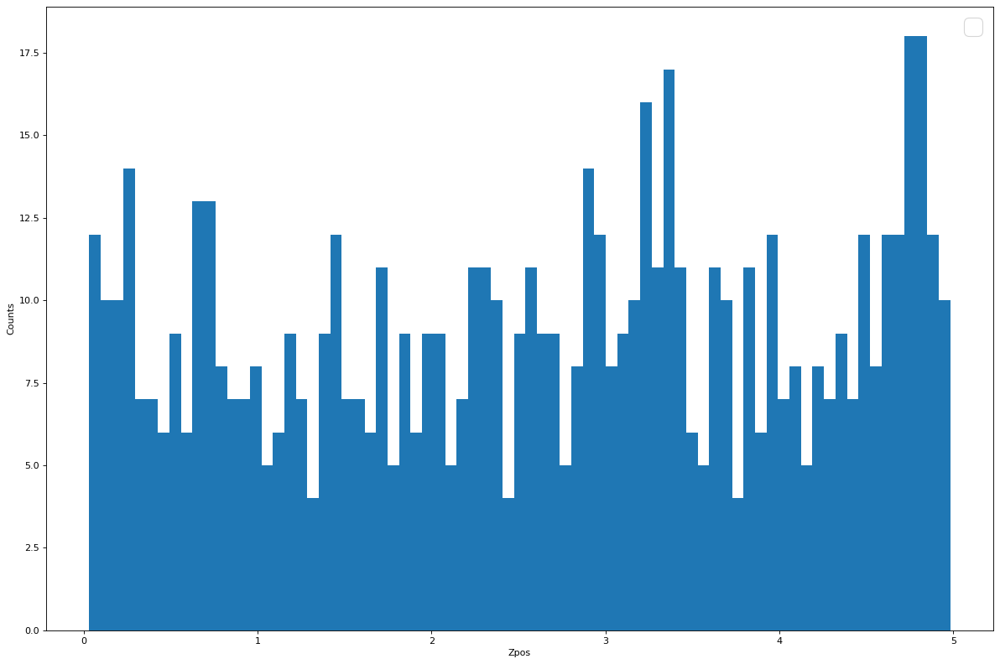

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


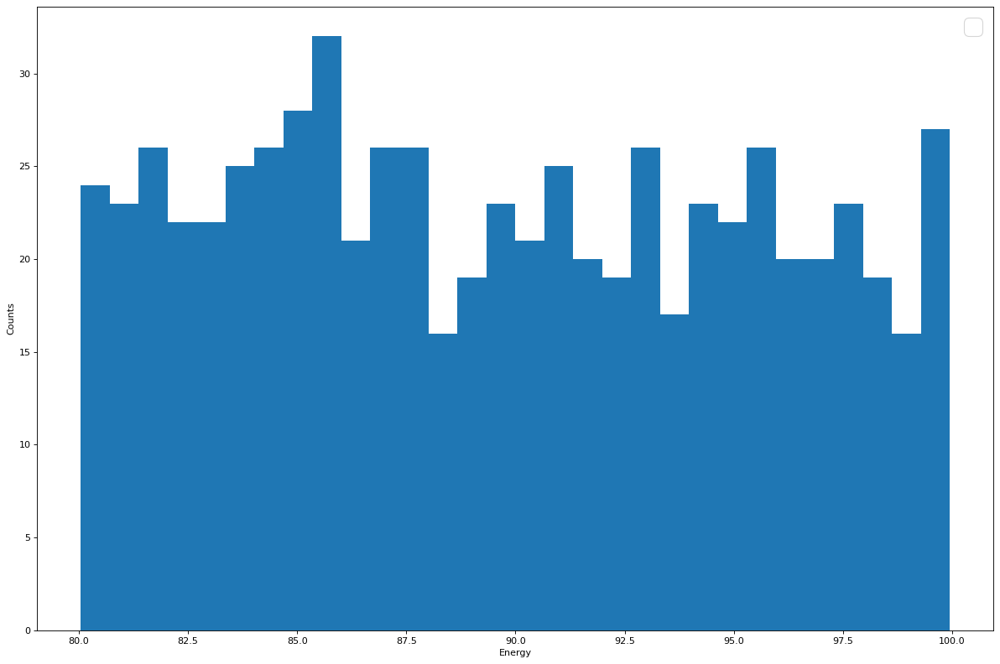

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


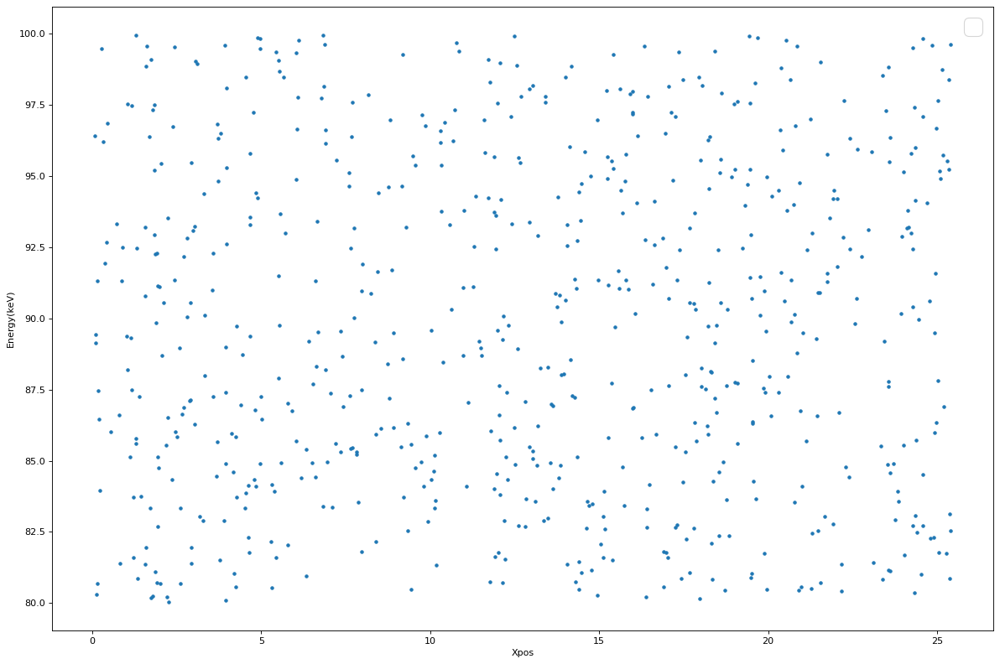

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


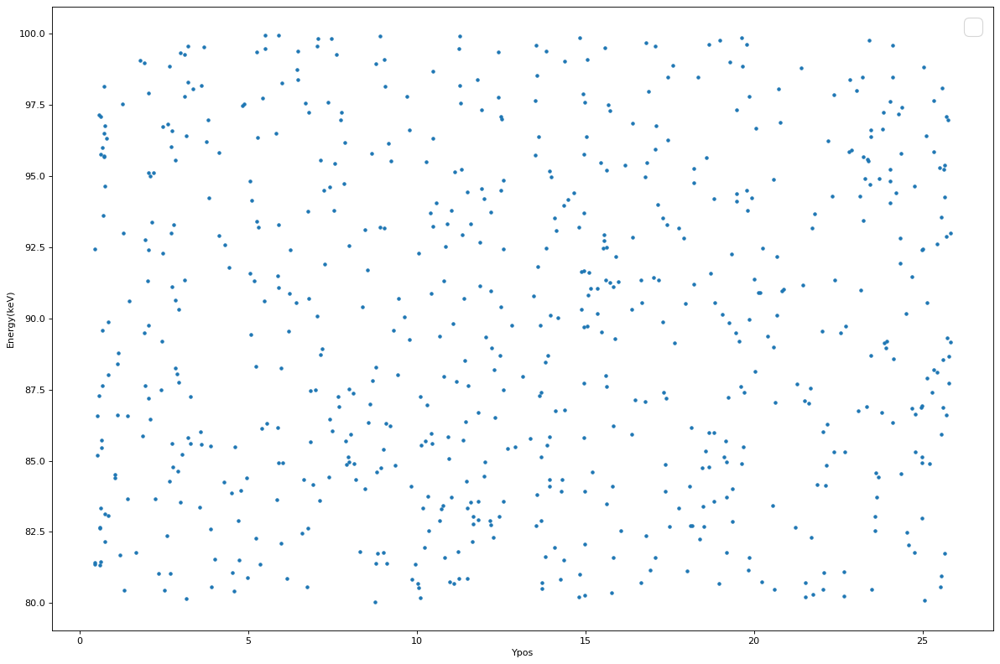

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


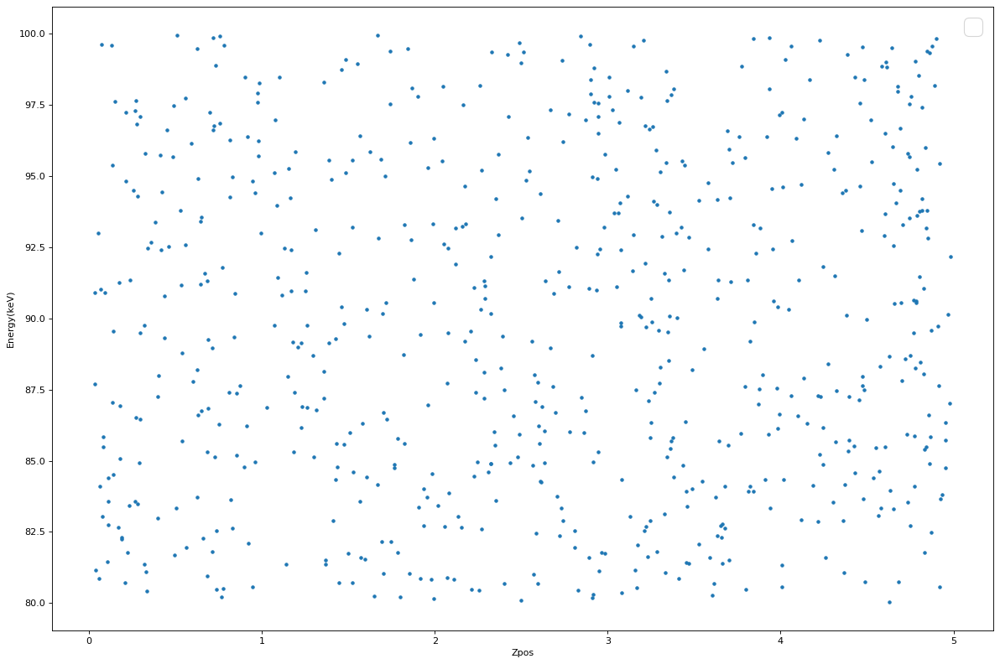

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

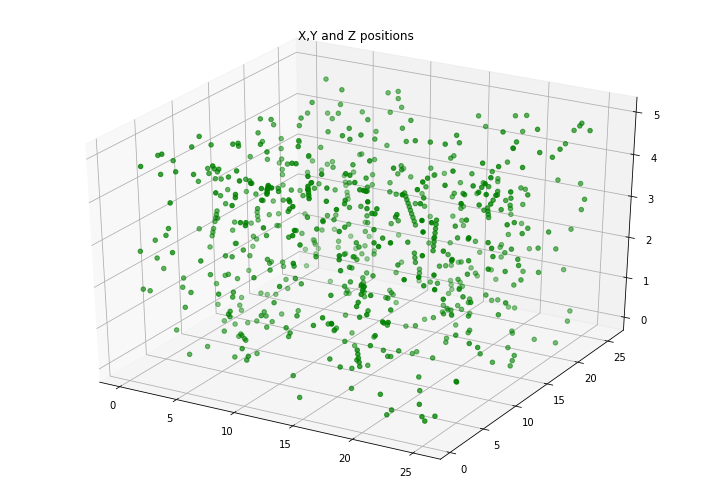

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

<Figure size 720x504 with 0 Axes>

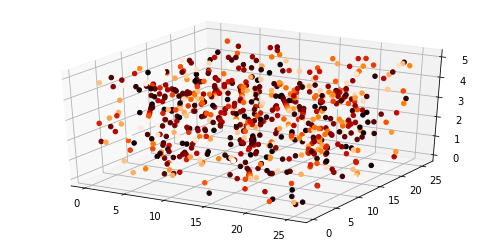

In [ ]:
fig = plt.figure(figsize = (10, 7))

plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 80-150

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >80 and mean_energy_list[i]<150:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


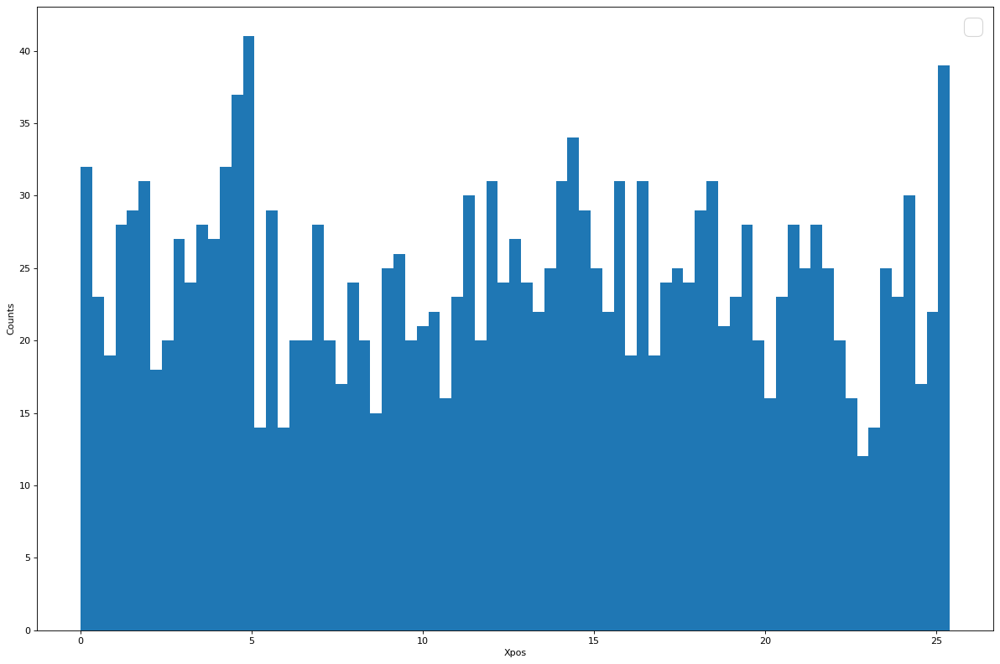

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


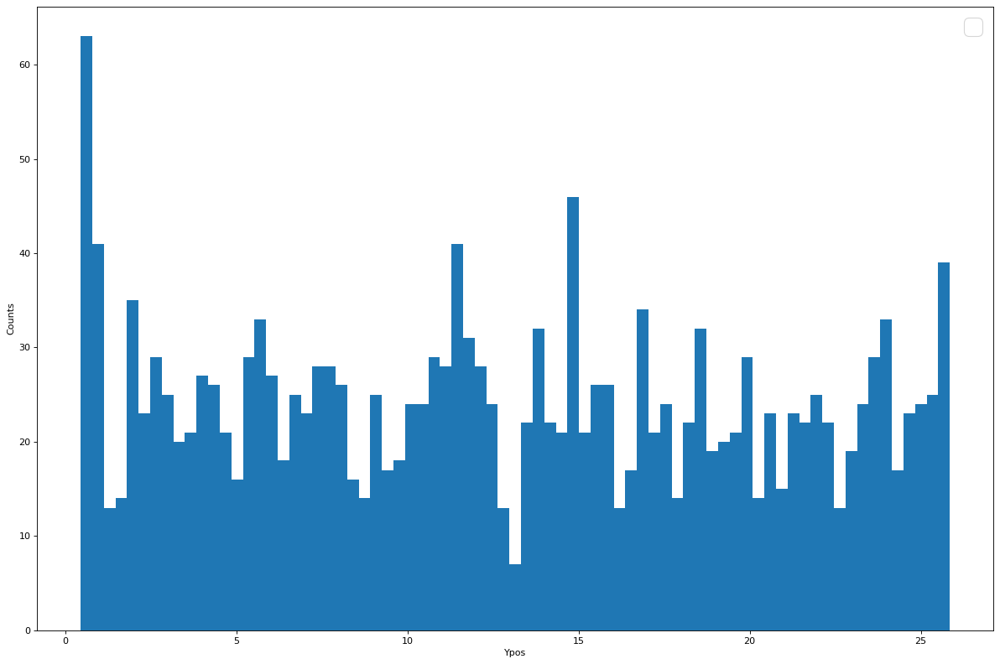

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


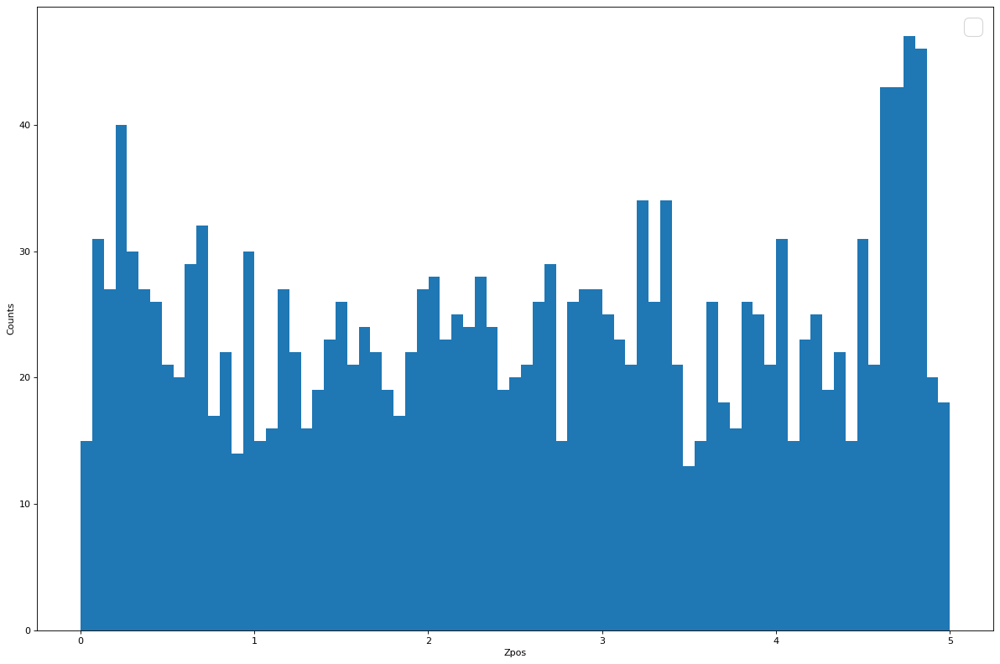

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


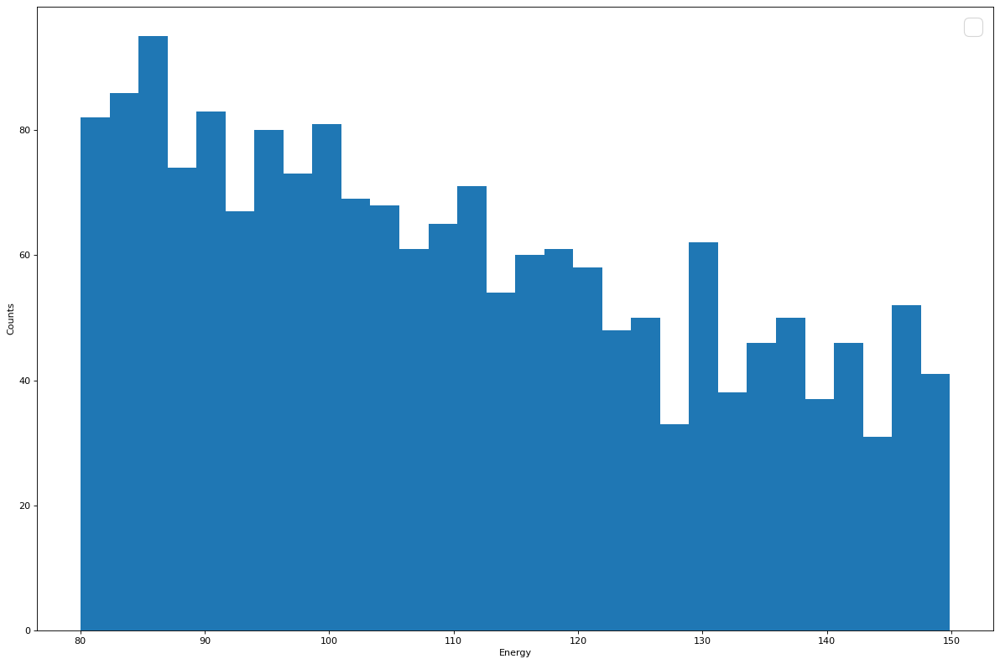

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


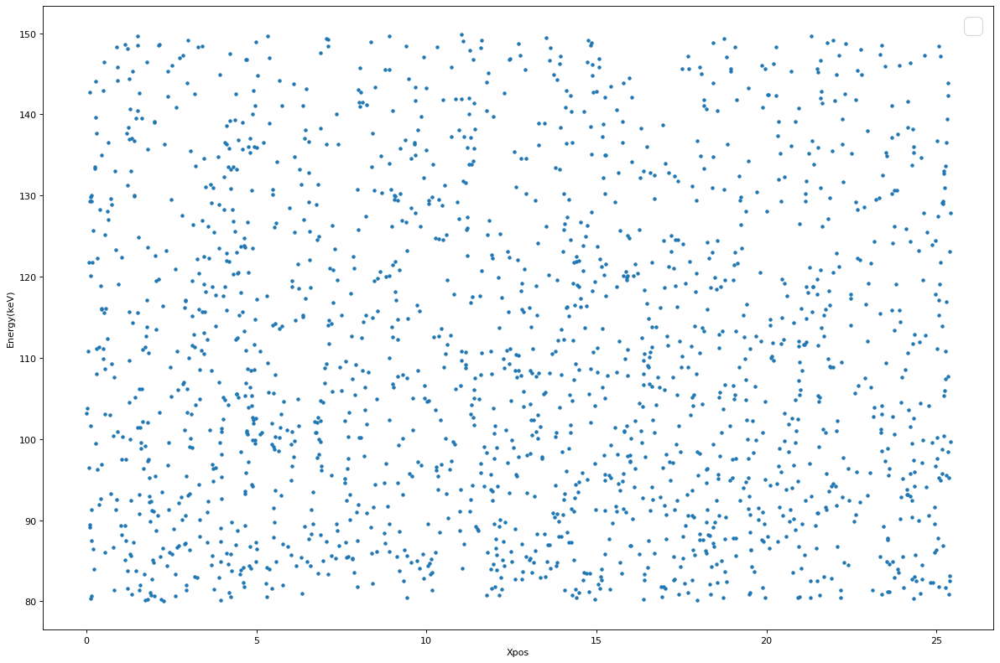

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


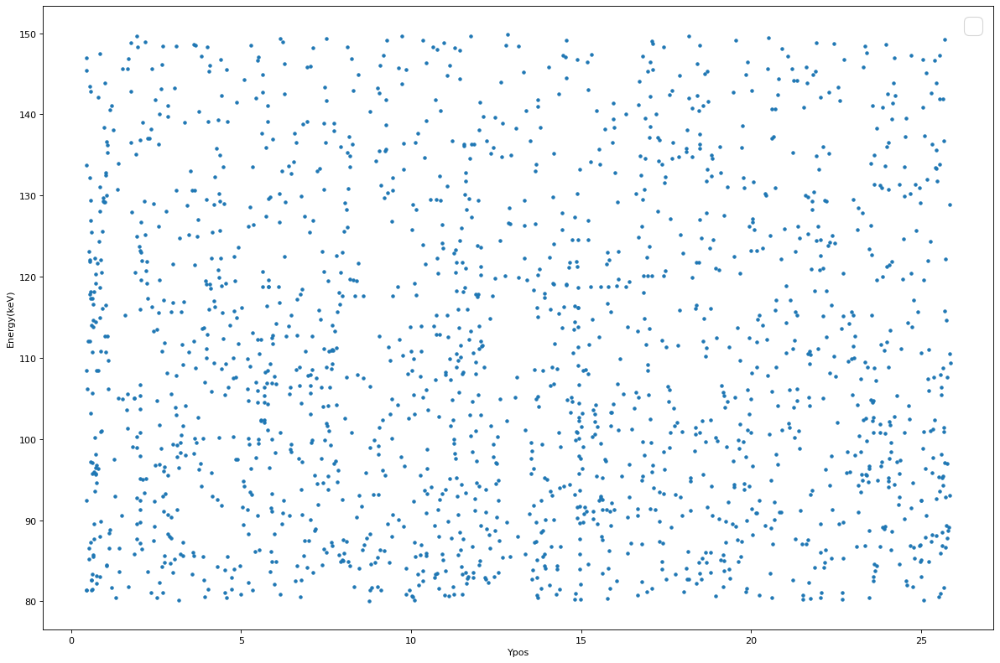

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


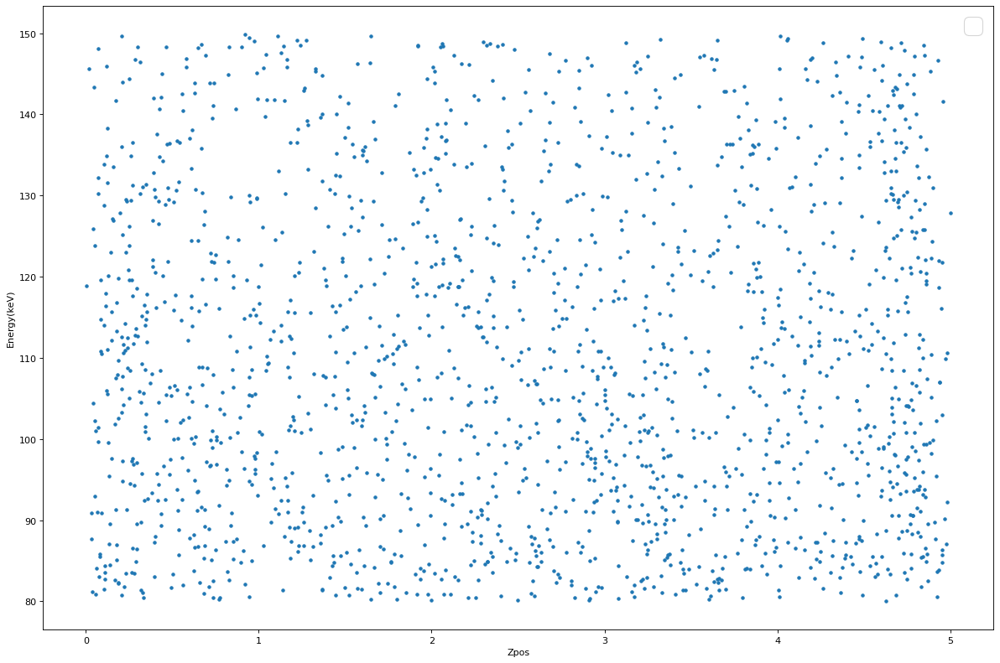

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

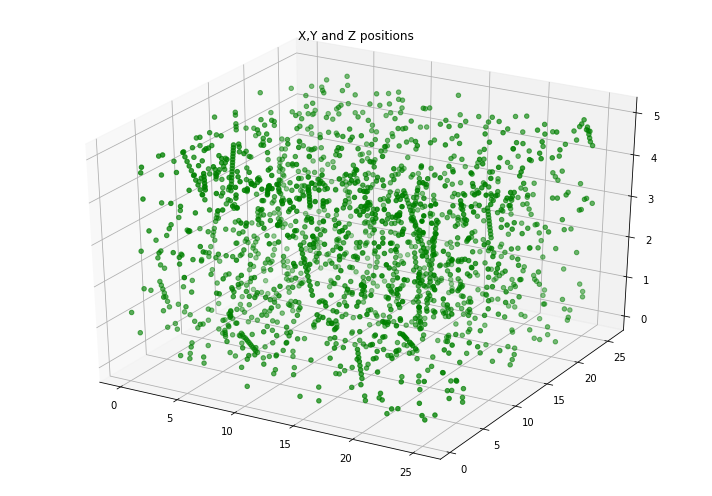

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

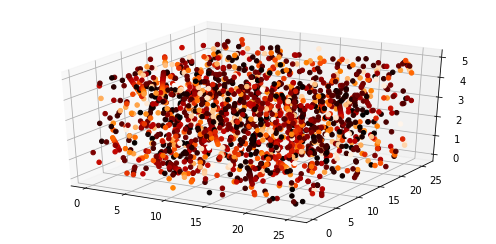

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()

### 150-250

In [ ]:
list_x = []
list_y = []
list_z = []
list_en = []

for i in range(len(mean_energy_list)):
  if mean_energy_list[i] >150 and mean_energy_list[i]<250:
    list_x.append(mean_xpos_list_1[i])
    list_y.append(mean_ypos_list_1[i])
    list_z.append(mean_zpos_list_1[i])
    list_en.append(mean_energy_list_1[i])

No handles with labels found to put in legend.


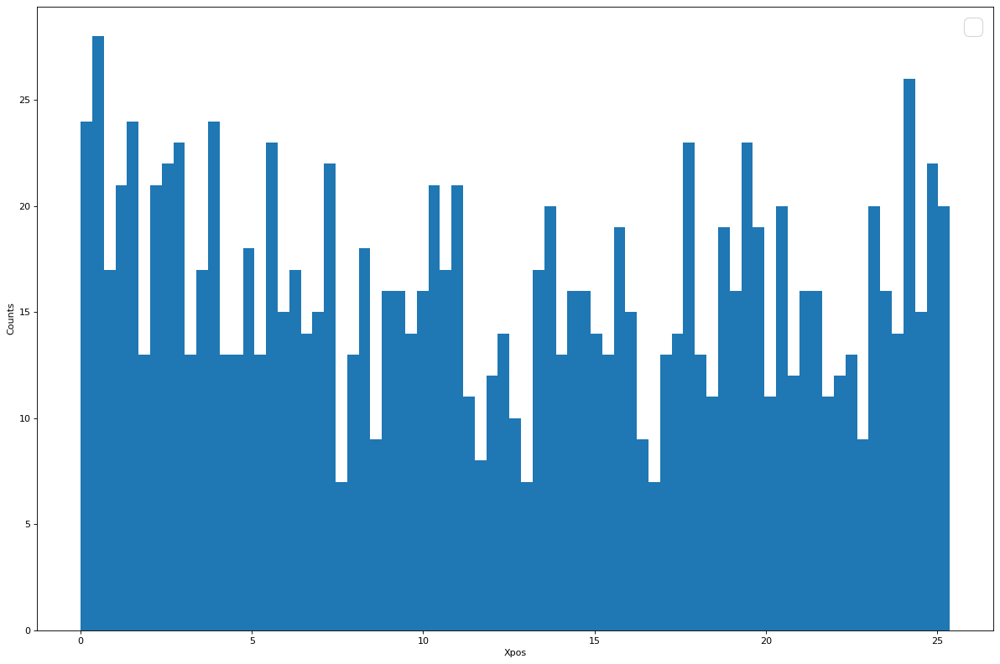

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_x,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Xpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


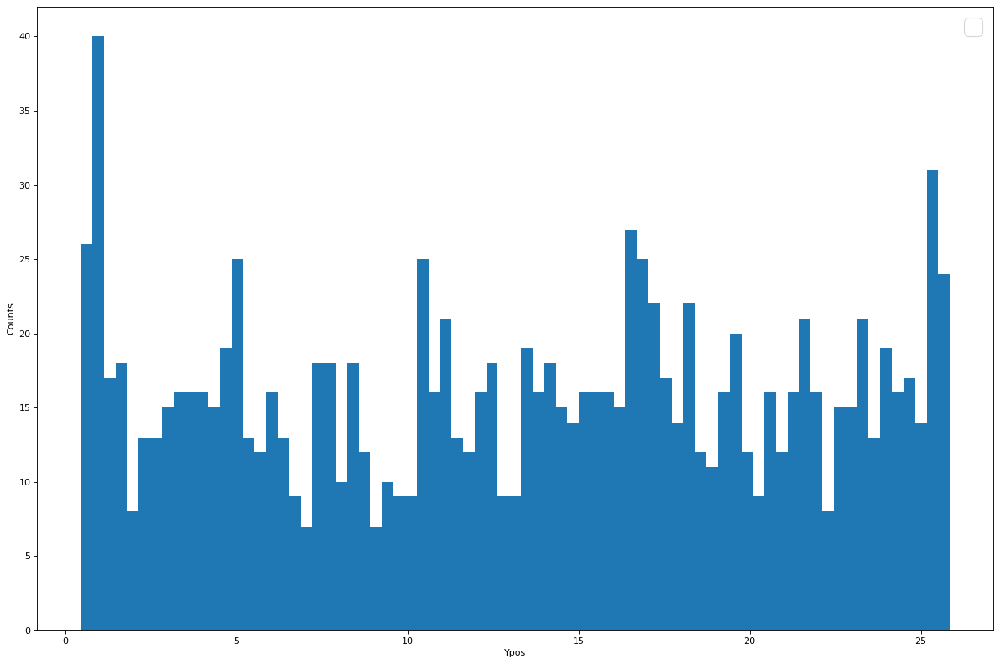

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_y,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Ypos")

plt.legend(prop={"size":font_size})
plt.show()


No handles with labels found to put in legend.


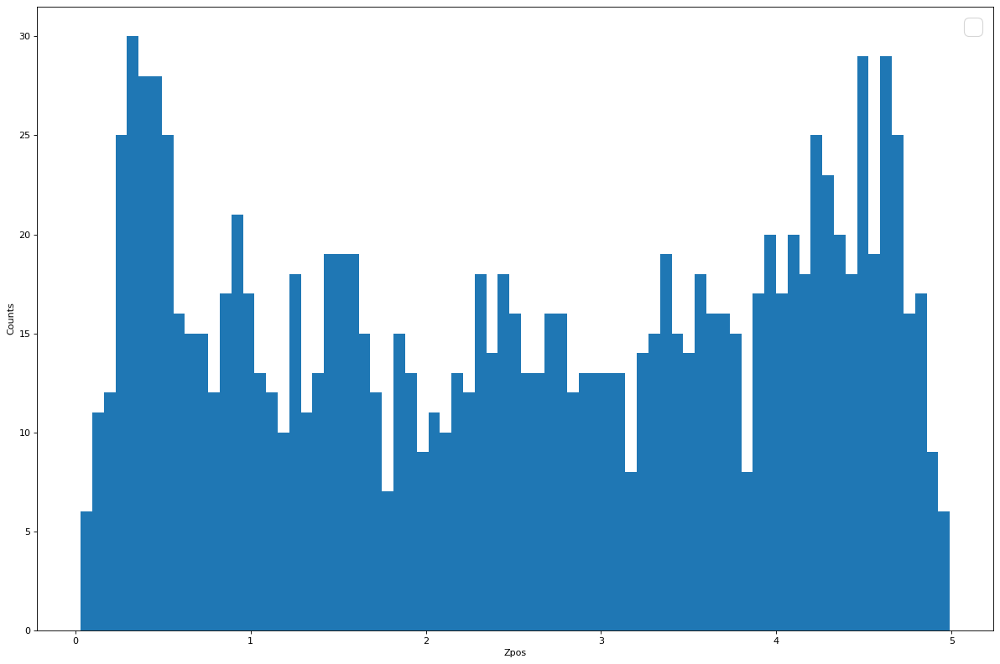

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_z,bins=75,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Zpos")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


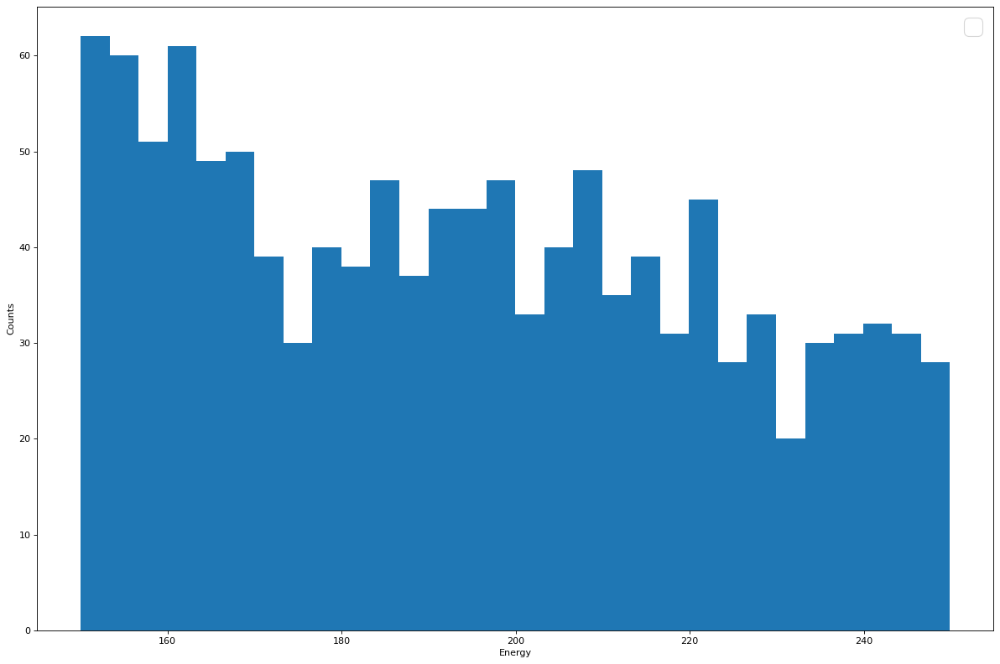

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.hist(list_en,bins=30,histtype="stepfilled")

plt.ylabel("Counts")
plt.xlabel("Energy")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


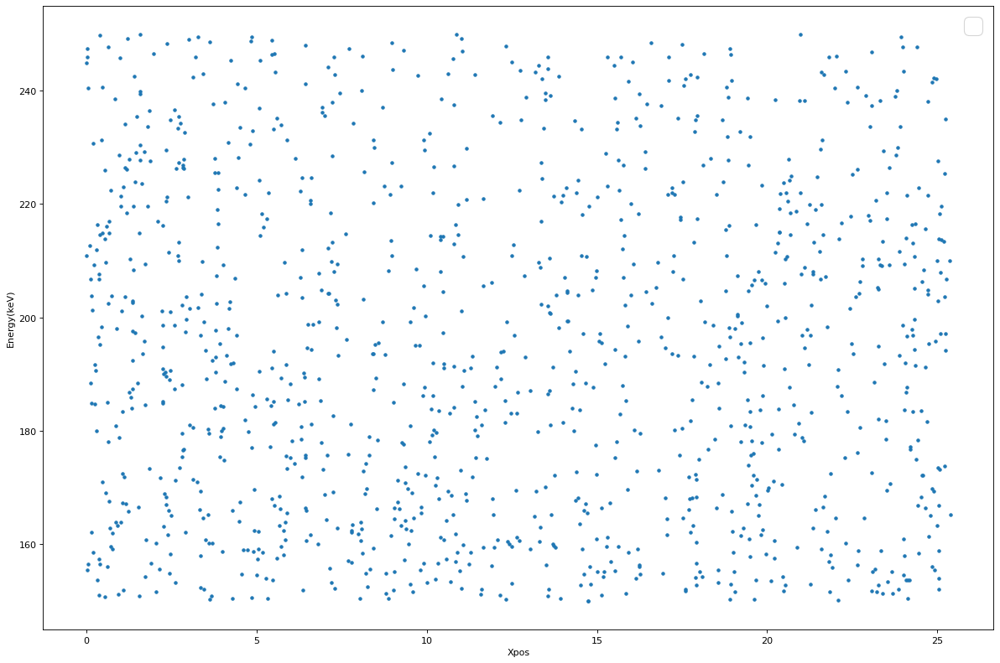

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_x, list_en,marker=".")

plt.xlabel("Xpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


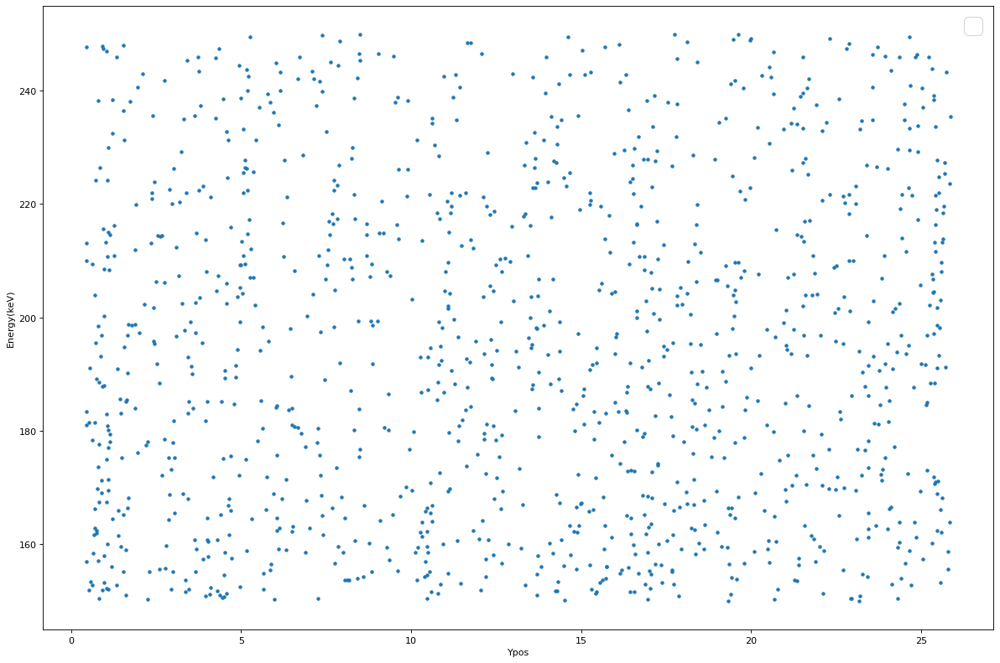

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_y, list_en,marker=".")

plt.xlabel("Ypos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

No handles with labels found to put in legend.


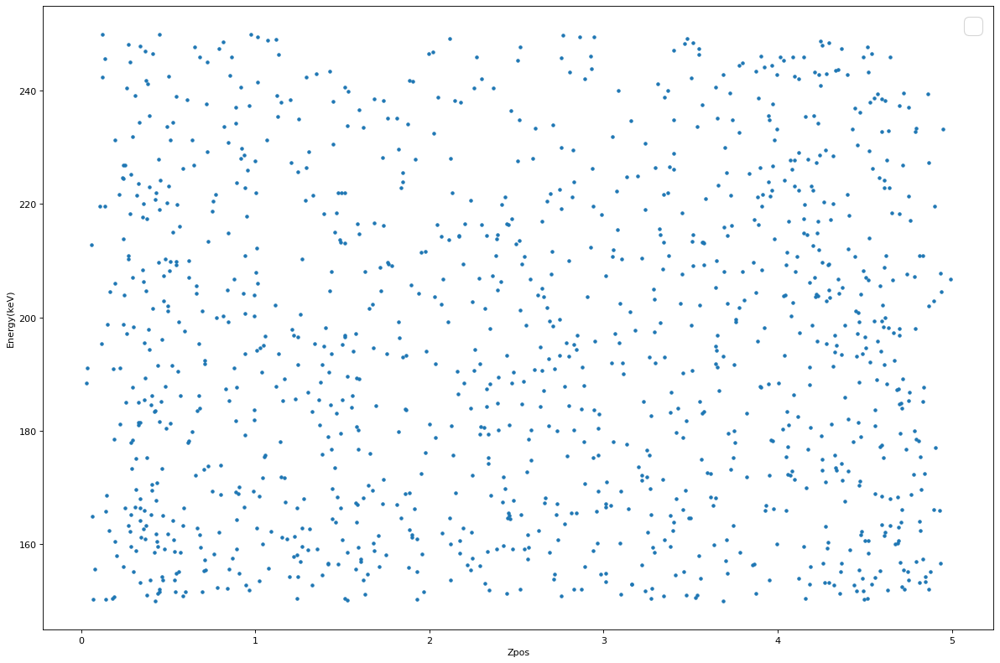

In [ ]:
font_size = 24

plt.figure(num=None, figsize=(15, 10), dpi=80)

plt.scatter(list_z, list_en,marker=".")

plt.xlabel("Zpos")
plt.ylabel("Energy(keV)")

plt.legend(prop={"size":font_size})
plt.show()

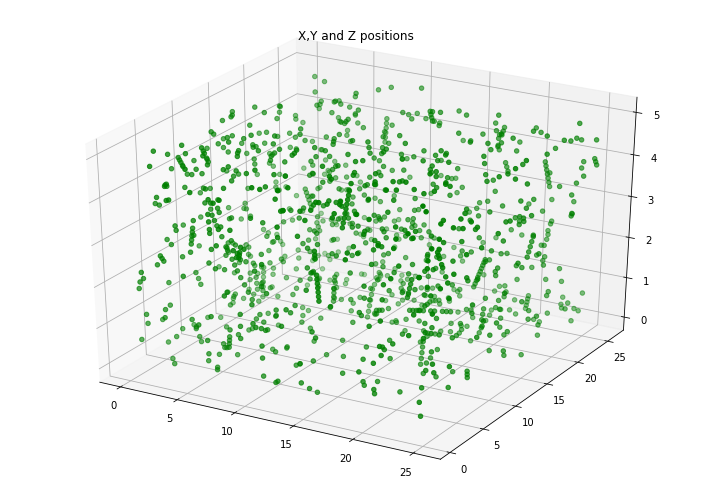

In [ ]:
  fig = plt.figure(figsize = (10, 7))
  ax = plt.axes(projection ="3d")

  ax.scatter3D(list_x, list_y, list_z, color = "green")
  plt.title("X,Y and Z positions")
  

  plt.show()

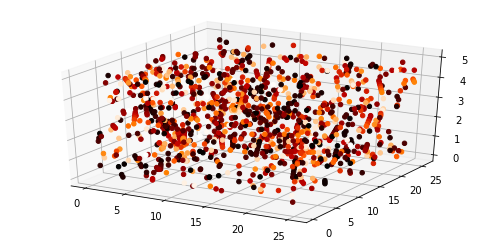

In [ ]:
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


img = ax.scatter(list_x, list_y, list_z, c=list_en, cmap='gist_heat', alpha=1)
plt.show()